# Homework 6
## Collin Dabbieri

In [939]:
import os
import numpy as np
from astropy.io import fits
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import rcParams
plt.rcParams["figure.figsize"] = (15,8)
import imexam
import sys
sys.path.append('/Users/dabbiecm/Documents/ccd-reduction-and-photometry-guide/notebooks/')
from convenience_functions import show_image
from overscan_subtraction import overscan_subtraction
import sfdmap
from astropy.coordinates import SkyCoord


##################### USER DEFINED VALUES ##################################################
data_dir='/Users/dabbiecm/Imaging/'
image_rows=2048
image_columns=2200
image_columns_trim=2046

inner_annulus=15 # radius in pixels of inner annulus
outer_annulus=20 # radius in pixels of outer annulus

left_overscan=[0,54]       # columns of overscan region on left side (indexed from 0) (last column not included)
right_overscan=[2100,2199] # columns of overscan region on right side (indexed from 0) (last column not included)
trimsec=[54,2100]          # columns of image (last column not included, for pythonic array indexing)

overscan_combine='mean'
fit_type='polynomial'
fit_deg=4

1. Using imexam, measure the PSF FWHM of one of the stars in the PG1633+099 Landolt standard field. Are there significant trends or variations in the FWHM for the same star observed at different times throughout the night? How about for different stars observed at similar times but different airmasses? How about across the chip in a single exposure? Make plots to support your findings regarding the variation of the PSF with time/airmass/chip location.

### Same star observed at different times throughout the night

In [476]:
# a81-a92 a202-a211 a237-a246
temp1=np.arange(81,93)
temp2=np.arange(202,212)
temp3=np.arange(237,246)
pg1633_numbers=np.append(temp1,temp2)
pg1633_numbers=np.append(pg1633_numbers,temp3)
PG1633_names=[data_dir+'a'+str(i).zfill(3)+'.fits' for i in pg1633_numbers]
print(PG1633_names[:3])

num_images=len(PG1633_names)
images=np.zeros(shape=(num_images,image_rows,image_columns_trim))

for i in range(num_images):
    data=fits.open(PG1633_names[i])[0].data
    data_ot,AIC=overscan_subtraction(data,right_overscan,trimsec,overscan_combine,fit_type,fit_deg)
    images[i,:,:]=data_ot
    



['/Users/dabbiecm/Imaging/a081.fits', '/Users/dabbiecm/Imaging/a082.fits', '/Users/dabbiecm/Imaging/a083.fits']


In [30]:
os.system('/Applications/SAOImageDS9.app/Contents/MacOS/ds9 -title ds9_1 &')
os.environ['XPA_METHOD'] = "inet"

In [31]:
# connect the imexam viewer to that window
viewer=imexam.connect('ds9_1')

In [32]:
# load an image and zscale
viewer.load_fits(data_dir+'a202.fits')
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/dabbiecm/Imaging/a202.fits
xc=510.3138	yc=587.3895
Background per pixel: 716.5399683808638
Max. pix. flux = 33218.460
amp = 40801.457
fwhm =     4.365


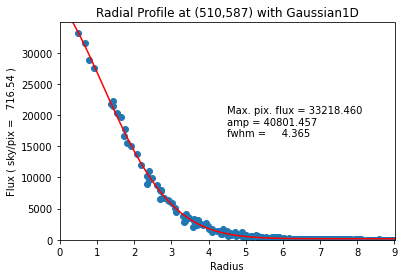

In [33]:
viewer.imexam()
# when you execute this cell, open ds9, find a point source, and press 'r' to create a radial brightness curve
# Returns a weird error on quitting (oh well)

In [34]:
os.system('/Applications/SAOImageDS9.app/Contents/MacOS/ds9 -title ds9_1 &')
os.environ['XPA_METHOD'] = "inet"

In [35]:
viewer=imexam.connect('ds9_1')

In [36]:
# load an image and zscale
viewer.load_fits(data_dir+'a237.fits')
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/dabbiecm/Imaging/a237.fits
xc=422.7017	yc=589.0328
Background per pixel: 738.5686695606569
Max. pix. flux =  9305.431
amp =  8951.526
fwhm =     5.497


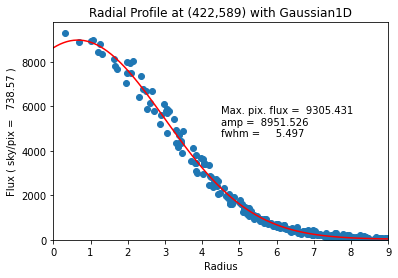

In [37]:
viewer.imexam()

### Different stars observed at similar times but different airmasses

In [38]:
os.system('/Applications/SAOImageDS9.app/Contents/MacOS/ds9 -title ds9_1 &')
os.environ['XPA_METHOD'] = "inet"

In [39]:
viewer=imexam.connect('ds9_1')

In [40]:
# load an image and zscale
viewer.load_fits(data_dir+'a211.fits') # X=1.53
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/dabbiecm/Imaging/a211.fits
xc=1239.4853	yc=1210.6528
Background per pixel: 1057.5820256853947
Max. pix. flux = 64477.418
amp = 64823.810
fwhm =     2.332


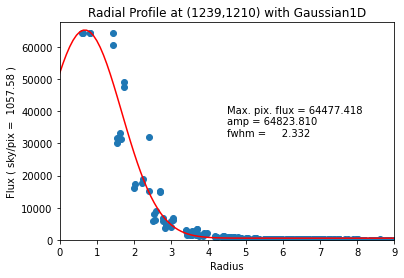

In [41]:
viewer.imexam()

In [42]:
os.system('/Applications/SAOImageDS9.app/Contents/MacOS/ds9 -title ds9_1 &')
os.environ['XPA_METHOD'] = "inet"

In [43]:
viewer=imexam.connect('ds9_1')

In [44]:
# load an image and zscale
viewer.load_fits(data_dir+'a237.fits') # X=2.15
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/dabbiecm/Imaging/a237.fits
xc=1264.8194	yc=1219.2498
Background per pixel: 726.1665824501214
Max. pix. flux =   626.833
amp =   592.430
fwhm =     5.108


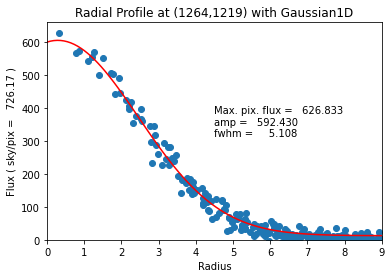

In [45]:
viewer.imexam()

### Across the chip in a single exposure

In [46]:
os.system('/Applications/SAOImageDS9.app/Contents/MacOS/ds9 -title ds9_1 &')
os.environ['XPA_METHOD'] = "inet"

In [47]:
viewer=imexam.connect('ds9_1')

In [48]:
# load an image and zscale
viewer.load_fits(data_dir+'a237.fits') # X=2.15
viewer.scale()


Press 'q' to quit

2 Make the next plot in a new window
a Aperture sum, with radius region_size 
b Return the 2D gauss fit center of the object
c Return column plot
d Return the Center of Mass fit center of the object
e Return a contour plot in a region around the cursor
g Return curve of growth plot
h Return a histogram in the region around the cursor
j 1D [Gaussian1D default] line fit 
k 1D [Gaussian1D default] column fit
l Return line plot
m Square region stats, in [region_size],default is median
r Return the radial profile plot
s Save current figure to disk as [plot_name]
t Make a fits image cutout using pointer location
w Display a surface plot around the cursor location
x Return x,y,value of pixel
y Return x,y,value of pixel
Current image /Users/dabbiecm/Imaging/a237.fits
xc=394.5152	yc=1458.9488
Background per pixel: 726.905459930132
Max. pix. flux =  3361.095
amp =  3241.835
fwhm =     5.340


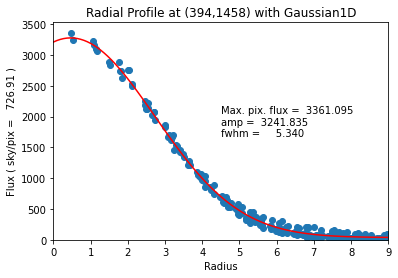

xc=1820.9275	yc=262.2163
Background per pixel: 722.0387673909023
Max. pix. flux =  2804.961
amp =  2785.009
fwhm =     5.121


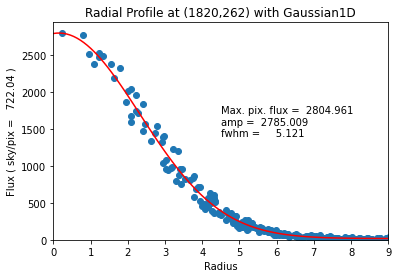

In [49]:
viewer.imexam()

## The PSF FWHM of these stars seems to change across time, airmass and chip location

2. CCDs are ideal because over the available dynamic range, they are very linear (that is, one photon produces one electron). Test the linearity of the CCD using the sequence of exposures labeled linearity test in the log. Make a plot of ADU versus time and determine whether the chip is linear to the full 16 bits of the A-D converter. What you care about here is whether the signal stays linear with exposure time as the flux in the peak pixel approaches the 216 ADU limit.

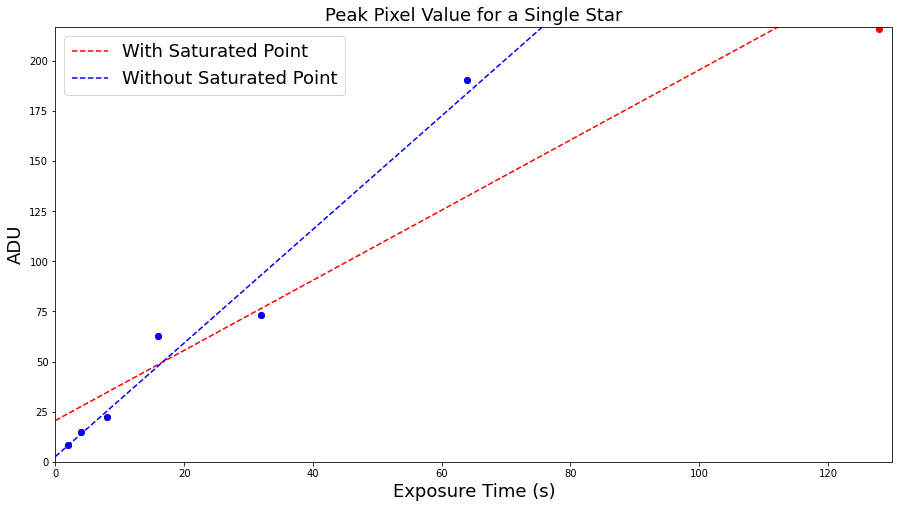

In [73]:
# 65535 is upper limit in ds9
# ideally, you would pick a star that is close to saturated in 128s exposure but not quite
# This is hard as most every star is saturated in 128s exposure
# Final point for this star is saturated
exposure_times=[2,4,8,16,32,64,128]
peak_pixels=np.asarray([2602,4477,6789,19095,22290,57765,65535])*(216/65535)

exposure_times_nosat=[2,4,8,16,32,64]
peak_pixels_nosat=np.asarray([2602,4477,6789,19095,22290,57765])*(216/65535)

# best-fit straight line
x=np.arange(0,128)
m, b = np.polyfit(exposure_times,peak_pixels,1)
y=m*x+b

m, b = np.polyfit(exposure_times_nosat,peak_pixels_nosat,1)
y_nosat=m*x+b

plt.scatter(exposure_times,peak_pixels,c='r')
plt.plot(x,y,ls='--',c='r',label='With Saturated Point')

plt.scatter(exposure_times_nosat,peak_pixels_nosat,c='b')
plt.plot(x,y_nosat,ls='--',c='b',label='Without Saturated Point')

plt.axis([0,130,0,217])

plt.ylabel('ADU',fontsize=18)
plt.xlabel('Exposure Time (s)',fontsize=18)
plt.title('Peak Pixel Value for a Single Star',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

3. Use photutils to perform aperture photometry on three (non saturated) stars in the PG1633+099 standard field: a really faint one, a medium bright one, and a bright one. Perform aperture photometry using at least 5 aperture sizes from very small to very large and make a plot that reproduces the one from Howell Figure 5.7 showing S/N as a function of aperture radius. What is a good aperture size to use for this dataset?

In [248]:
def get_distance(loc1,loc2):
    x1=loc1[0]
    y1=loc1[1]
    x2=loc2[0]
    y2=loc2[1]
    
    return np.sqrt((y2-y1)**2+(x2-x1)**2)

def get_aperture_pixels(center,radius):
    '''
    returns a list of lists with the [row, column] of the pixels in a desired aperture
    
    params:
        center - list of length two, [row,column] of center pixel
        radius - int, radius of aperture in pixels
    '''
    
    aperture_rows=[]
    aperture_columns=[]
    
    #check pixels in a square from [row-radius,column-radius] to [row+radius,column+radius]
    for row in np.arange(center[0]-radius,center[0]+radius+1):
        for column in np.arange(center[1]-radius,center[1]+radius+1):
            
            distance=get_distance([row,column],center)
            
            if distance<radius+1:
                aperture_rows.append(row)
                aperture_columns.append(column)
                
    return aperture_rows,aperture_columns
            
def get_annulus_pixels(center,inner_radius,outer_radius):
    '''
    returns a list of lists with the [row, column] of the pixels in a desired annulus
    
    params:
        center - list of length two, [row,column] of center pixel
        inner_radius - int, radius of inner part of annulus in pixels
        outer_radius - int, radius of outer part of annulus in pixels
    '''
    
    inner_circle_rows,inner_circle_columns=get_aperture_pixels(center,inner_radius)
    outer_circle_rows,outer_circle_columns=get_aperture_pixels(center,outer_radius)
    
    inner_circle_pixels=[[inner_circle_rows[i],inner_circle_columns[i]] for i in range(len(inner_circle_rows))]
    
    
    annulus_rows=[]
    annulus_columns=[]
    for i in range(len(outer_circle_rows)):
        
        pixel=[outer_circle_rows[i],outer_circle_columns[i]]
        
        if pixel not in inner_circle_pixels:
            annulus_rows.append(pixel[0])
            annulus_columns.append(pixel[1])
            
    return annulus_rows,annulus_columns


def get_SNR(Rst,npix,Rbt):
    '''
    SNR for background limited case, readnoise is 4.5
    '''
    Nr=4.5
    return Rst/(np.sqrt(npix*(Rbt+Nr**2)))

### Really faint

In [482]:
print(PG1633_names[12])

/Users/dabbiecm/Imaging/a202.fits


(874.0, 974.0, 1460.0, 1560.0)

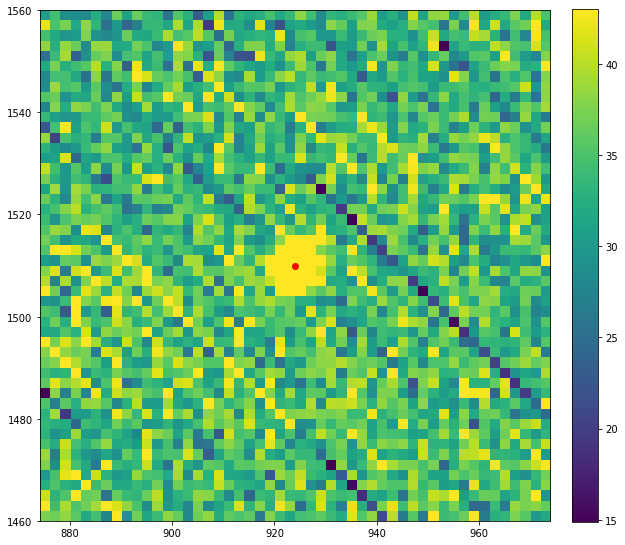

In [483]:
x_ds9=978-54
y_ds9=1510
center=[y_ds9,x_ds9]
show_image(images[12,:,:])
plt.scatter(center[1],center[0],c='r')
plt.axis([center[1]-50,center[1]+50,center[0]-50,center[0]+50])

In [484]:
aperture_sizes=np.arange(1,16) # pixel radius values of aperture

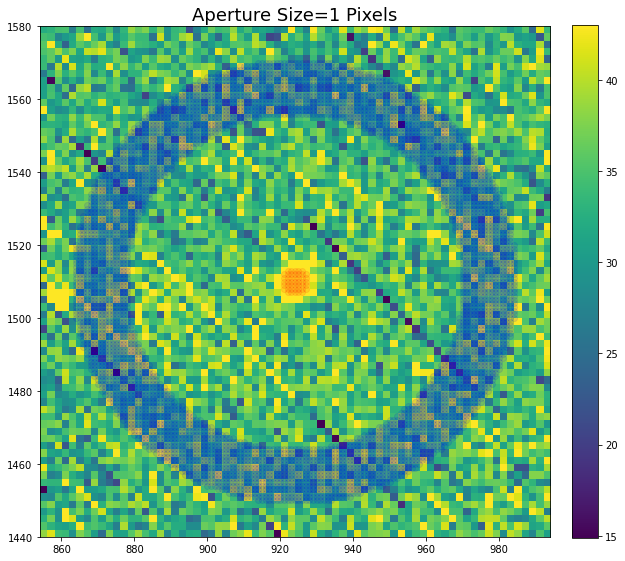

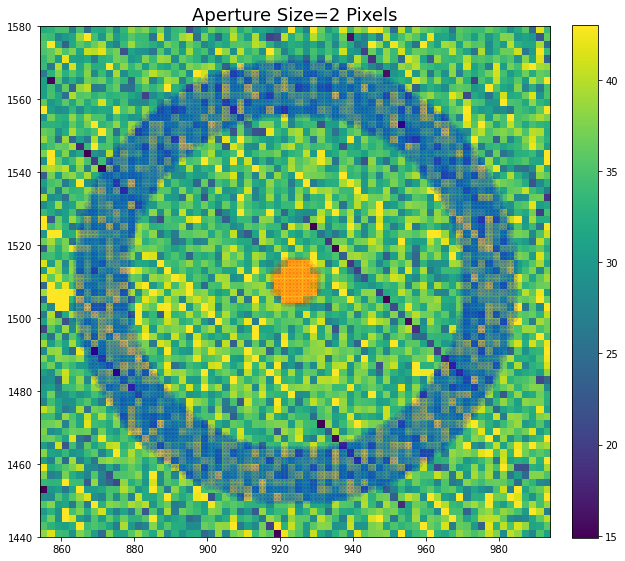

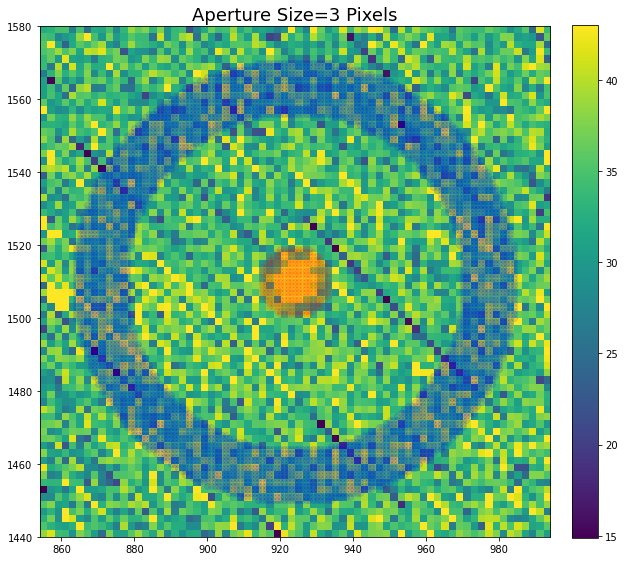

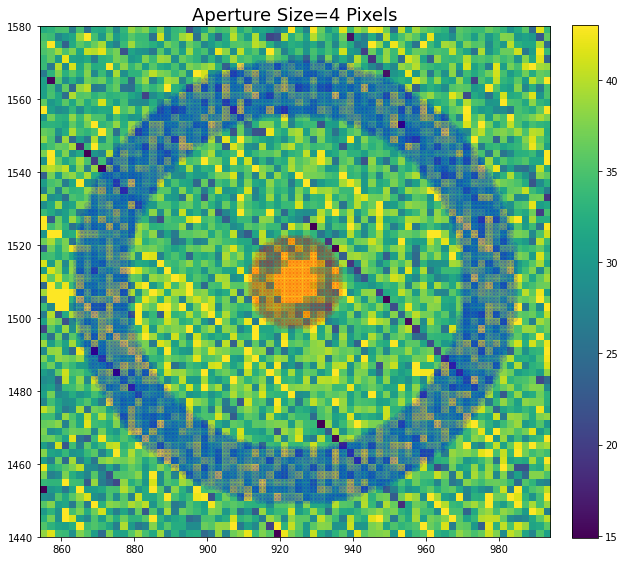

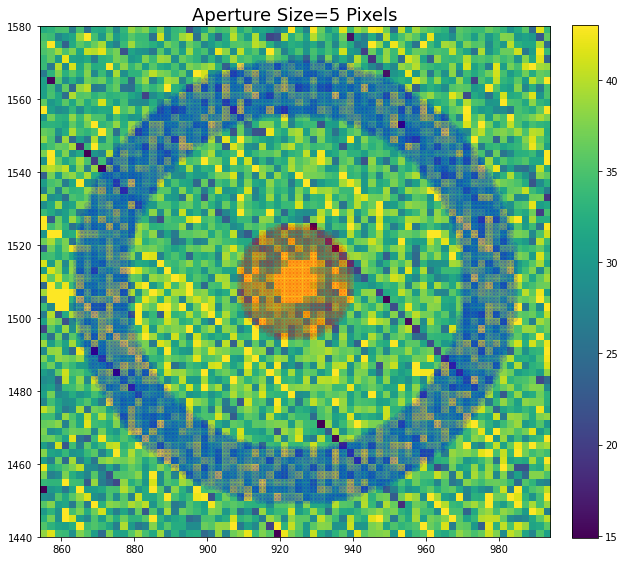

...

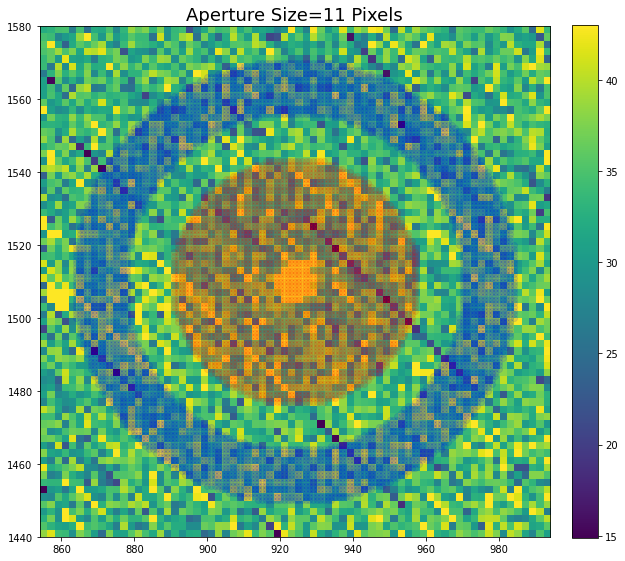

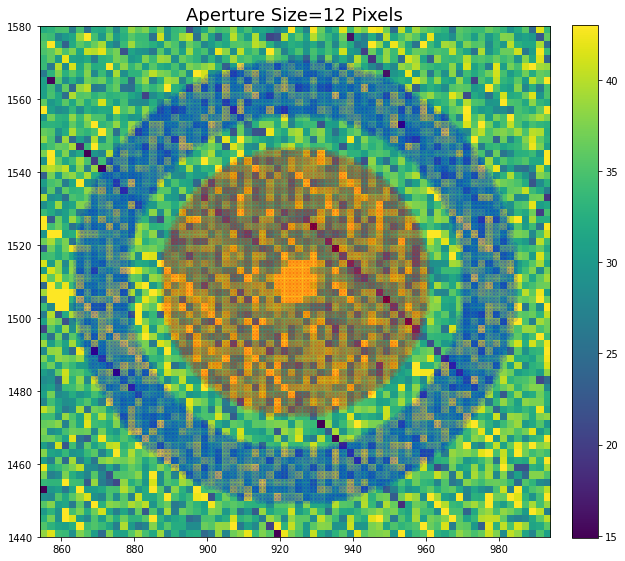

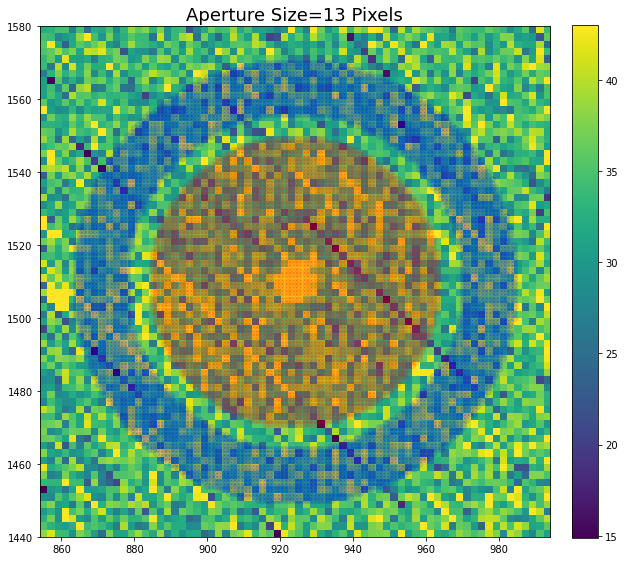

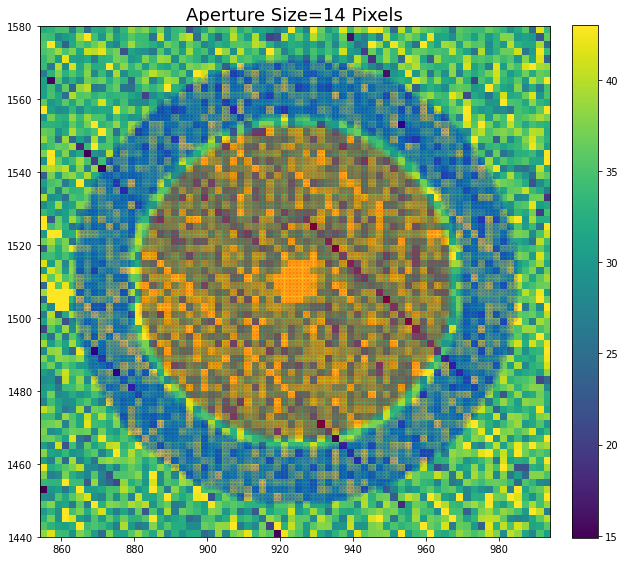

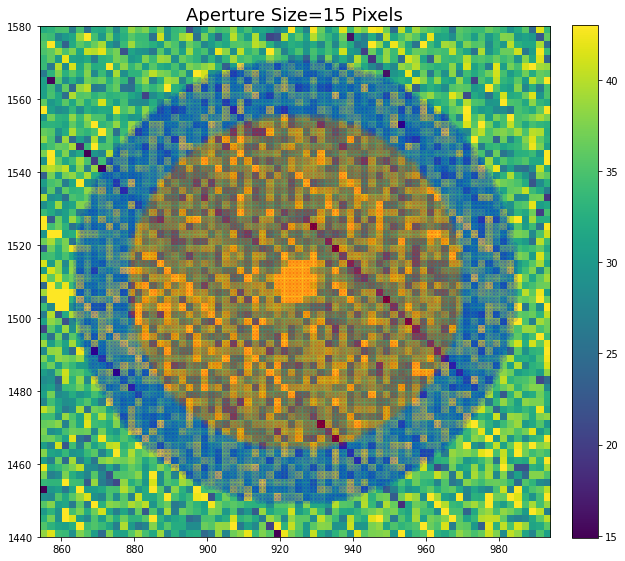

In [485]:
scaling=3 # number of image pixels per actual pixel (in a single dimension)

for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    show_image(images[12,:,:])
    plt.scatter(aperture_columns,aperture_rows,c='r',alpha=0.1)
    plt.scatter(annulus_columns,annulus_rows,c='b',alpha=0.1)
    plt.title('Aperture Size={:.0f} Pixels'.format(size),fontsize=18)
    plt.axis([center[1]-70,center[1]+70,center[0]-70,center[0]+70])
    plt.show()

Text(0.5, 1.0, 'Faint Source')

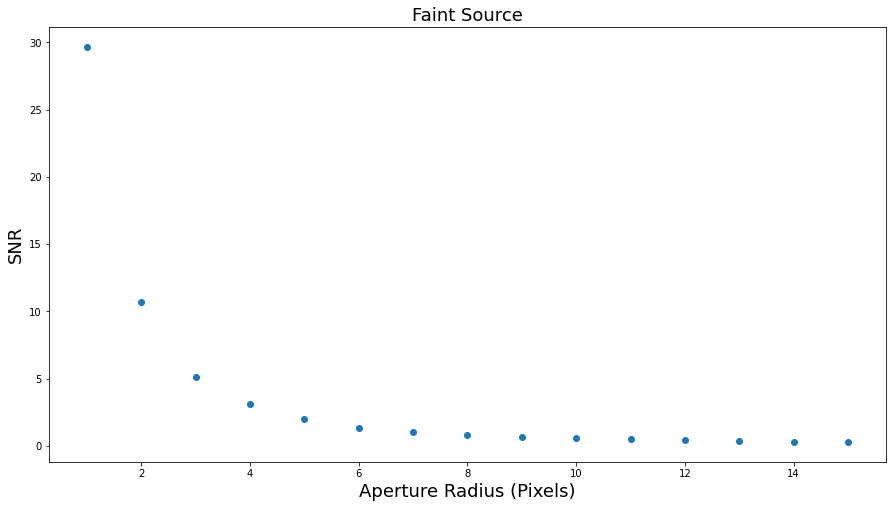

In [486]:
# S/N as a function of aperture size

SNR=[]

for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    annulus_mean=np.mean([images[12,annulus_rows[i],annulus_columns[i]] for i in range(len(annulus_rows))])
    aperture_no_bg=[images[12,aperture_rows[i],aperture_columns[i]] for i in range(len(aperture_rows))] - annulus_mean
    background_counts=annulus_mean*len(aperture_rows)
    
    Rst=np.sum(aperture_no_bg)
    Rbt=background_counts
    npix=len(aperture_rows)
    
    SNR.append(get_SNR(Rst,npix,Rbt))
    
plt.scatter(aperture_sizes,SNR)
plt.xlabel('Aperture Radius (Pixels)',fontsize=18)
plt.ylabel('SNR',fontsize=18)
plt.title('Faint Source',fontsize=18)
    

### Medium

(358.0, 558.0, 486.0, 686.0)

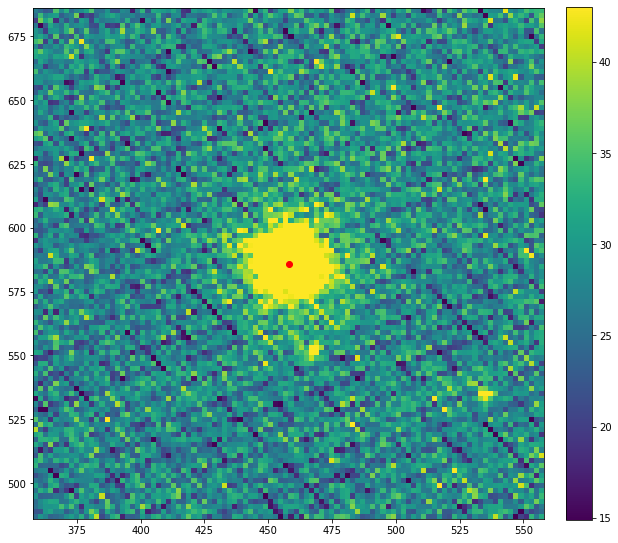

In [497]:
x_ds9=512-54
y_ds9=586
center=[y_ds9,x_ds9]
show_image(images[12,:,:])
plt.scatter(center[1],center[0],c='r')
plt.axis([center[1]-100,center[1]+100,center[0]-100,center[0]+100])

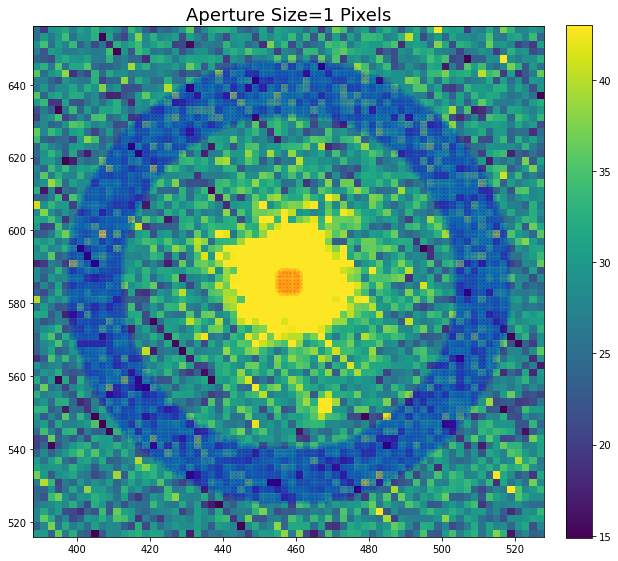

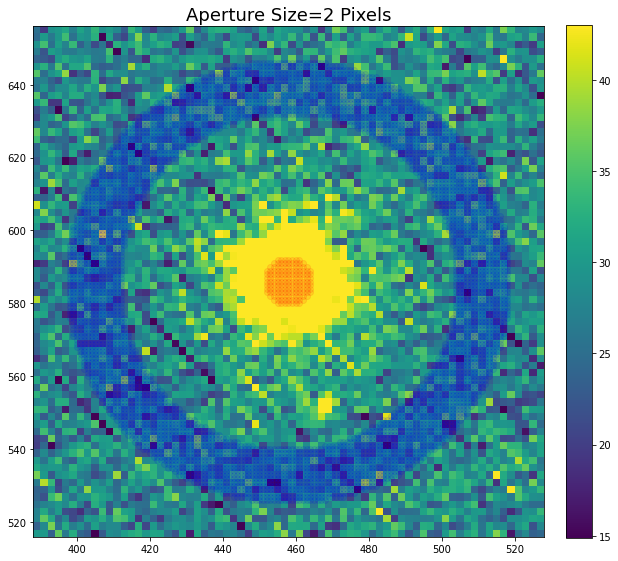

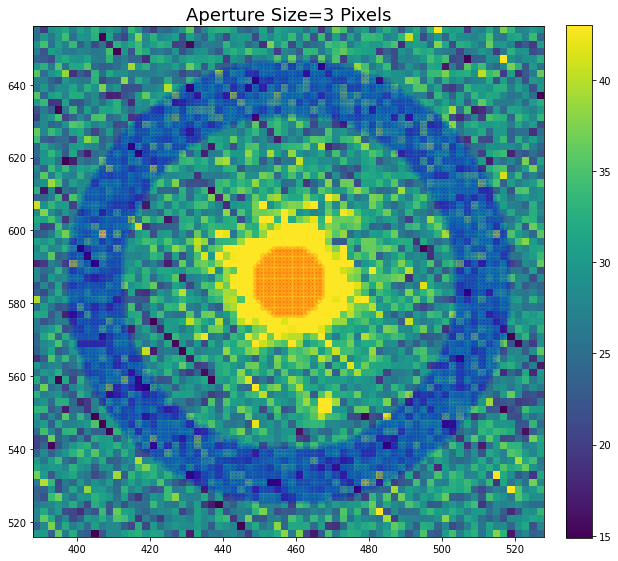

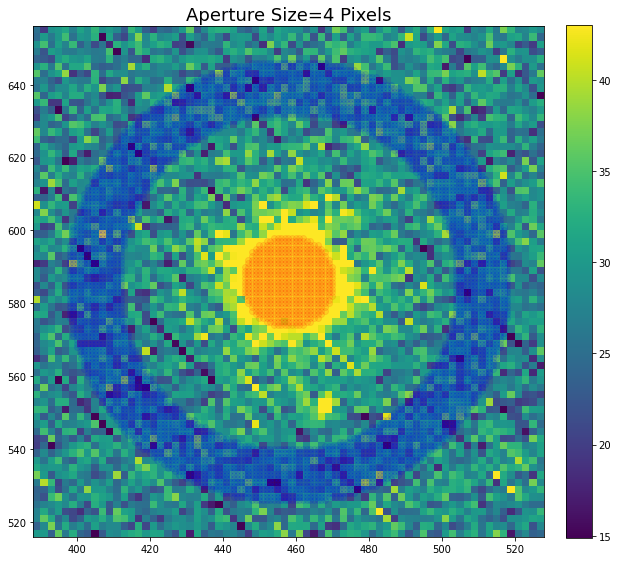

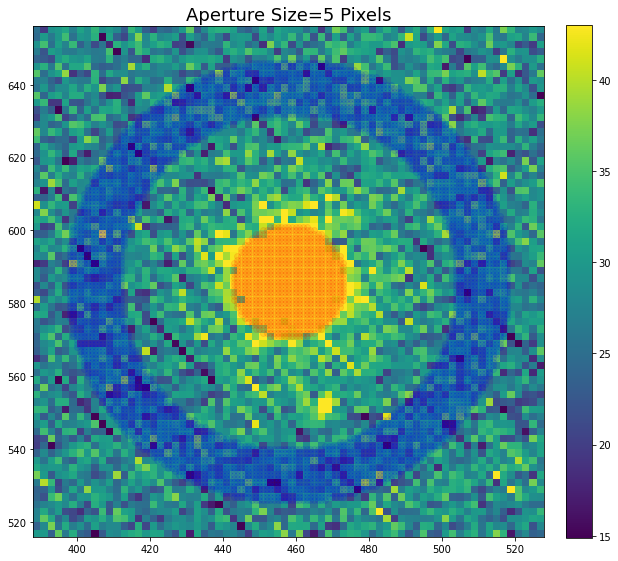

...

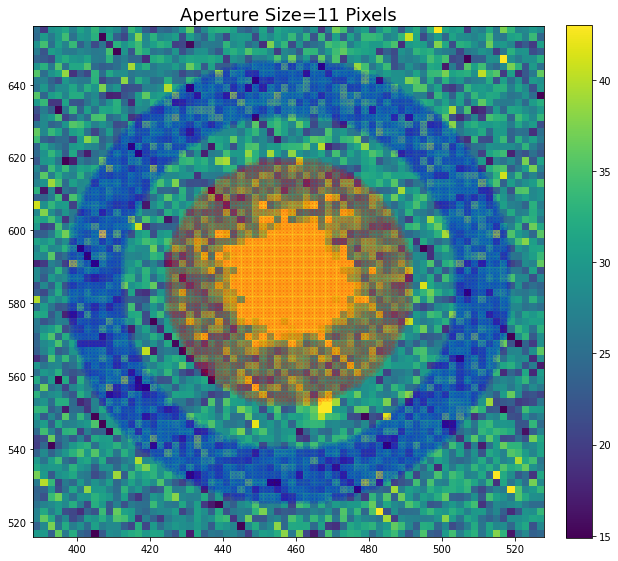

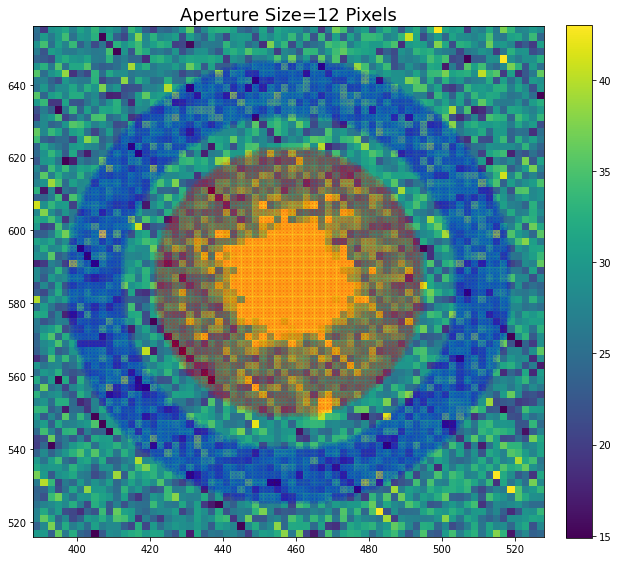

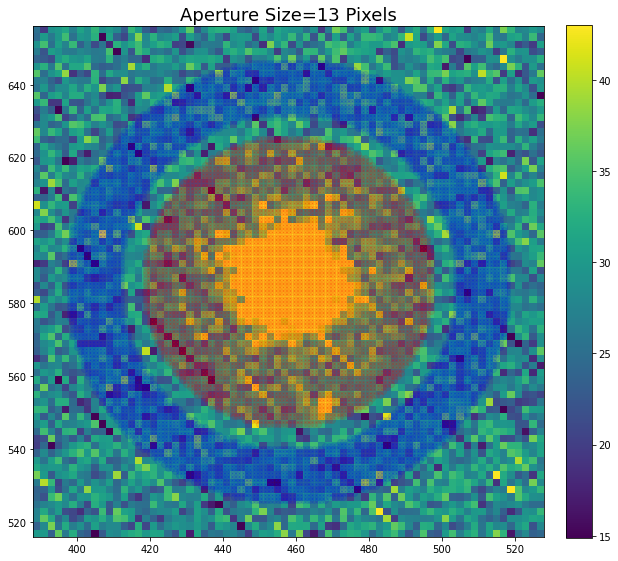

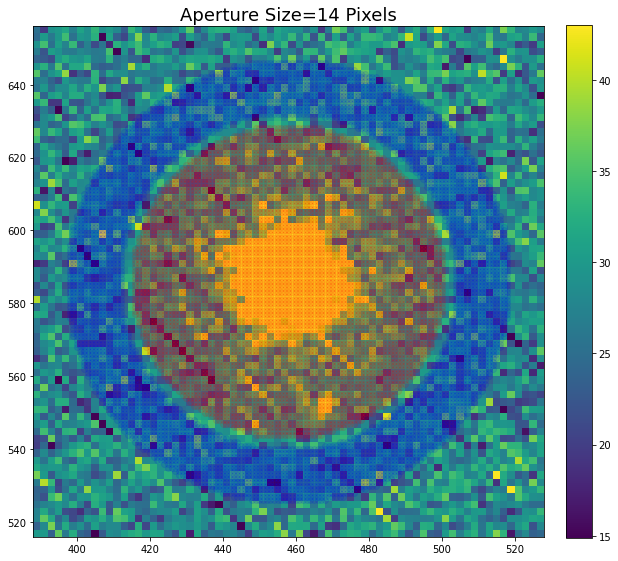

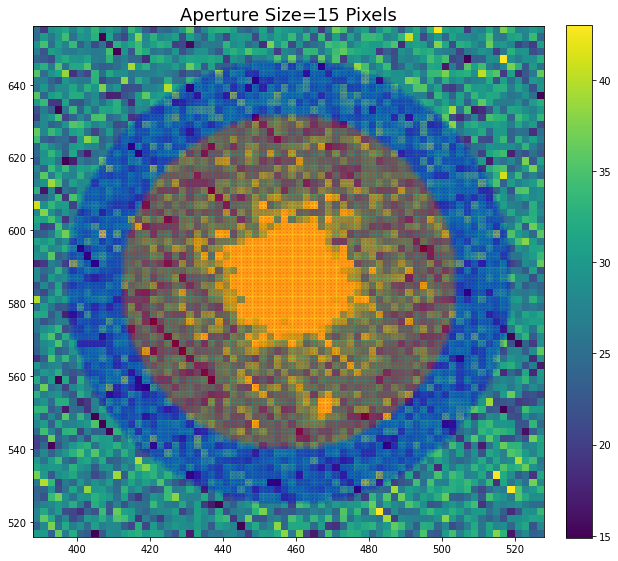

In [498]:
for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    show_image(images[12,:,:])
    plt.scatter(aperture_columns,aperture_rows,c='r',alpha=0.1)
    plt.scatter(annulus_columns,annulus_rows,c='b',alpha=0.1)
    plt.title('Aperture Size={:.0f} Pixels'.format(size),fontsize=18)
    plt.axis([center[1]-70,center[1]+70,center[0]-70,center[0]+70])
    plt.show()

Text(0.5, 1.0, 'Medium Source')

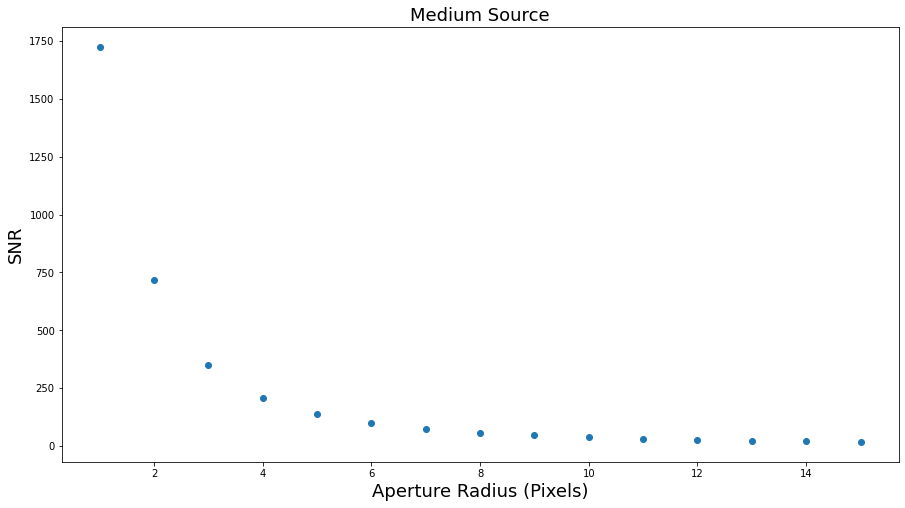

In [499]:
SNR=[]

for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    annulus_mean=np.mean([images[12,annulus_rows[i],annulus_columns[i]] for i in range(len(annulus_rows))])
    aperture_no_bg=[images[12,aperture_rows[i],aperture_columns[i]] for i in range(len(aperture_rows))] - annulus_mean
    background_counts=annulus_mean*len(aperture_rows)
    
    
    Rst=np.sum(aperture_no_bg)
    Rbt=background_counts
    npix=len(aperture_rows)
    
    SNR.append(get_SNR(Rst,npix,Rbt))
    
    
plt.scatter(aperture_sizes,SNR)
plt.xlabel('Aperture Radius (Pixels)',fontsize=18)
plt.ylabel('SNR',fontsize=18)
plt.title('Medium Source',fontsize=18)

### Really bright

(449.0, 649.0, 1596.0, 1796.0)

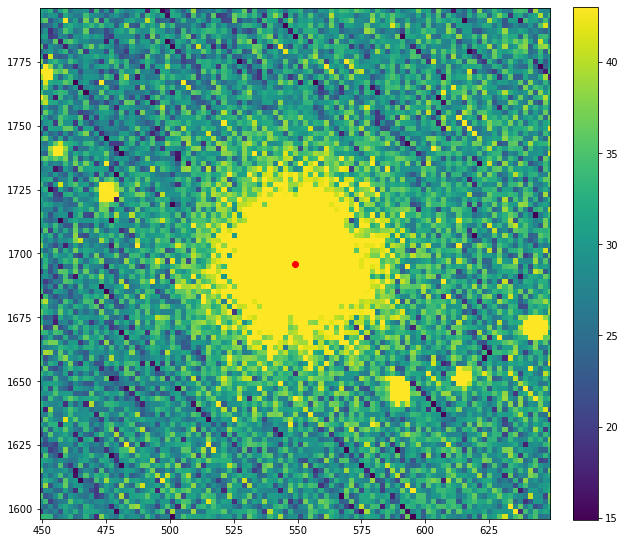

In [500]:
x_ds9=603-54
y_ds9=1696
center=[y_ds9,x_ds9]
show_image(images[12,:,:])
plt.scatter(center[1],center[0],c='r')
plt.axis([center[1]-100,center[1]+100,center[0]-100,center[0]+100])

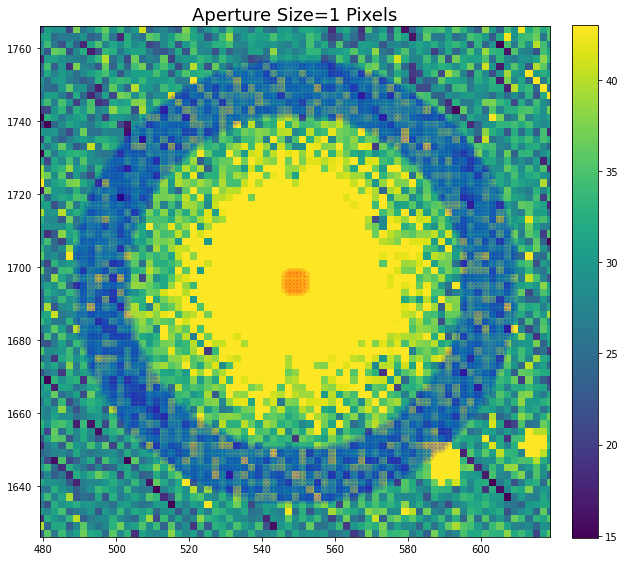

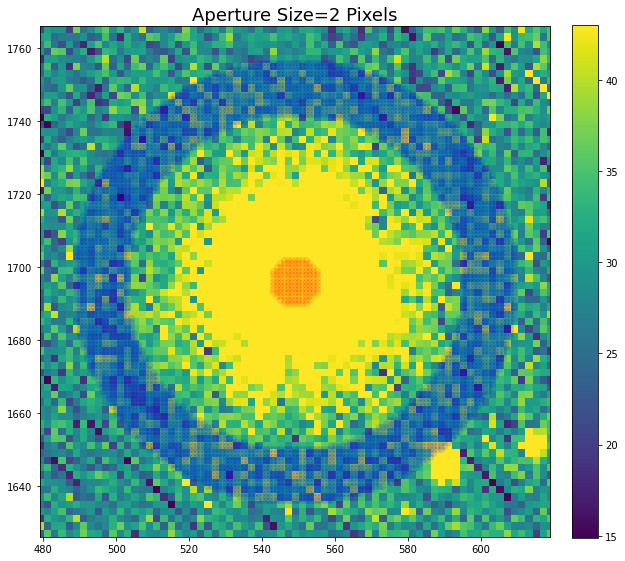

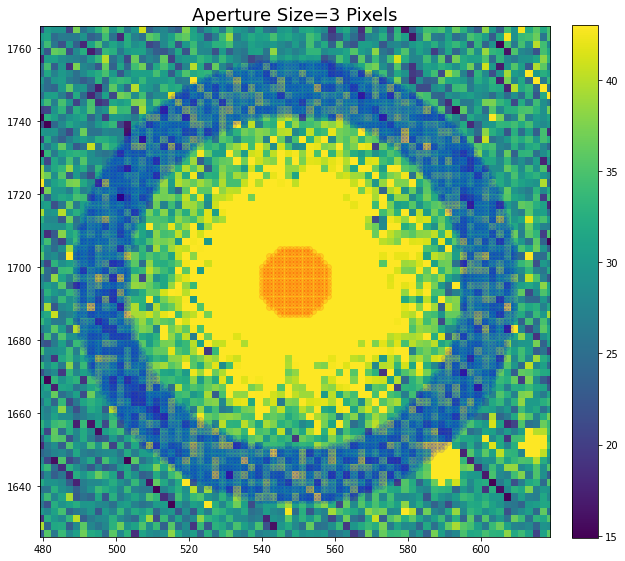

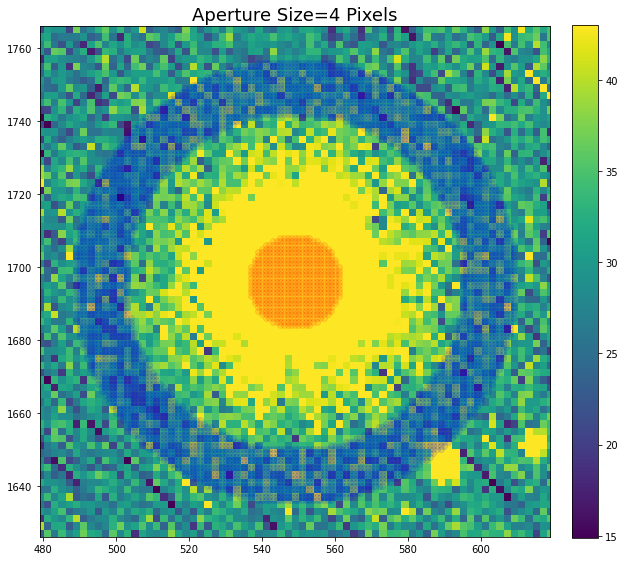

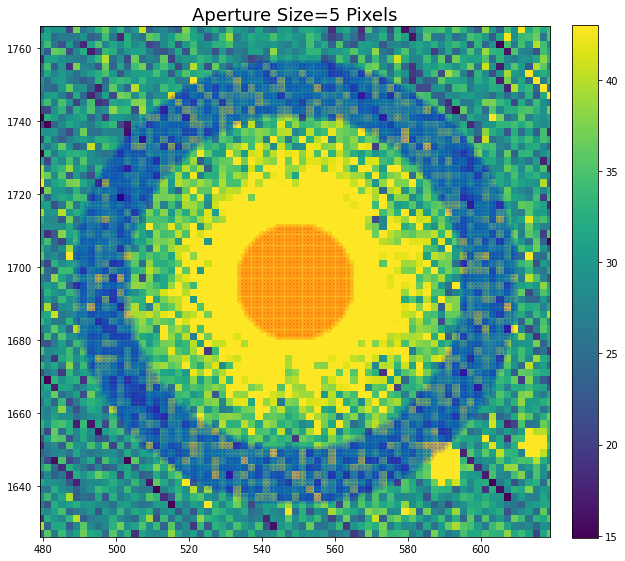

...

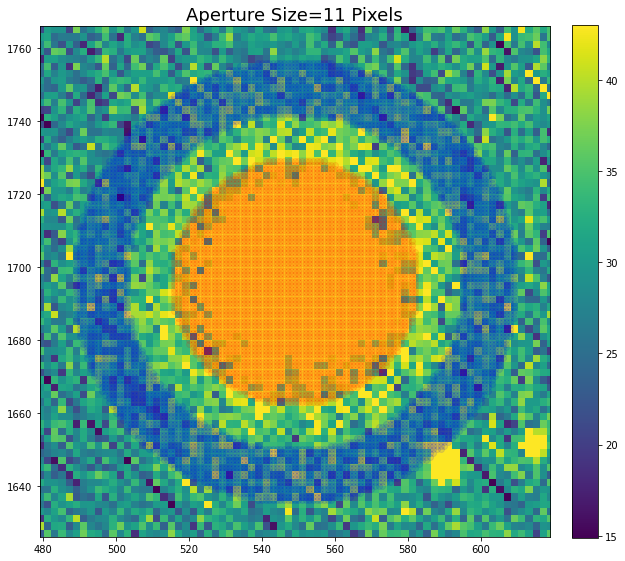

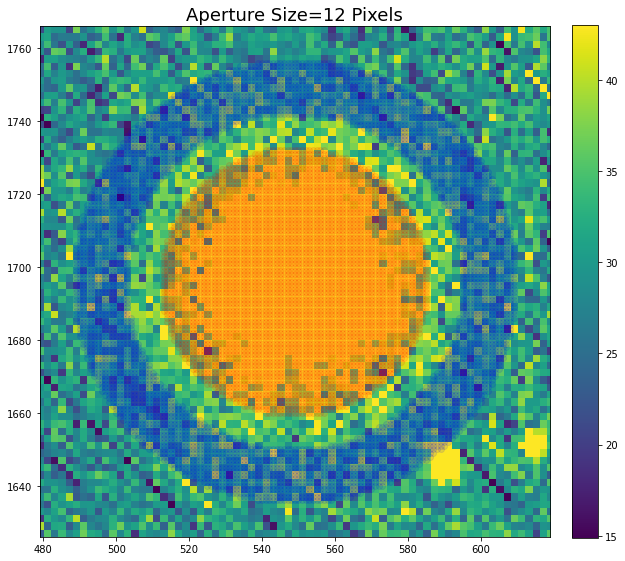

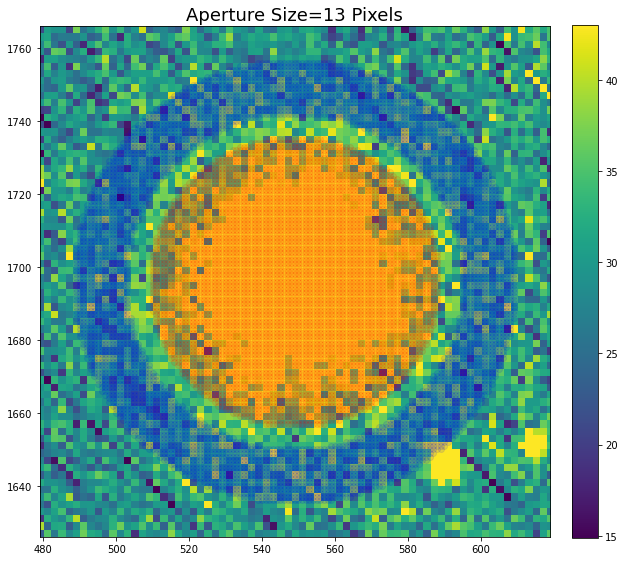

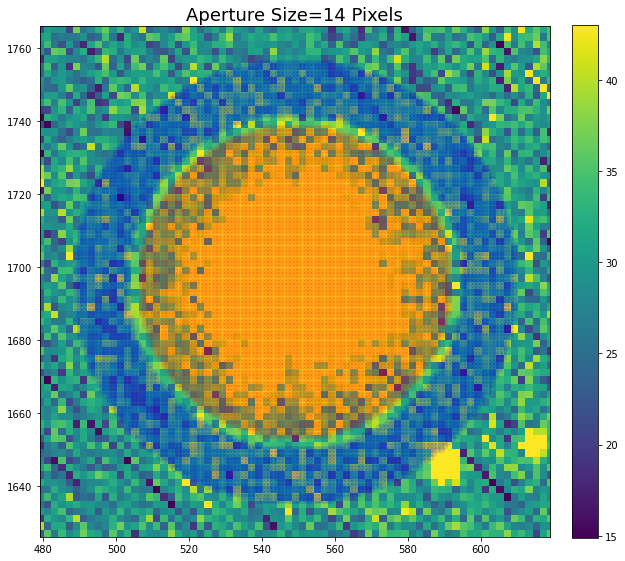

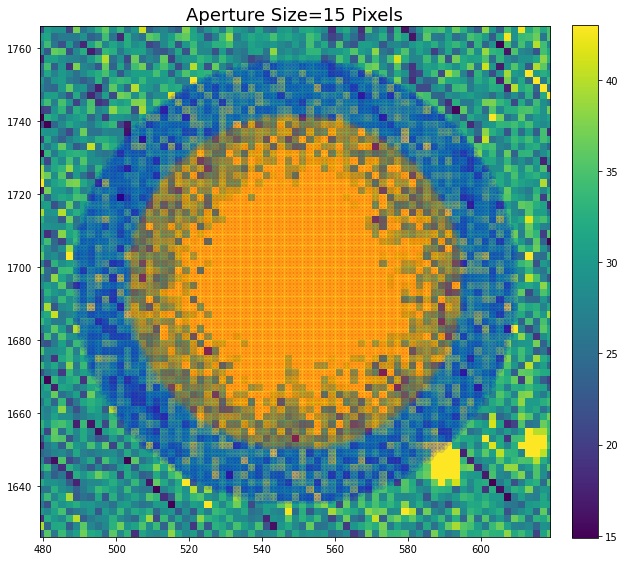

In [491]:
for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    show_image(images[12,:,:])
    plt.scatter(aperture_columns,aperture_rows,c='r',alpha=0.1)
    plt.scatter(annulus_columns,annulus_rows,c='b',alpha=0.1)
    plt.title('Aperture Size={:.0f} Pixels'.format(size),fontsize=18)
    plt.axis([center[1]-70,center[1]+70,center[0]-70,center[0]+70])
    plt.show()

Text(0.5, 1.0, 'Bright Source')

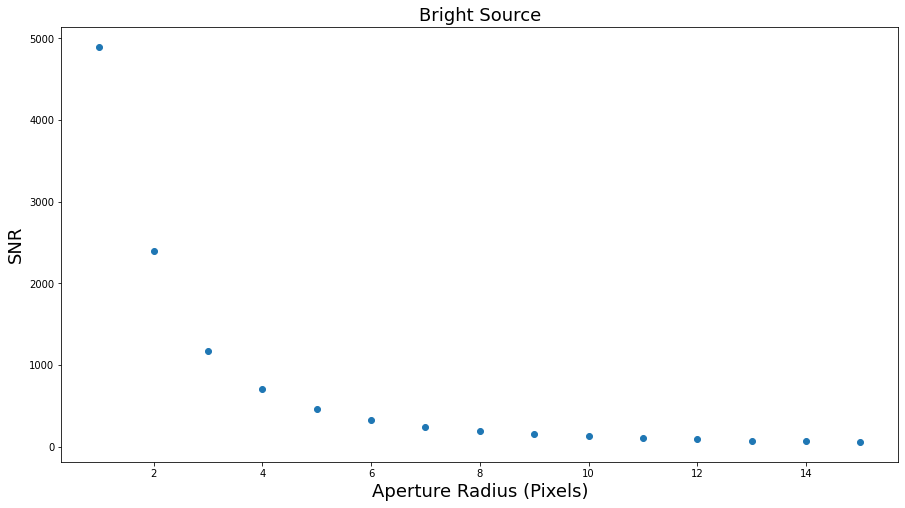

In [501]:
SNR=[]

for size in aperture_sizes:
    radius=size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)

    annulus_mean=np.mean([images[12,annulus_rows[i],annulus_columns[i]] for i in range(len(annulus_rows))])
    aperture_no_bg=[images[12,aperture_rows[i],aperture_columns[i]] for i in range(len(aperture_rows))] - annulus_mean
    background_counts=annulus_mean*len(aperture_rows)
    
    Rst=np.sum(aperture_no_bg)
    Rbt=background_counts
    npix=len(aperture_rows)
    
    SNR.append(get_SNR(Rst,npix,Rbt))
    
plt.scatter(aperture_sizes,SNR)
plt.xlabel('Aperture Radius (Pixels)',fontsize=18)
plt.ylabel('SNR',fontsize=18)
plt.title('Bright Source',fontsize=18)

### It looks like an aperture radius of 9 pixels is necessary to capture the bright source

4. Identify the standard stars in the PG1633+099 frame from Landolt (1992).

from http://www.not.iac.es/instruments/alfosc/photstd/pg1633.html

![title](PG1633_values.png)
![title](PG1633_finding.png)

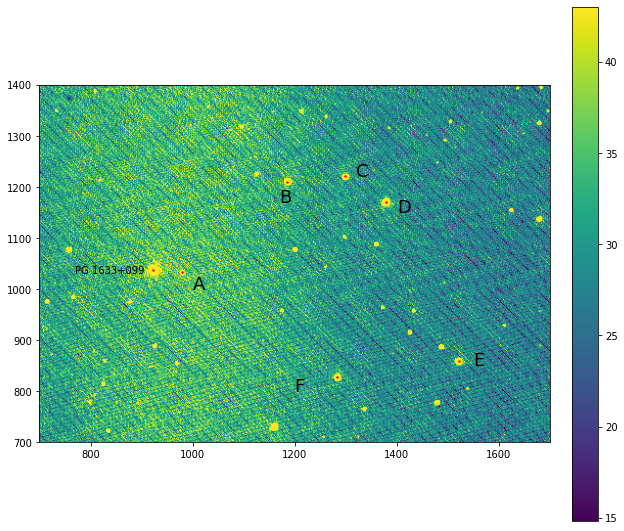

In [493]:
show_image(images[12,:,:])
plt.annotate('D',(1400,1150),c='k',fontsize=18)
plt.annotate('C',(1320,1220),c='k',fontsize=18)
plt.annotate('B',(1170,1170),c='k',fontsize=18)
plt.annotate('A',(1000,1000),c='k',fontsize=18)
plt.annotate('PG 1633+099',(770,1030),c='k',fontsize=10)
plt.annotate('F',(1200,800),c='k',fontsize=18)
plt.annotate('E',(1550,850),c='k',fontsize=18)

plt.axis([700,1700,700,1400])
plt.scatter(923,1037,c='r',s=2) #PG 1633+099
plt.scatter(980,1033,c='r',s=2) #A
plt.scatter(1185,1210,c='r',s=2) #B
plt.scatter(1299,1222,c='r',s=2) #C
plt.scatter(1379,1170,c='r',s=2) #D
plt.scatter(1521,860,c='r',s=2) #E
plt.scatter(1282,828,c='r',s=2) #F

5. Extract instrumental magnitudes for all of your standard stars using an approach that you’ve advocated for as best you can in the questions above.

In [502]:
def get_instrumental_magnitude(image,
                               center,
                               t,
                               bandwidth,
                               WL_eff,
                               flux_zeropoint,
                               aperture_size=5,
                               inner_annulus=7,
                               outer_annulus=11,
                               scaling=3,
                               gain=2.5,
                               telescope_radius=2.3):
    '''
    
    given a star centroid, calculates the source rate and converts that to an instrumental magnitude.
    WIRO gain is 2.5 e- / ADU
    
    params:
        images - image with num_rows x num_columns
        center - list with [row,column] of centroid of target
        aperture_size - radius of the aperture in pixels
        inner_annulus - radius of inner annulus in pixels
        outer_annulus - radius of outer annulus in pixels
        t - exposure time (seconds)
        scaling - number of rows/columns in images per physical pixel
        gain - telescope gain (e-/ADU)
        telescope_radius - radius of telescope in meters
        bandwidth - transmittance weighted bandwidth in Angstroms
        WL_eff - effective wavelength of bandpass in Angstroms
        flux_zeropoint - zero point flux in erg s^-1 cm^-2 A^-1
        
    returns:
        mag - instrumental magnitude for the target
    '''
    
    h=6.626e-27 #erg s
    c=3e18 #A s^-1
    
    num_rows=np.shape(image)[0]
    num_columns=np.shape(image)[1]
    
    
    radius=aperture_size*scaling
    inner_radius=inner_annulus*scaling
    outer_radius=outer_annulus*scaling
    aperture_rows,aperture_columns=get_aperture_pixels(center,radius)
    annulus_rows,annulus_columns=get_annulus_pixels(center,inner_radius,outer_radius)
    
    show_image(image)
    #plt.scatter(center[1],center[0],c='r')
    plt.scatter(aperture_columns,aperture_rows,c='r',alpha=0.1)
    plt.scatter(annulus_columns,annulus_rows,c='b',alpha=0.1)
    plt.axis([center[1]-100,center[1]+100,center[0]-100,center[0]+100])
    plt.show()
    

    annulus_mean=np.mean([image[annulus_rows[j],annulus_columns[j]] for j in range(len(annulus_rows))])
    print("Annulus mean counts: {:.2f}".format(annulus_mean))
    aperture=[image[aperture_rows[j],aperture_columns[j]] for j in range(len(aperture_rows))]
    print("Aperture mean counts: {:.2f}".format(np.mean(aperture)))
    aperture_no_bg=aperture - annulus_mean
    background_counts=annulus_mean*len(aperture_rows)

    Rst=np.sum(aperture_no_bg)
    Rs_ADU=Rst/t #counts s^-1

    Rs=Rs_ADU*gain # e- s^-1 which we assume is equal to photons s^-1
    
    print("Source Rate: {:.2f} photons s^-1".format(Rs))

    # Convert to photons s^-1 cm^-2 A^-1
    # (Divide by area of telescope and width of bandpass)
    Rs=Rs/(bandwidth*np.pi*(telescope_radius*100)**2) # photons s^-1 cm^-2 A^-1
    
    print("Source Rate: {:.3e} photons s^-1 cm^-2 A^-1".format(Rs))

    # How many ergs per photon at this wavelength?
    E_eff=h*c/WL_eff # ergs photon^-1
    
    print("Effective Energy: {:.3e} ergs photon^-1".format(E_eff))

    Rs=Rs*E_eff # ergs s^-1 cm^-2 A^-1
    
    print("Source Rate: {:.3e} erg s^-1 cm^-2 A^-1".format(Rs))
    
    #m1-m2=-2.5log_10(F1/F2)
    mag=-2.5*np.log10(Rs/flux_zeropoint)
    
    return mag

## U Band

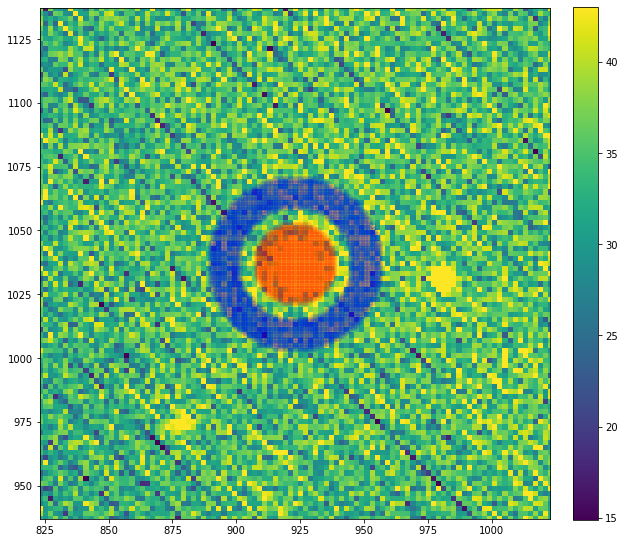

Annulus mean counts: 35.54
Aperture mean counts: 241.41
Source Rate: 6802.22 photons s^-1
Source Rate: 6.202e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 3.377e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.73


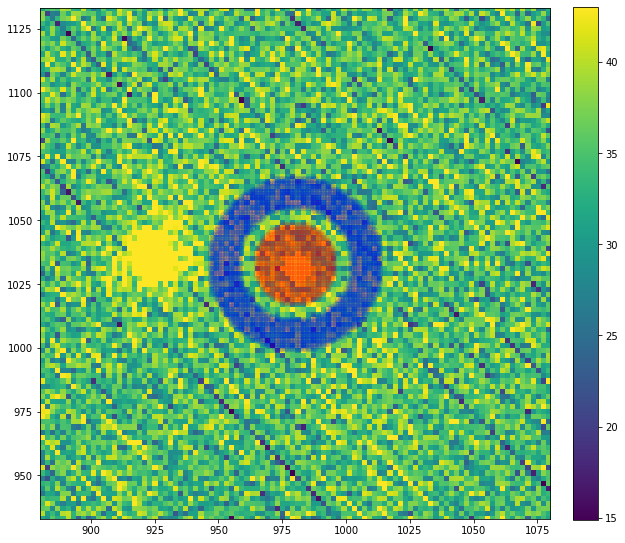

Annulus mean counts: 35.14
Aperture mean counts: 49.25
Source Rate: 466.14 photons s^-1
Source Rate: 4.250e-06 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 2.314e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 20.64


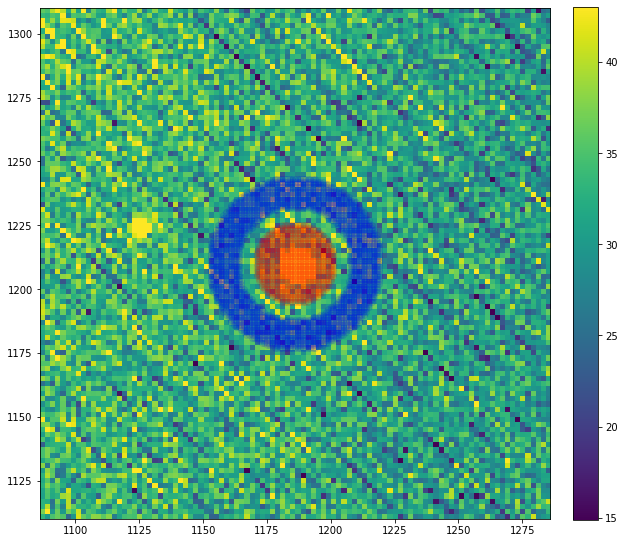

Annulus mean counts: 32.20
Aperture mean counts: 85.47
Source Rate: 1760.04 photons s^-1
Source Rate: 1.605e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 8.739e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.20


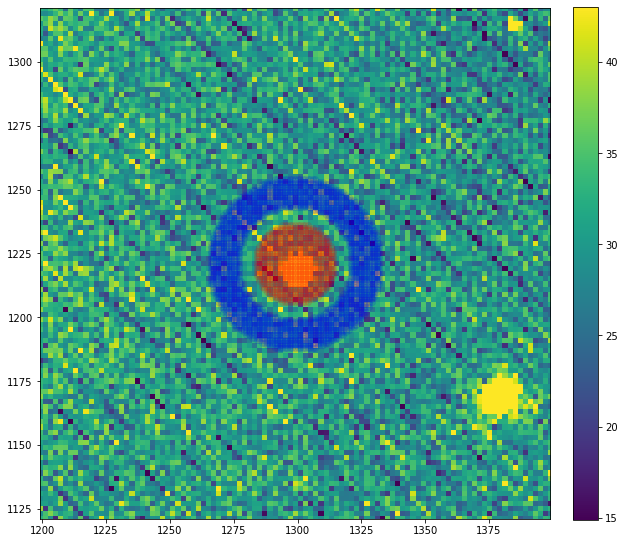

Annulus mean counts: 30.21
Aperture mean counts: 67.46
Source Rate: 1230.87 photons s^-1
Source Rate: 1.122e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 6.111e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.59


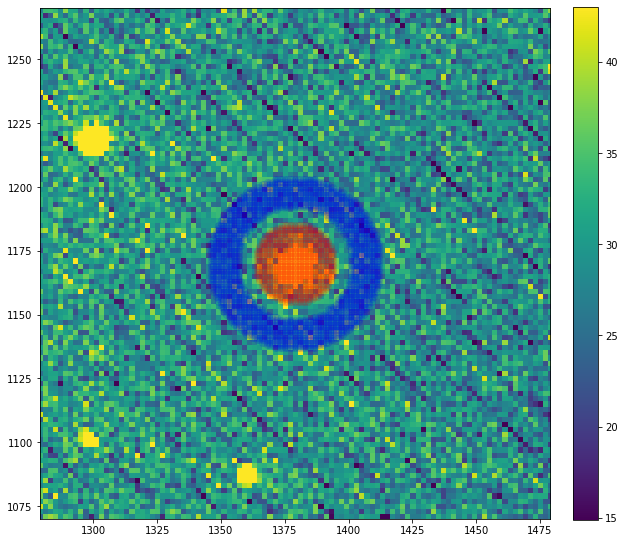

Annulus mean counts: 29.58
Aperture mean counts: 134.80
Source Rate: 3476.72 photons s^-1
Source Rate: 3.170e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.726e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.46


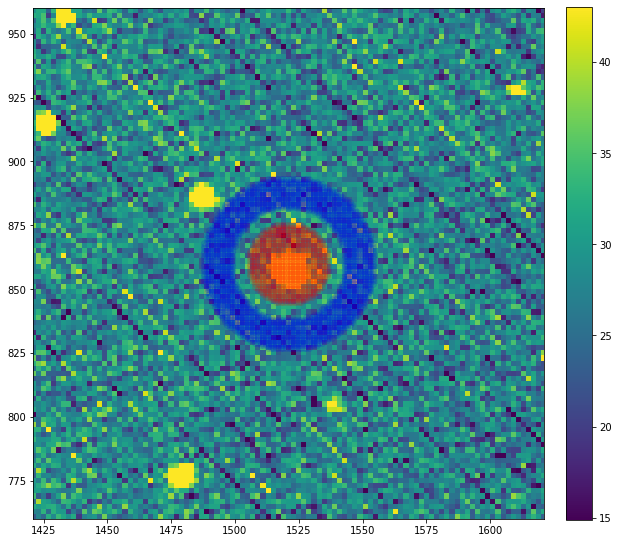

Annulus mean counts: 28.09
Aperture mean counts: 123.79
Source Rate: 3162.27 photons s^-1
Source Rate: 2.883e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.570e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.56


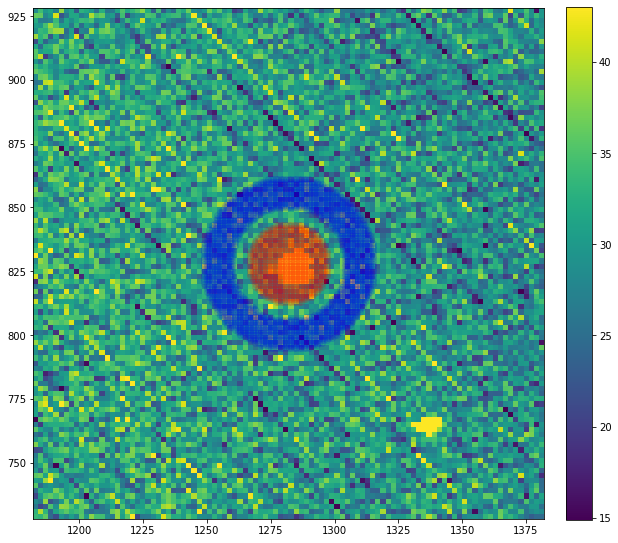

Annulus mean counts: 29.94
Aperture mean counts: 87.85
Source Rate: 1913.27 photons s^-1
Source Rate: 1.744e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 9.500e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.11


In [503]:
# centroids for PG1633, A, B, C, D, E, F respectively
centers=[[1037,923],[1033,980],[1210,1186],[1221,1299],[1170,1379],[860,1521],[828,1282]]

image=images[12,:,:]
t=60 #seconds
#info for U bandpass
bandwidth=660 #angstroms
WL_eff=3650 #angstroms
flux_zeropoint=417.5e-11 # erg s^-1 cm^-2 A^-1

inst_mags=np.zeros(shape=(len(images),7))
airmasses=np.zeros(len(images))
airmasses[12]=1.49

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[12,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))


/Users/dabbiecm/Imaging/a237.fits


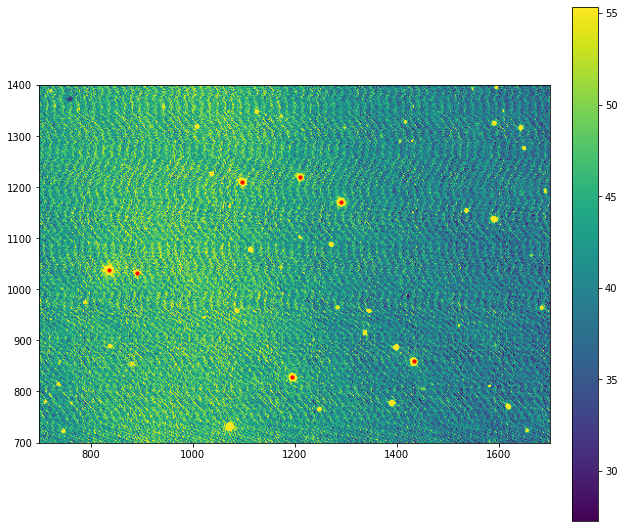

In [508]:
print(PG1633_names[22])
image=images[22,:,:] # this is U band, 60 s exposure, X=2.15

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(836,1038,c='r',s=10) #PG 1633+099
plt.scatter(892,1033,c='r',s=10) #A
plt.scatter(1096,1210,c='r',s=10) #B
plt.scatter(1210,1220,c='r',s=10) #C
plt.scatter(1290,1172,c='r',s=10) #D
plt.scatter(1433,860,c='r',s=10) #E
plt.scatter(1195,828,c='r',s=10) #F


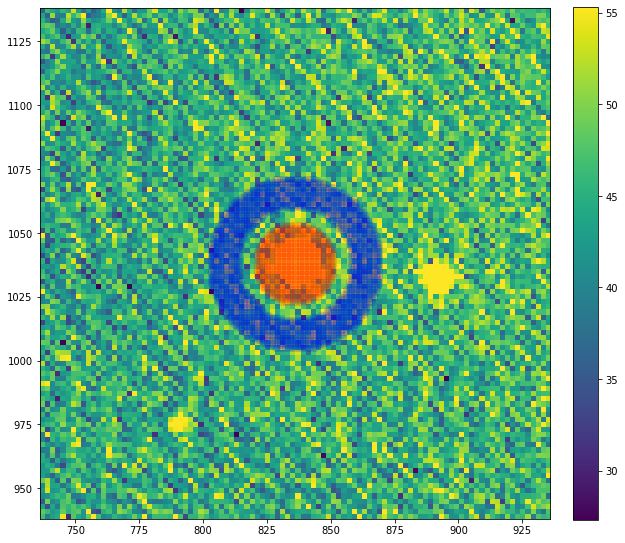

Annulus mean counts: 46.41
Aperture mean counts: 202.97
Source Rate: 5172.81 photons s^-1
Source Rate: 4.716e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 2.568e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.03


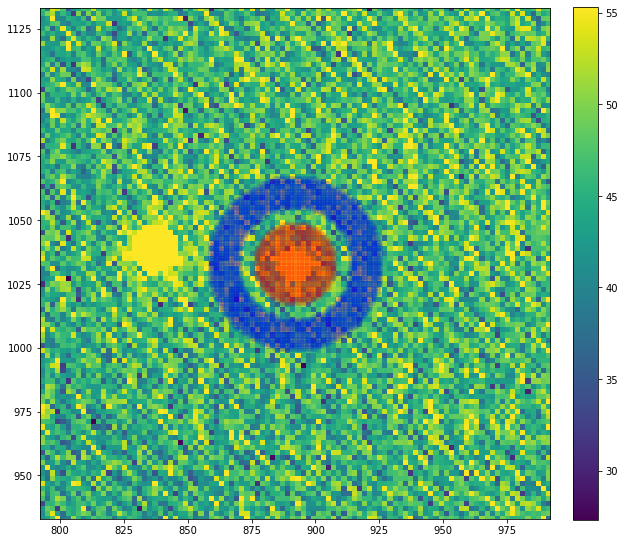

Annulus mean counts: 46.56
Aperture mean counts: 57.25
Source Rate: 353.19 photons s^-1
Source Rate: 3.220e-06 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.754e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 20.94


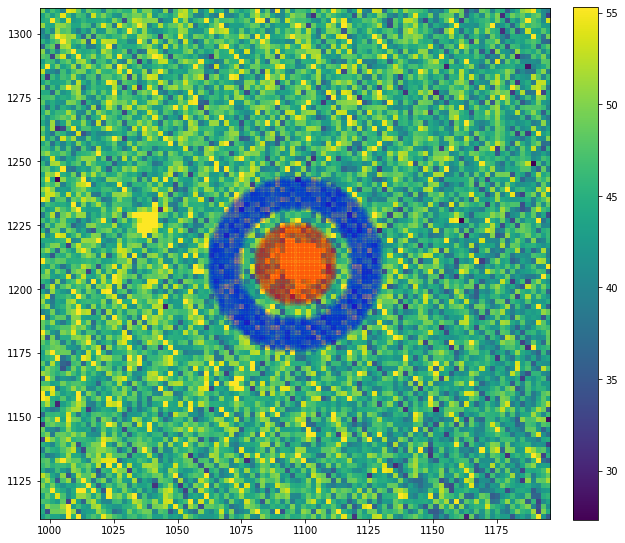

Annulus mean counts: 45.78
Aperture mean counts: 88.96
Source Rate: 1426.49 photons s^-1
Source Rate: 1.301e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 7.083e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.43


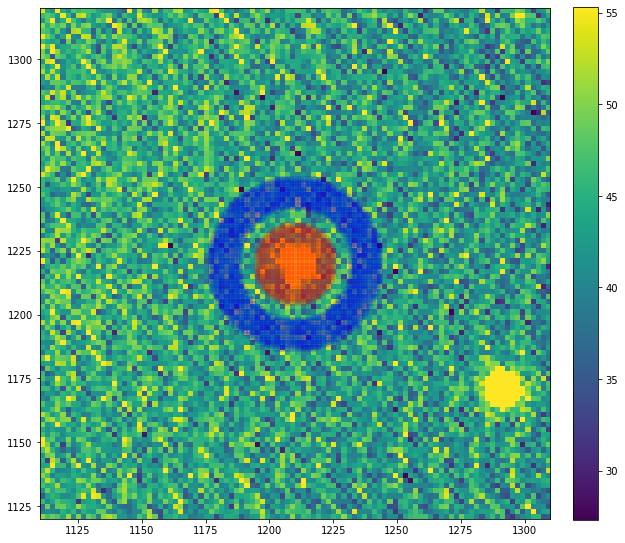

Annulus mean counts: 43.52
Aperture mean counts: 73.30
Source Rate: 984.15 photons s^-1
Source Rate: 8.972e-06 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 4.886e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.83


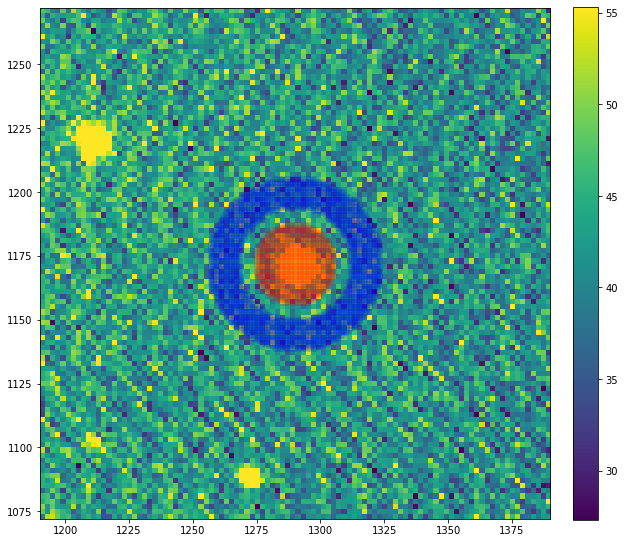

Annulus mean counts: 42.34
Aperture mean counts: 122.32
Source Rate: 2642.58 photons s^-1
Source Rate: 2.409e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.312e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.76


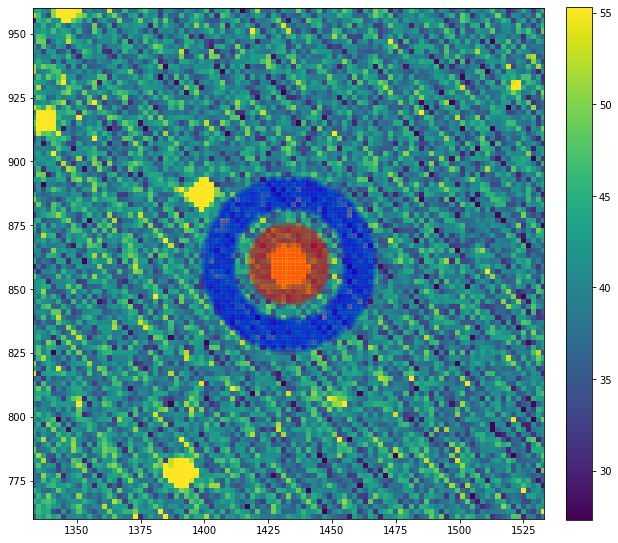

Annulus mean counts: 40.33
Aperture mean counts: 114.76
Source Rate: 2459.21 photons s^-1
Source Rate: 2.242e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.221e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.83


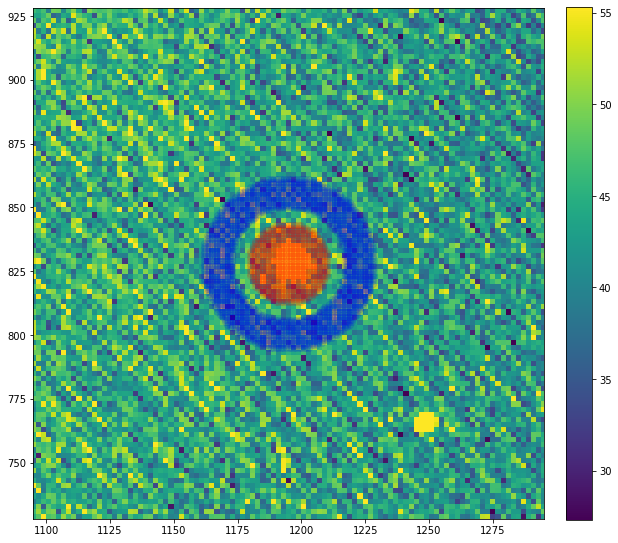

Annulus mean counts: 44.26
Aperture mean counts: 89.75
Source Rate: 1502.86 photons s^-1
Source Rate: 1.370e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 7.462e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.37


In [509]:
centers=[[1038,836],[1033,892],[1210,1096],[1220,1210],[1172,1290],[860,1433],[828,1195]]

image=images[22,:,:]
t=60 #seconds
#info for U bandpass
bandwidth=660 #angstroms
WL_eff=3650 #angstroms
flux_zeropoint=417.5e-11 # erg s^-1 cm^-2 A^-1

airmasses[22]=2.15

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[22,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a082.fits


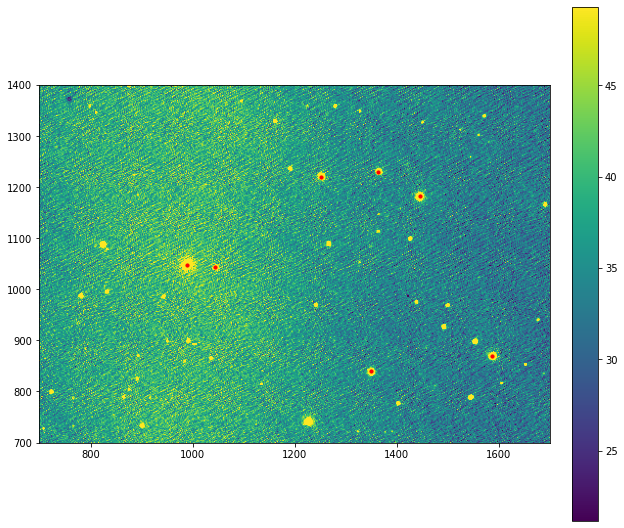

In [645]:
print(PG1633_names[1])
image=images[1,:,:] # this is U band, 60 s exposure, X=1.18

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(990,1047,c='r',s=10) #PG 1633+099
plt.scatter(1044,1044,c='r',s=10) #A
plt.scatter(1251,1221,c='r',s=10) #B
plt.scatter(1364,1230,c='r',s=10) #C
plt.scatter(1445,1182,c='r',s=10) #D
plt.scatter(1586,869,c='r',s=10) #E
plt.scatter(1350,840,c='r',s=10) #F

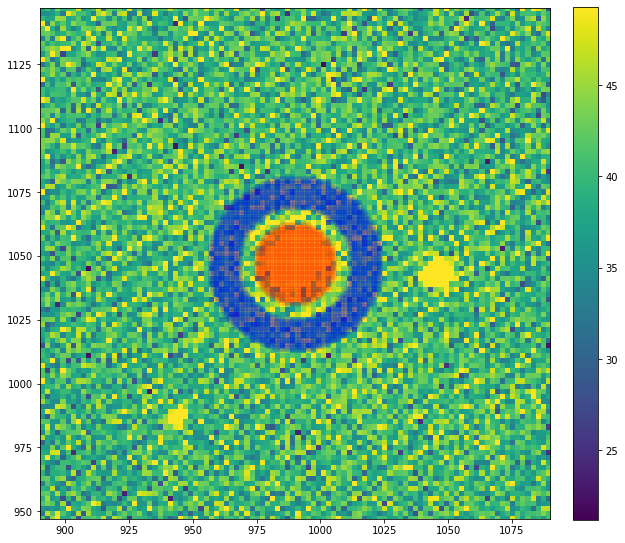

Annulus mean counts: 41.59
Aperture mean counts: 284.61
Source Rate: 8029.98 photons s^-1
Source Rate: 7.321e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 3.987e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.55


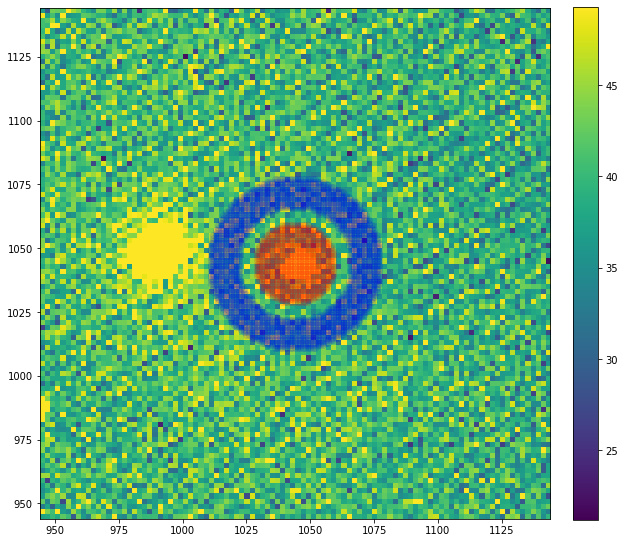

Annulus mean counts: 40.89
Aperture mean counts: 56.18
Source Rate: 505.21 photons s^-1
Source Rate: 4.606e-06 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 2.508e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 20.55


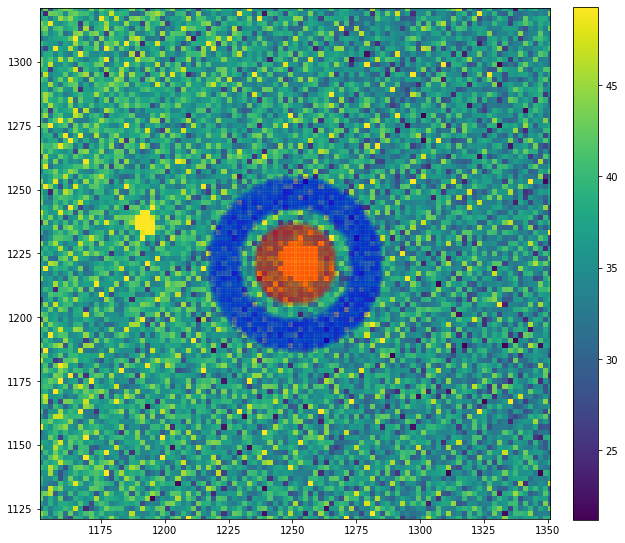

Annulus mean counts: 36.72
Aperture mean counts: 96.99
Source Rate: 1991.47 photons s^-1
Source Rate: 1.816e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 9.888e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.06


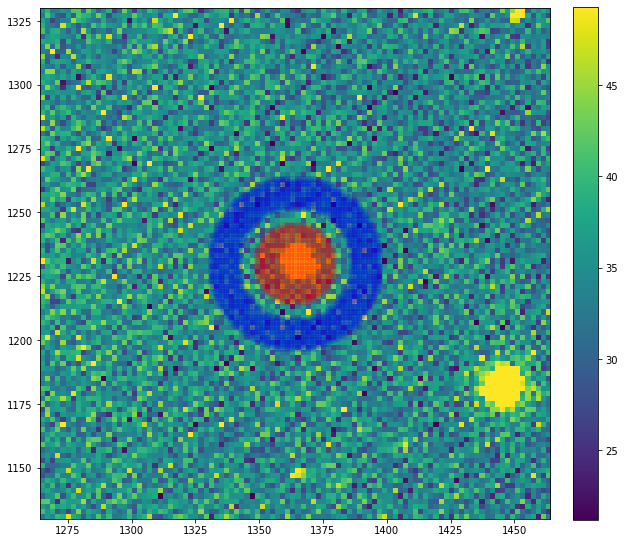

Annulus mean counts: 34.58
Aperture mean counts: 75.72
Source Rate: 1359.36 photons s^-1
Source Rate: 1.239e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 6.749e-17 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.48


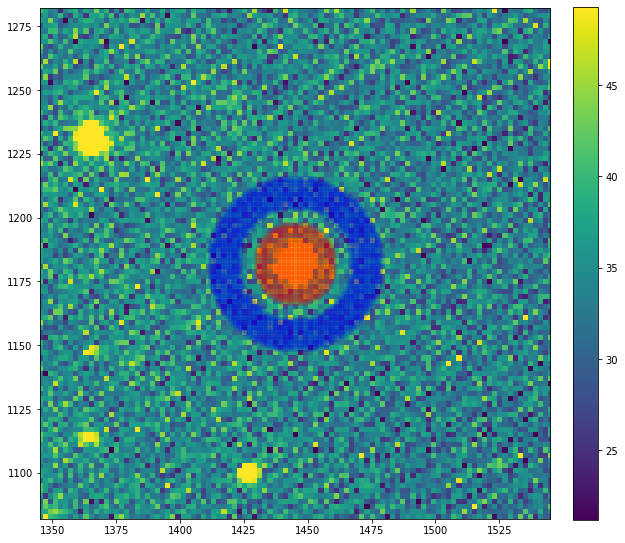

Annulus mean counts: 34.29
Aperture mean counts: 154.12
Source Rate: 3959.48 photons s^-1
Source Rate: 3.610e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.966e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.32


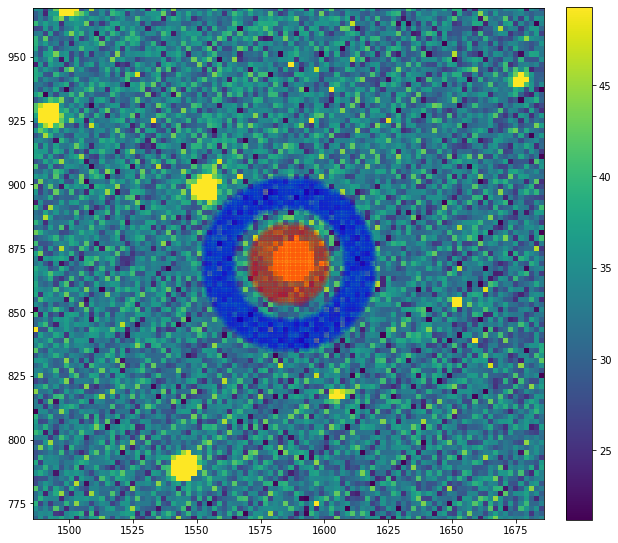

Annulus mean counts: 33.25
Aperture mean counts: 141.42
Source Rate: 3574.11 photons s^-1
Source Rate: 3.259e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.775e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.43


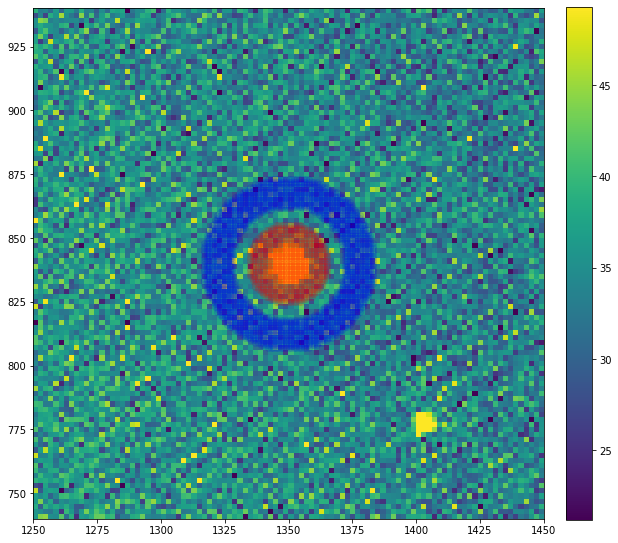

Annulus mean counts: 34.56
Aperture mean counts: 98.19
Source Rate: 2102.39 photons s^-1
Source Rate: 1.917e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 5.446e-12 ergs photon^-1
Source Rate: 1.044e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 19.01


In [646]:
centers=[[1047,990],[1044,1044],[1221,1251],[1230,1364],[1182,1445],[869,1586],[840,1350]]

image=images[1,:,:]
t=60 #seconds
#info for U bandpass
bandwidth=660 #angstroms
WL_eff=3650 #angstroms
flux_zeropoint=417.5e-11 # erg s^-1 cm^-2 A^-1

airmasses[1]=1.18

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[1,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

## B band

/Users/dabbiecm/Imaging/a083.fits


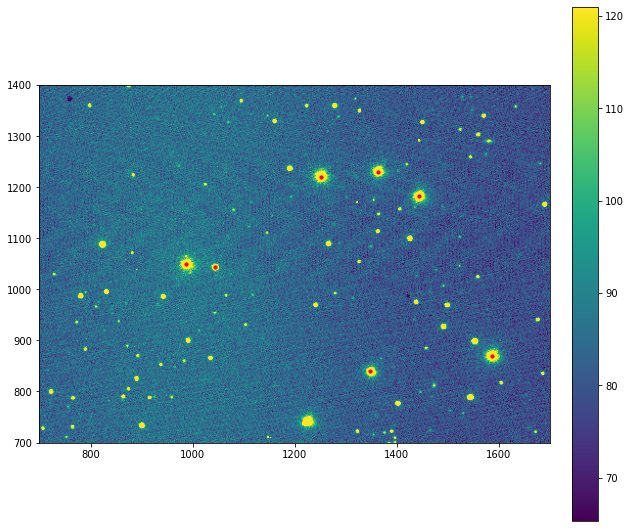

In [647]:
print(PG1633_names[2])
image=images[2,:,:] # this is B band, 30 s exposure, X=1.18

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(987,1050,c='r',s=10) #PG 1633+099
plt.scatter(1044,1043,c='r',s=10) #A
plt.scatter(1252,1220,c='r',s=10) #B
plt.scatter(1363,1230,c='r',s=10) #C
plt.scatter(1443,1182,c='r',s=10) #D
plt.scatter(1586,870,c='r',s=10) #E
plt.scatter(1347,840,c='r',s=10) #F

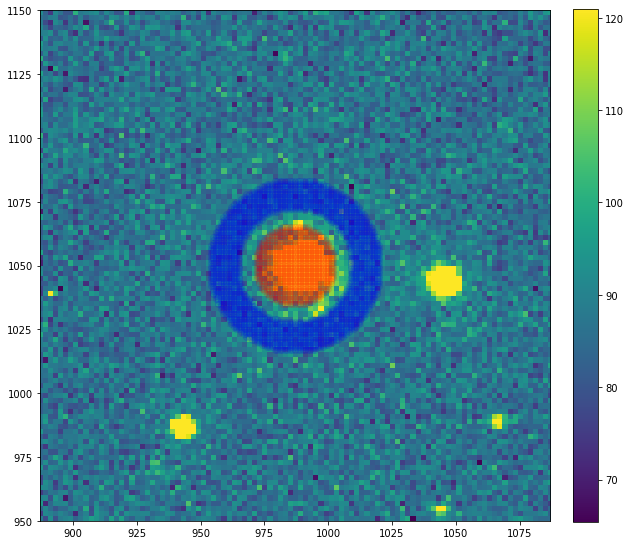

Annulus mean counts: 89.95
Aperture mean counts: 678.70
Source Rate: 38906.63 photons s^-1
Source Rate: 2.601e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.181e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.82


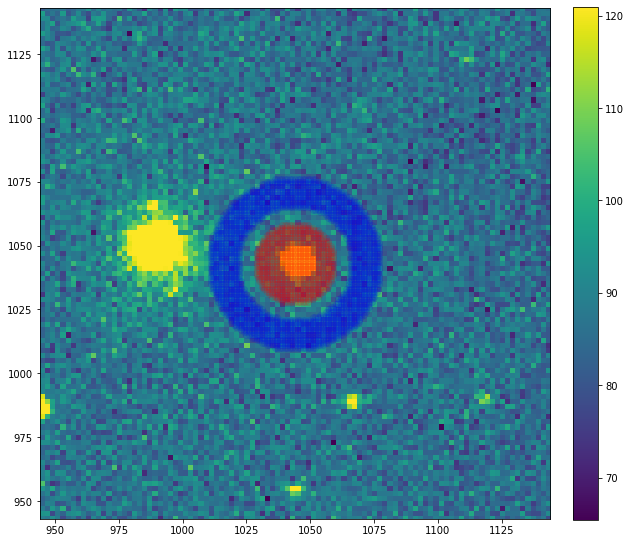

Annulus mean counts: 88.07
Aperture mean counts: 196.20
Source Rate: 7145.97 photons s^-1
Source Rate: 4.778e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 2.168e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.66


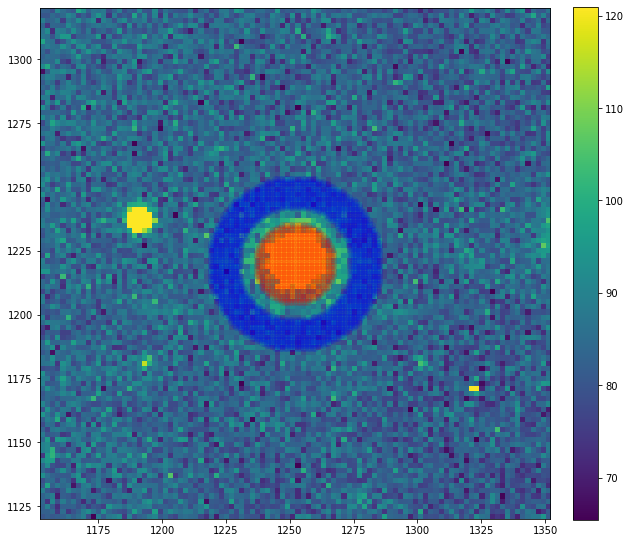

Annulus mean counts: 86.44
Aperture mean counts: 846.59
Source Rate: 50233.31 photons s^-1
Source Rate: 3.358e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.524e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.54


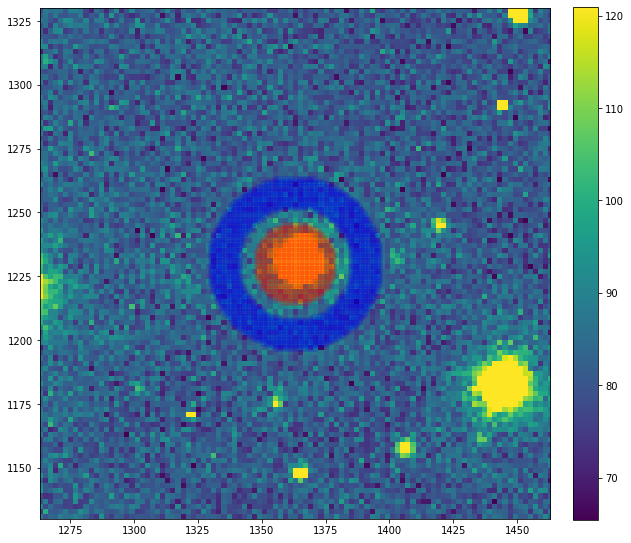

Annulus mean counts: 84.55
Aperture mean counts: 657.54
Source Rate: 37864.83 photons s^-1
Source Rate: 2.532e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.149e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.85


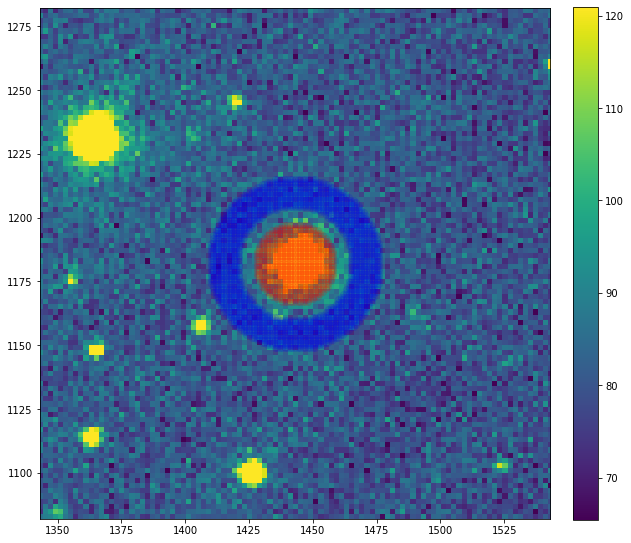

Annulus mean counts: 83.73
Aperture mean counts: 700.89
Source Rate: 40784.40 photons s^-1
Source Rate: 2.727e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.237e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.77


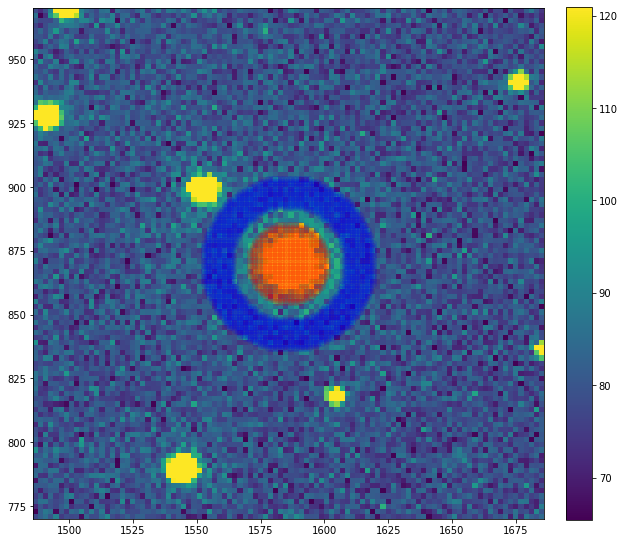

Annulus mean counts: 83.31
Aperture mean counts: 888.74
Source Rate: 53225.51 photons s^-1
Source Rate: 3.559e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.615e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.48


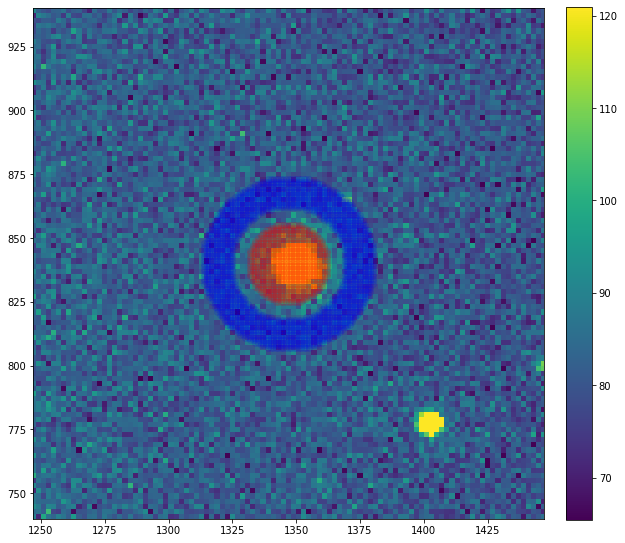

Annulus mean counts: 83.04
Aperture mean counts: 505.17
Source Rate: 27895.54 photons s^-1
Source Rate: 1.865e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 8.464e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.18


In [648]:
centers=[[1050,987],[1043,1044],[1220,1252],[1230,1363],[1182,1443],[870,1586],[840,1347]]

image=images[2,:,:]
t=30 #seconds
#info for B bandpass
bandwidth=900 #angstroms
WL_eff=4380 #angstroms
flux_zeropoint=632e-11 # erg s^-1 cm^-2 A^-1

airmasses[2]=1.18

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[2,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a204.fits


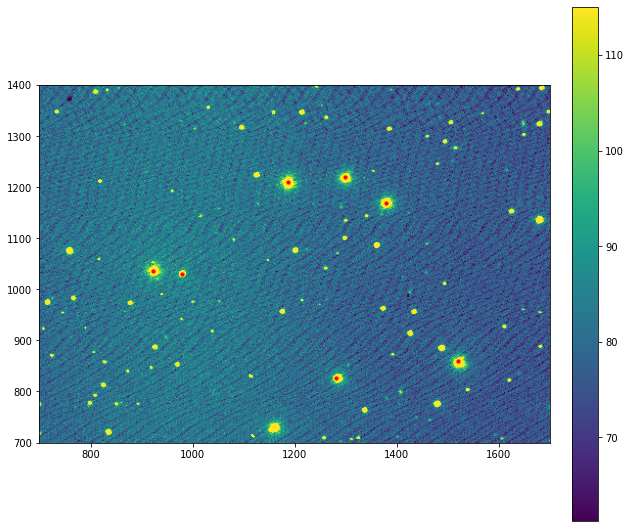

In [700]:
print(PG1633_names[14])
image=images[14,:,:] # this is B band, 30 s exposure, X=1.51

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(922,1036,c='r',s=10) #PG 1633+099
plt.scatter(980,1030,c='r',s=10) #A
plt.scatter(1186,1210,c='r',s=10) #B
plt.scatter(1298,1220,c='r',s=10) #C
plt.scatter(1378,1170,c='r',s=10) #D
plt.scatter(1520,860,c='r',s=10) #E
plt.scatter(1281,827,c='r',s=10) #F

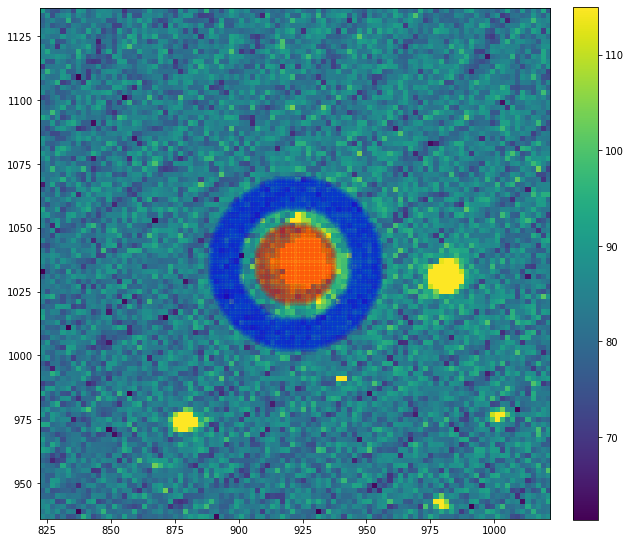

Annulus mean counts: 86.25
Aperture mean counts: 626.86
Source Rate: 35725.30 photons s^-1
Source Rate: 2.389e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.084e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.91


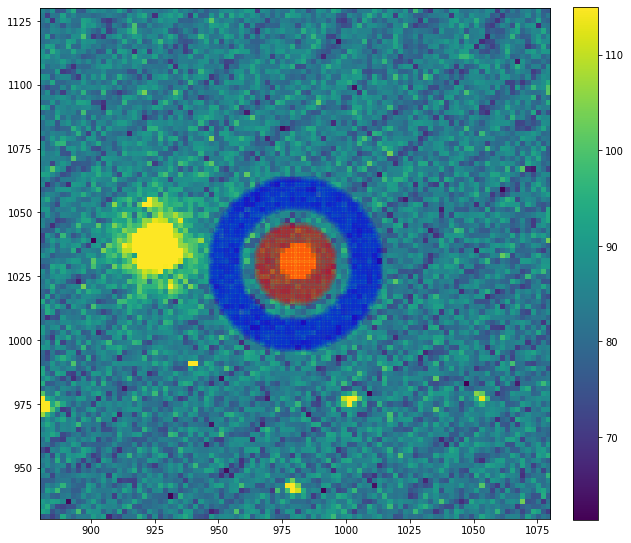

Annulus mean counts: 84.64
Aperture mean counts: 186.54
Source Rate: 6733.91 photons s^-1
Source Rate: 4.502e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 2.043e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.73


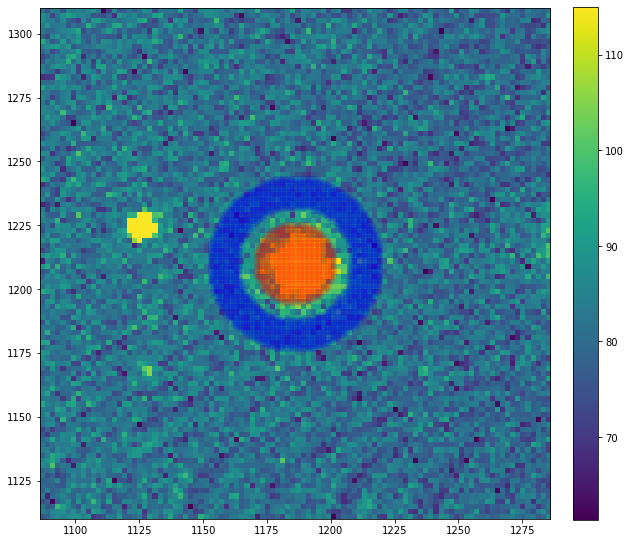

Annulus mean counts: 84.22
Aperture mean counts: 791.37
Source Rate: 46731.00 photons s^-1
Source Rate: 3.124e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.418e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.62


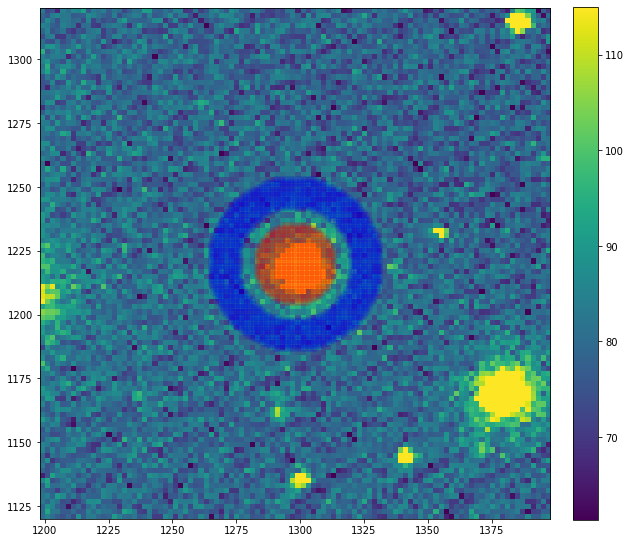

Annulus mean counts: 81.60
Aperture mean counts: 619.07
Source Rate: 35517.46 photons s^-1
Source Rate: 2.375e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.078e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.92


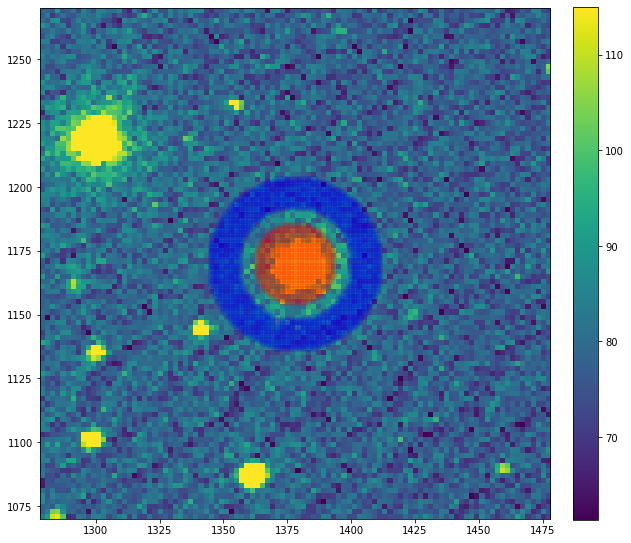

Annulus mean counts: 80.92
Aperture mean counts: 652.81
Source Rate: 37792.08 photons s^-1
Source Rate: 2.527e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.147e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.85


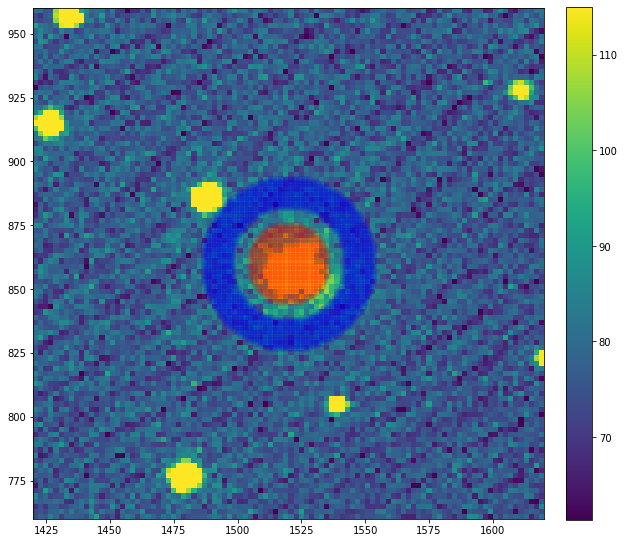

Annulus mean counts: 80.22
Aperture mean counts: 827.92
Source Rate: 49410.44 photons s^-1
Source Rate: 3.303e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.499e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.56


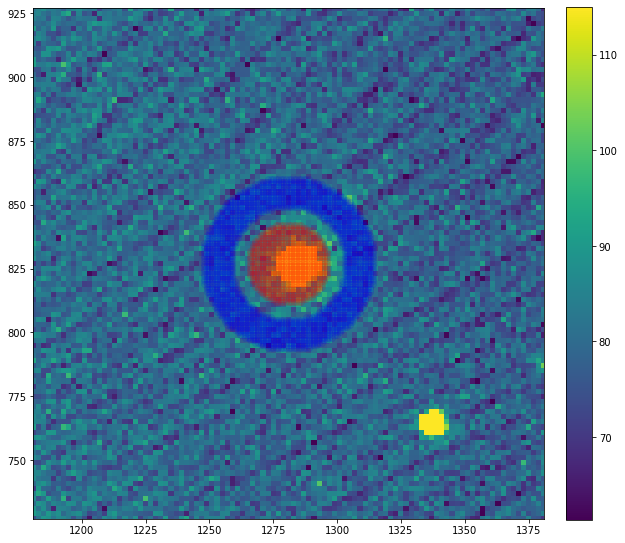

Annulus mean counts: 81.03
Aperture mean counts: 477.69
Source Rate: 26212.67 photons s^-1
Source Rate: 1.753e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 7.954e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.25


In [701]:
centers=[[1036,922],[1030,980],[1210,1186],[1220,1298],[1170,1378],[860,1520],[827,1281]]

image=images[14,:,:]
t=30 #seconds
#info for B bandpass
bandwidth=900 #angstroms
WL_eff=4380 #angstroms
flux_zeropoint=632e-11 # erg s^-1 cm^-2 A^-1

airmasses[14]=1.51

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[14,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a239.fits


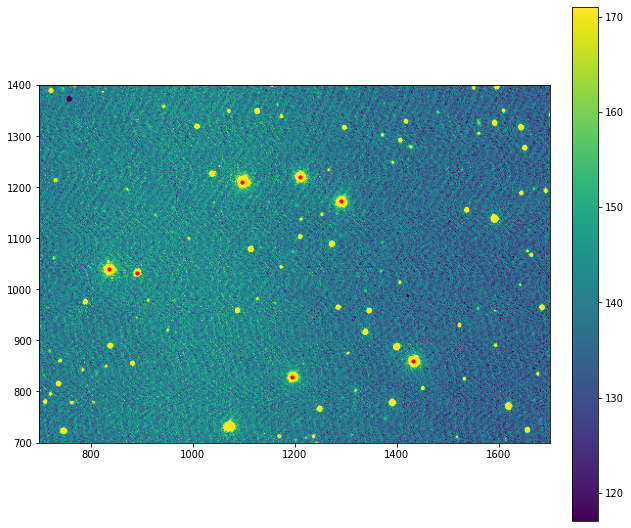

In [734]:
print(PG1633_names[24])
image=images[24,:,:] # this is B band, 30 s exposure, X=2.19

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(837,1040,c='r',s=10) #PG 1633+099
plt.scatter(892,1033,c='r',s=10) #A
plt.scatter(1097,1210,c='r',s=10) #B
plt.scatter(1210,1220,c='r',s=10) #C
plt.scatter(1290,1173,c='r',s=10) #D
plt.scatter(1432,860,c='r',s=10) #E
plt.scatter(1195,829,c='r',s=10) #F

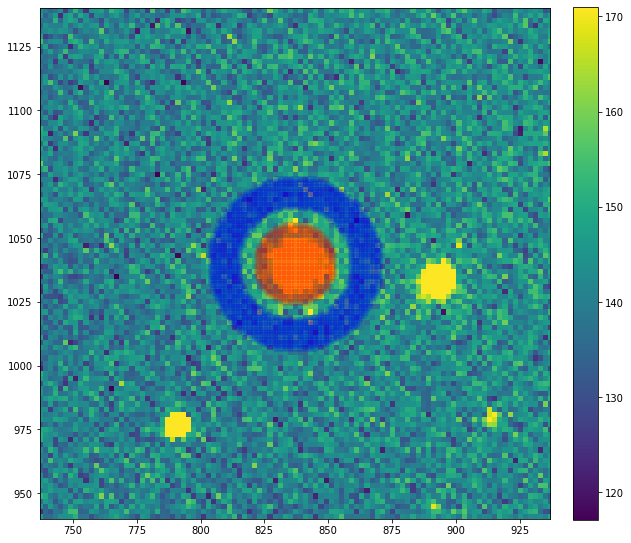

Annulus mean counts: 144.64
Aperture mean counts: 610.19
Source Rate: 30765.14 photons s^-1
Source Rate: 2.057e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 9.335e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.08


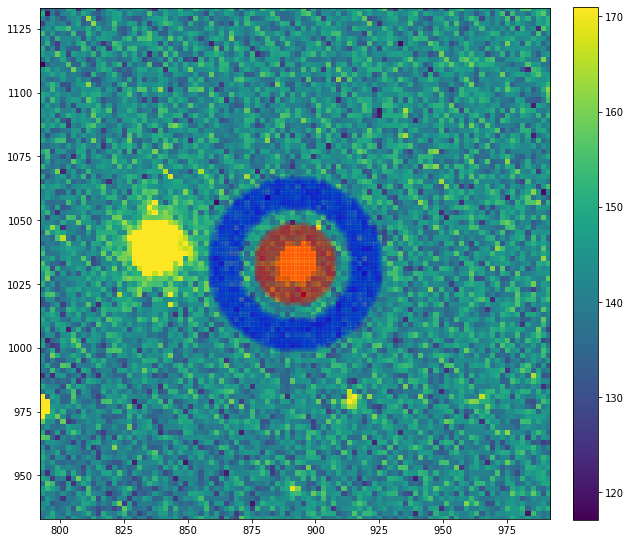

Annulus mean counts: 143.88
Aperture mean counts: 231.95
Source Rate: 5820.28 photons s^-1
Source Rate: 3.891e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.766e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 18.88


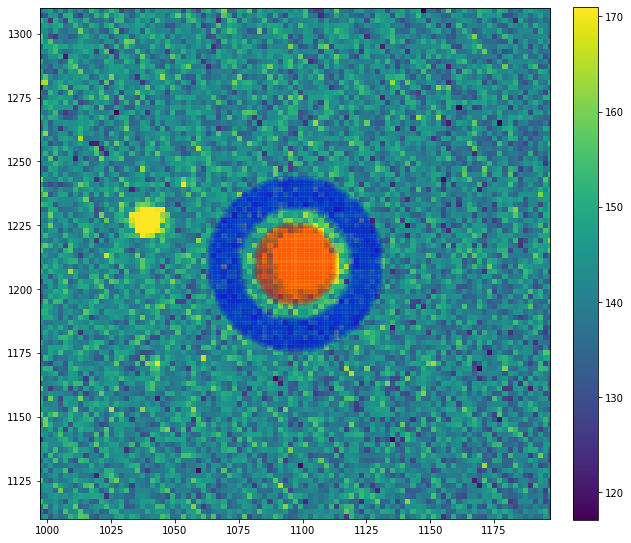

Annulus mean counts: 145.20
Aperture mean counts: 761.88
Source Rate: 40751.76 photons s^-1
Source Rate: 2.725e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.237e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.77


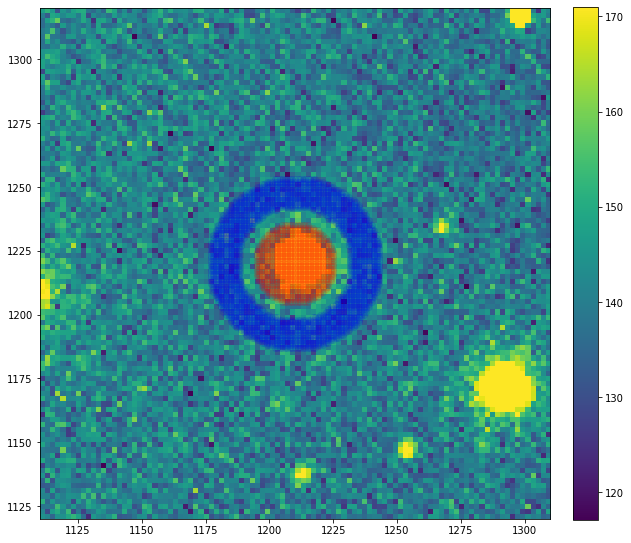

Annulus mean counts: 141.77
Aperture mean counts: 606.21
Source Rate: 30691.53 photons s^-1
Source Rate: 2.052e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 9.313e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.08


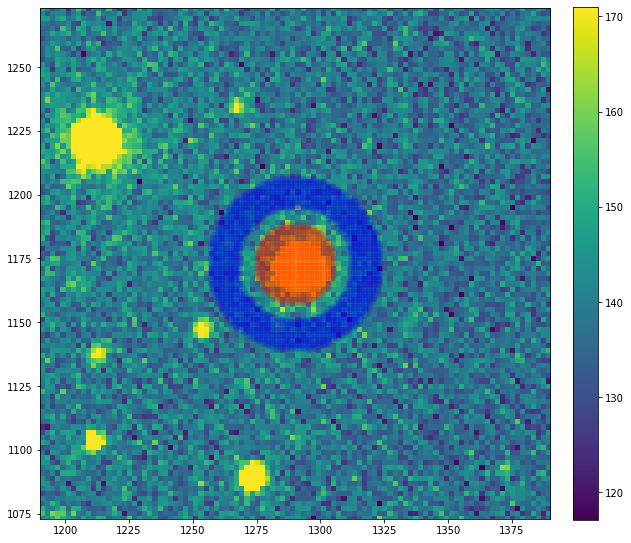

Annulus mean counts: 140.98
Aperture mean counts: 629.19
Source Rate: 32262.59 photons s^-1
Source Rate: 2.157e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 9.789e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.02


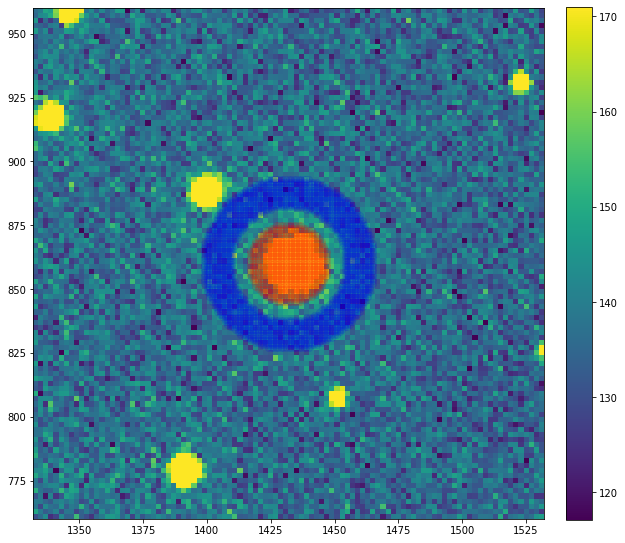

Annulus mean counts: 139.47
Aperture mean counts: 789.46
Source Rate: 42953.61 photons s^-1
Source Rate: 2.872e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.303e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.71


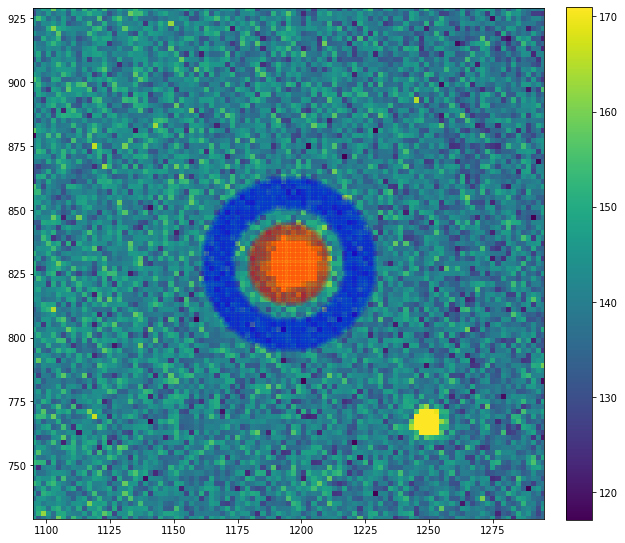

Annulus mean counts: 142.45
Aperture mean counts: 487.33
Source Rate: 22790.42 photons s^-1
Source Rate: 1.524e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 6.915e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.40


In [735]:
centers=[[1040,837],[1033,892],[1210,1097],[1220,1210],[1173,1290],[860,1432],[829,1195]]

image=images[24,:,:]
t=30 #seconds
#info for B bandpass
bandwidth=900 #angstroms
WL_eff=4380 #angstroms
flux_zeropoint=632e-11 # erg s^-1 cm^-2 A^-1

airmasses[24]=2.19

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[24,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

## V Band

/Users/dabbiecm/Imaging/a086.fits


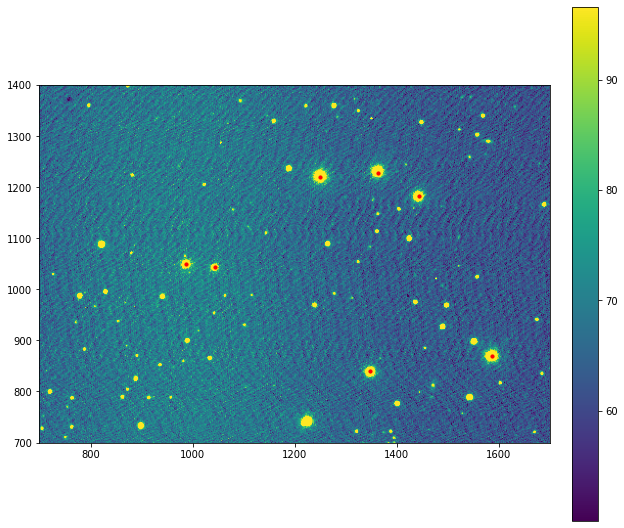

In [745]:
print(PG1633_names[5])
image=images[5,:,:] # this is V band, 10 s exposure, X=1.18

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(987,1050,c='r',s=10) #PG 1633+099
plt.scatter(1044,1043,c='r',s=10) #A
plt.scatter(1249,1220,c='r',s=10) #B
plt.scatter(1364,1228,c='r',s=10) #C
plt.scatter(1443,1182,c='r',s=10) #D
plt.scatter(1586,870,c='r',s=10) #E
plt.scatter(1347,840,c='r',s=10) #F

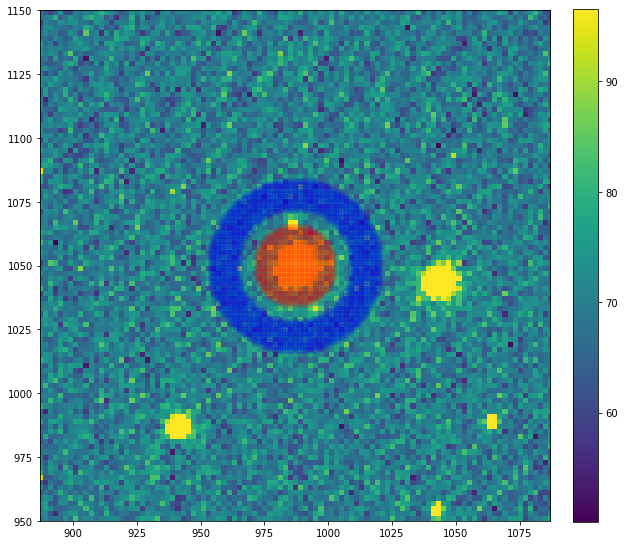

Annulus mean counts: 71.15
Aperture mean counts: 272.32
Source Rate: 39881.83 photons s^-1
Source Rate: 2.823e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.030e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.37


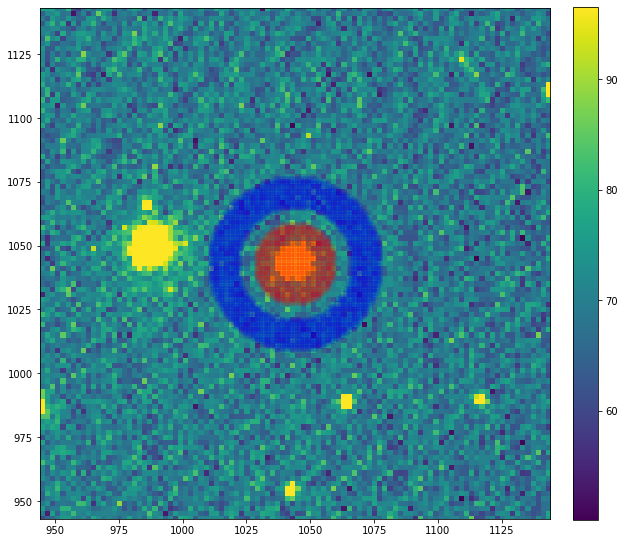

Annulus mean counts: 70.24
Aperture mean counts: 155.56
Source Rate: 16915.21 photons s^-1
Source Rate: 1.197e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 4.367e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.30


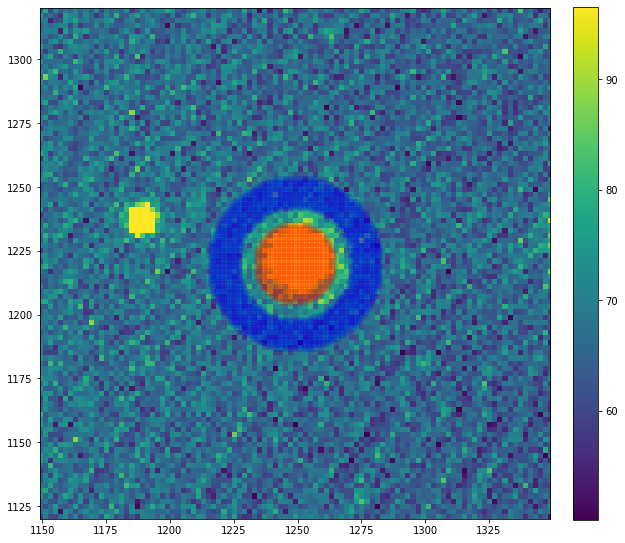

Annulus mean counts: 69.18
Aperture mean counts: 753.63
Source Rate: 135690.54 photons s^-1
Source Rate: 9.606e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.503e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.04


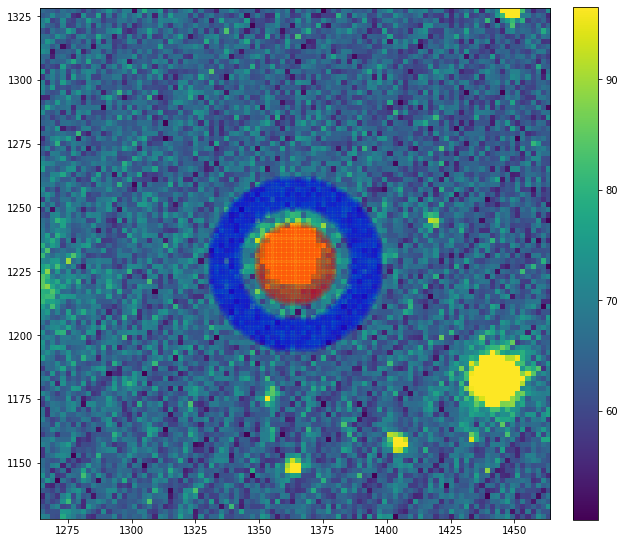

Annulus mean counts: 67.02
Aperture mean counts: 606.03
Source Rate: 106858.51 photons s^-1
Source Rate: 7.565e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.759e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.30


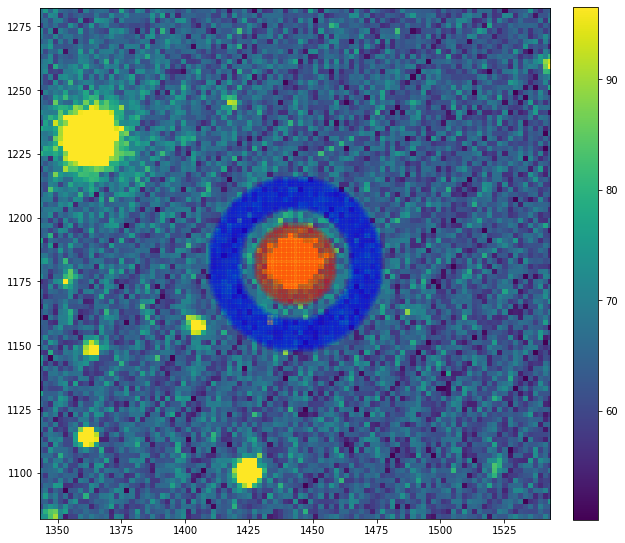

Annulus mean counts: 65.41
Aperture mean counts: 432.59
Source Rate: 72794.80 photons s^-1
Source Rate: 5.153e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.880e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.71


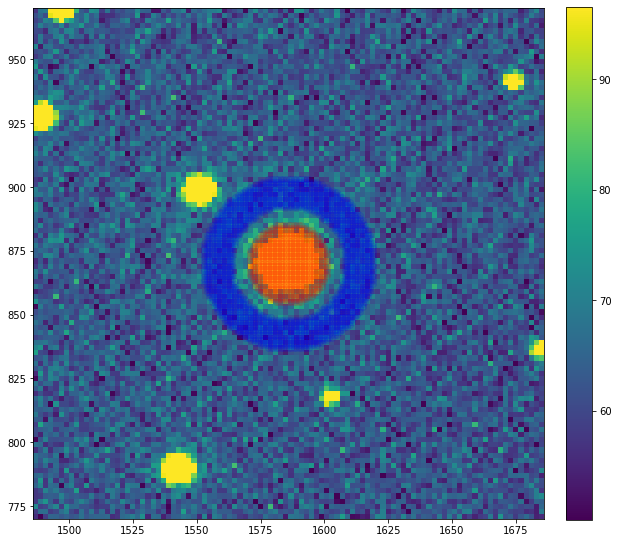

Annulus mean counts: 65.84
Aperture mean counts: 672.37
Source Rate: 120244.66 photons s^-1
Source Rate: 8.512e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.105e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.17


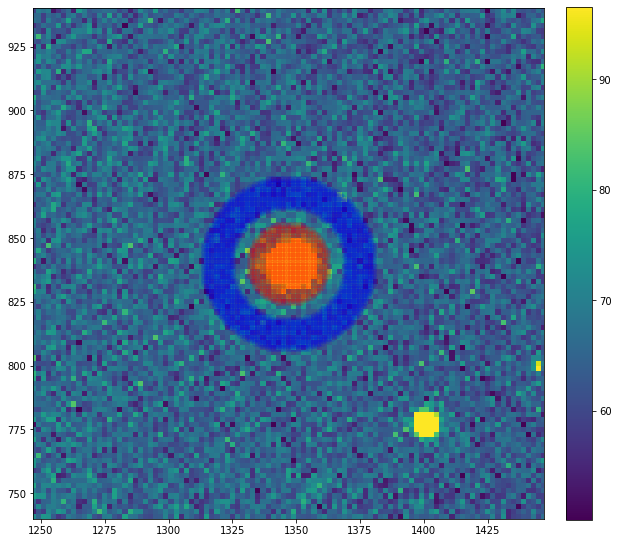

Annulus mean counts: 66.08
Aperture mean counts: 398.12
Source Rate: 65827.50 photons s^-1
Source Rate: 4.660e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.700e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.82


In [746]:
centers=[[1050,987],[1043,1044],[1220,1249],[1228,1364],[1182,1443],[870,1586],[840,1347]]

image=images[5,:,:]
t=10 #seconds
#info for V bandpass
bandwidth=850 #angstroms
WL_eff=5450 #angstroms
flux_zeropoint=363.1e-11 # erg s^-1 cm^-2 A^-1

airmasses[5]=1.18

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[5,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a206.fits


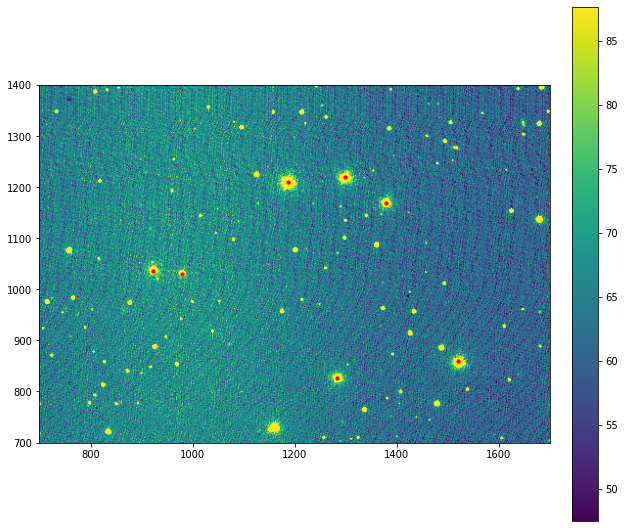

In [750]:
print(PG1633_names[16])
image=images[16,:,:] # this is V band, 10 s exposure, X=1.52

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(922,1036,c='r',s=10) #PG 1633+099
plt.scatter(980,1030,c='r',s=10) #A
plt.scatter(1186,1210,c='r',s=10) #B
plt.scatter(1298,1220,c='r',s=10) #C
plt.scatter(1378,1170,c='r',s=10) #D
plt.scatter(1520,860,c='r',s=10) #E
plt.scatter(1282,827,c='r',s=10) #F

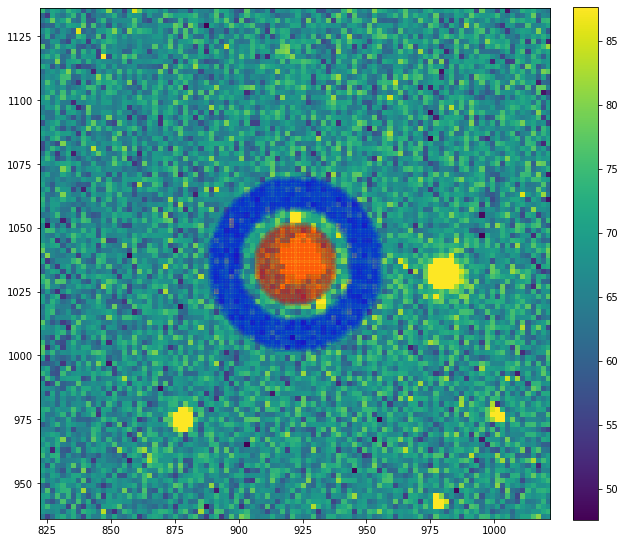

Annulus mean counts: 68.60
Aperture mean counts: 262.36
Source Rate: 38413.49 photons s^-1
Source Rate: 2.719e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 9.918e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.41


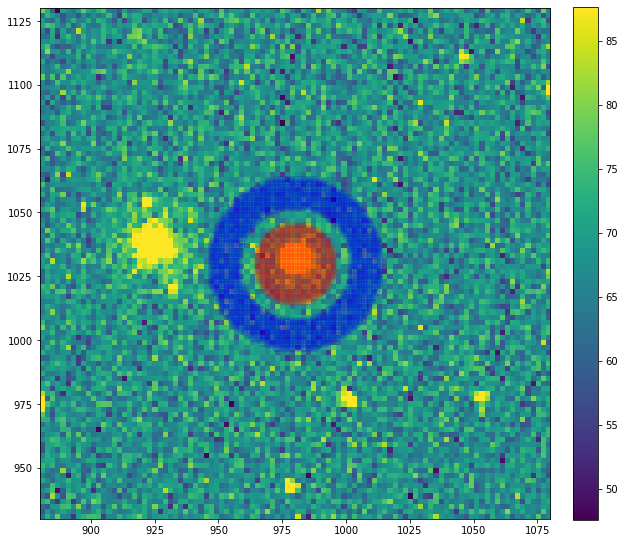

Annulus mean counts: 68.59
Aperture mean counts: 149.98
Source Rate: 16135.62 photons s^-1
Source Rate: 1.142e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 4.166e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.35


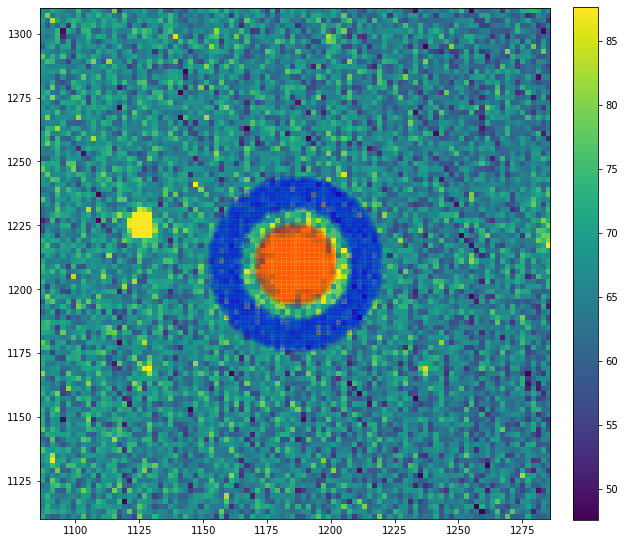

Annulus mean counts: 68.18
Aperture mean counts: 722.21
Source Rate: 129661.71 photons s^-1
Source Rate: 9.179e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.348e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.09


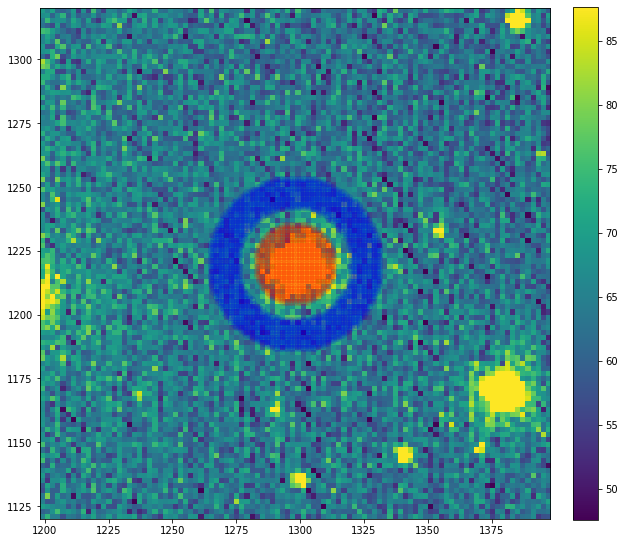

Annulus mean counts: 65.82
Aperture mean counts: 581.83
Source Rate: 102298.35 photons s^-1
Source Rate: 7.242e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.641e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.35


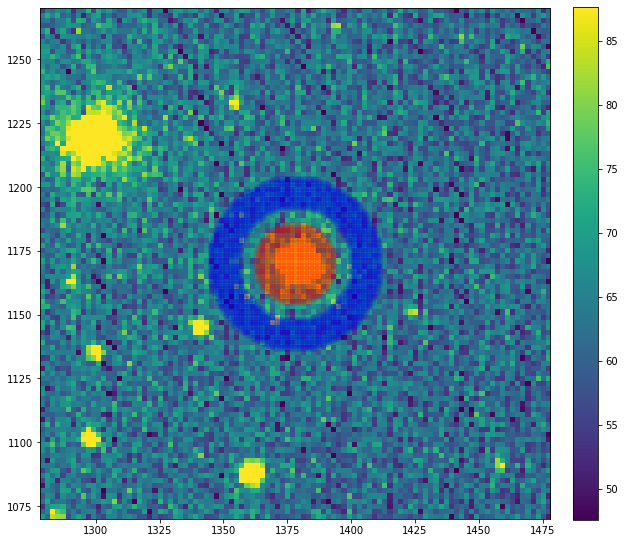

Annulus mean counts: 64.05
Aperture mean counts: 415.45
Source Rate: 69665.27 photons s^-1
Source Rate: 4.932e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.799e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.76


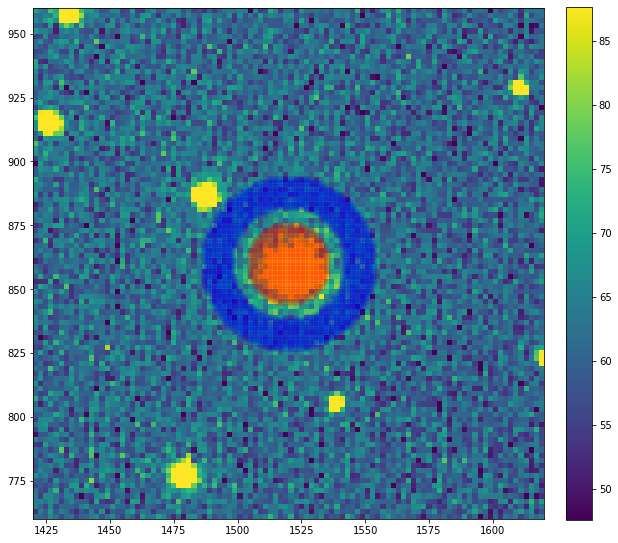

Annulus mean counts: 63.64
Aperture mean counts: 644.52
Source Rate: 115160.01 photons s^-1
Source Rate: 8.152e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.973e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.22


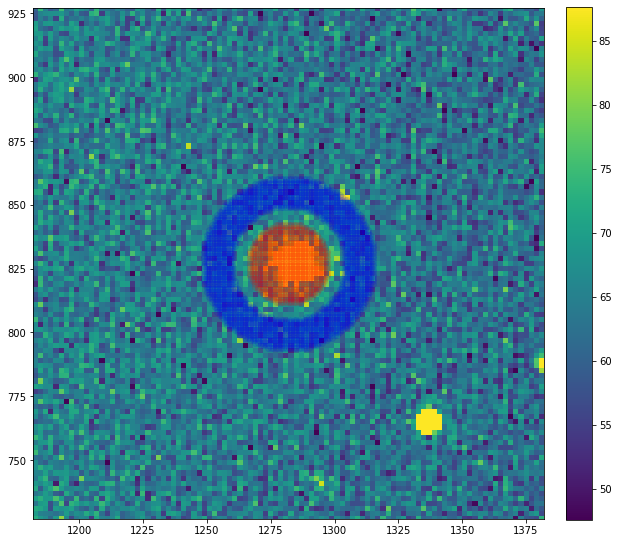

Annulus mean counts: 65.42
Aperture mean counts: 383.77
Source Rate: 63113.73 photons s^-1
Source Rate: 4.468e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.630e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.87


In [752]:
centers=[[1036,922],[1030,980],[1210,1186],[1220,1298],[1170,1378],[860,1520],[827,1282]]

image=images[16,:,:]
t=10 #seconds
#info for V bandpass
bandwidth=850 #angstroms
WL_eff=5450 #angstroms
flux_zeropoint=363.1e-11 # erg s^-1 cm^-2 A^-1

airmasses[16]=1.52

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[16,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a241.fits


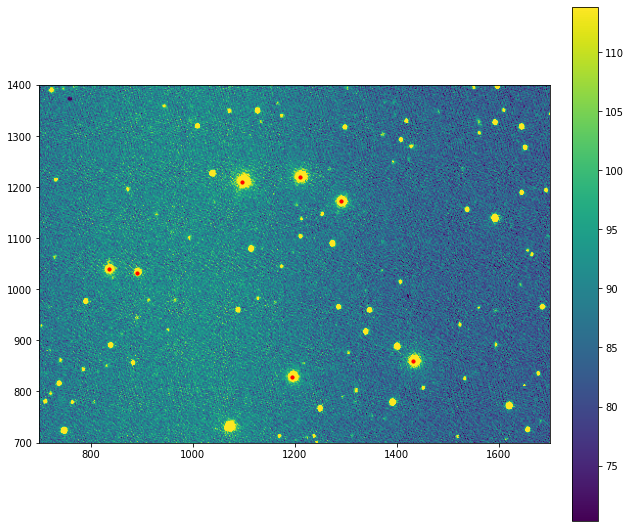

In [757]:
print(PG1633_names[26])
image=images[26,:,:] # this is V band, 10 s exposure, X=2.21

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(837,1040,c='r',s=10) #PG 1633+099
plt.scatter(892,1033,c='r',s=10) #A
plt.scatter(1097,1210,c='r',s=10) #B
plt.scatter(1210,1220,c='r',s=10) #C
plt.scatter(1290,1173,c='r',s=10) #D
plt.scatter(1432,860,c='r',s=10) #E
plt.scatter(1195,829,c='r',s=10) #F

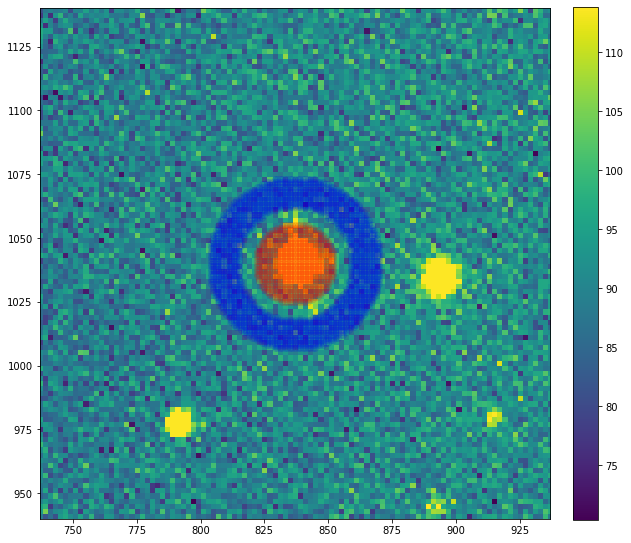

Annulus mean counts: 91.41
Aperture mean counts: 266.93
Source Rate: 34797.12 photons s^-1
Source Rate: 2.463e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 8.985e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.52


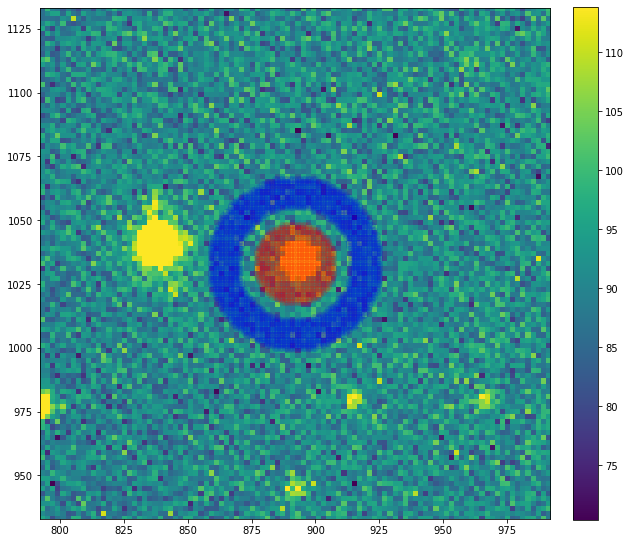

Annulus mean counts: 91.44
Aperture mean counts: 164.69
Source Rate: 14522.36 photons s^-1
Source Rate: 1.028e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.750e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.47


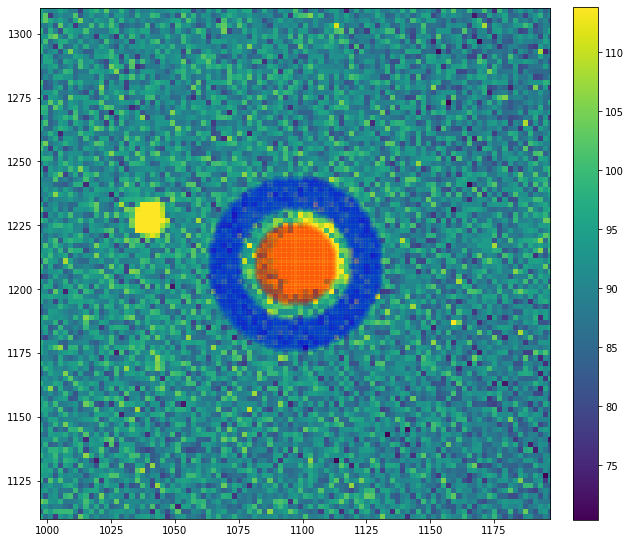

Annulus mean counts: 94.48
Aperture mean counts: 688.95
Source Rate: 117854.88 photons s^-1
Source Rate: 8.343e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.043e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.19


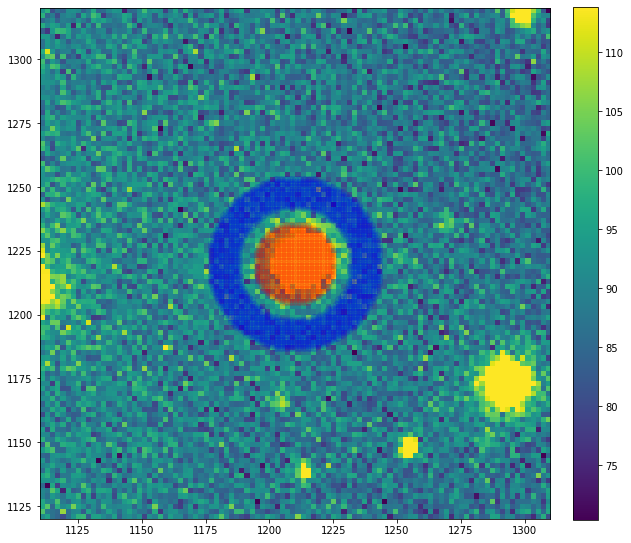

Annulus mean counts: 91.24
Aperture mean counts: 557.40
Source Rate: 92416.11 photons s^-1
Source Rate: 6.542e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.386e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.46


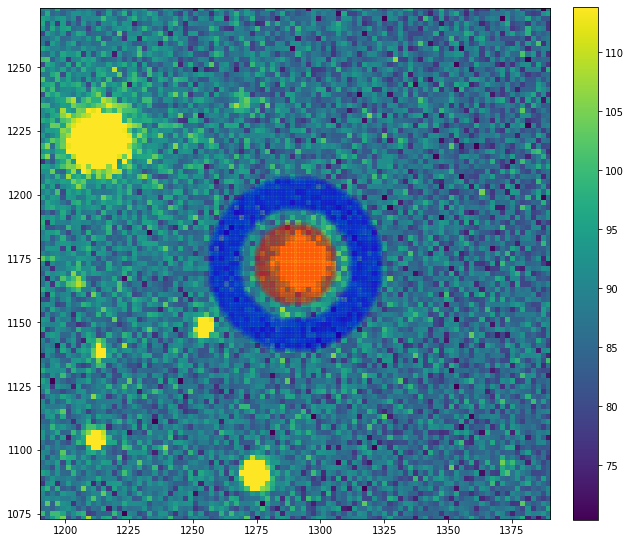

Annulus mean counts: 88.71
Aperture mean counts: 404.75
Source Rate: 62655.36 photons s^-1
Source Rate: 4.435e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.618e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.88


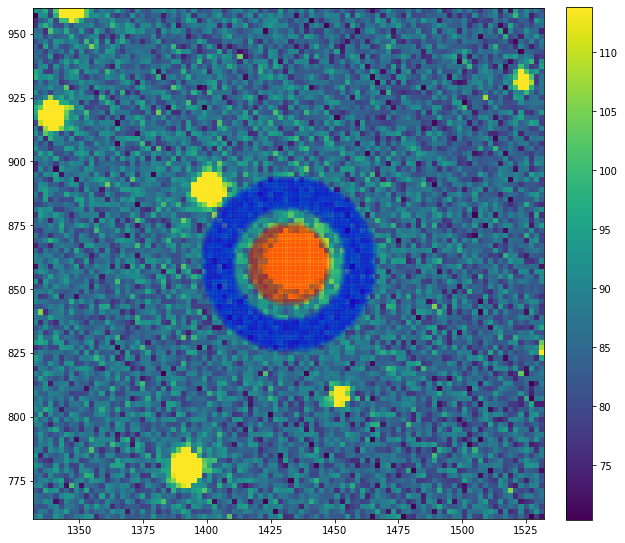

Annulus mean counts: 88.37
Aperture mean counts: 613.65
Source Rate: 104137.37 photons s^-1
Source Rate: 7.372e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.689e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.33


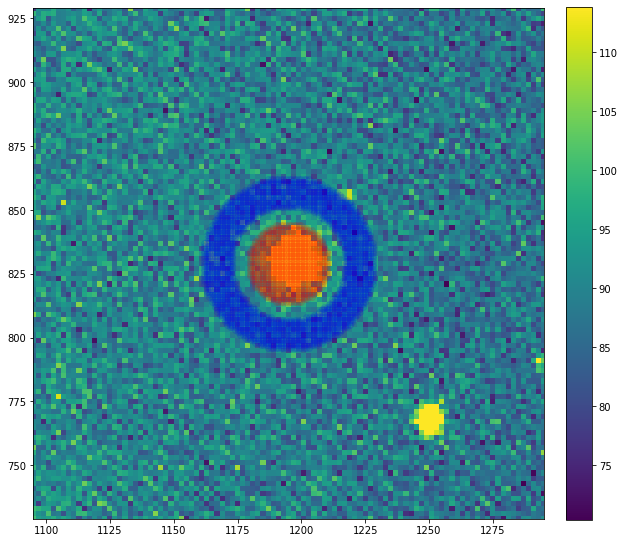

Annulus mean counts: 90.29
Aperture mean counts: 377.18
Source Rate: 56875.16 photons s^-1
Source Rate: 4.026e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.469e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.98


In [758]:
centers=[[1040,837],[1033,892],[1210,1097],[1220,1210],[1173,1290],[860,1432],[829,1195]]

image=images[26,:,:]
t=10 #seconds
#info for V bandpass
bandwidth=850 #angstroms
WL_eff=5450 #angstroms
flux_zeropoint=363.1e-11 # erg s^-1 cm^-2 A^-1

airmasses[26]=2.21

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[26,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

## R Band

/Users/dabbiecm/Imaging/a087.fits


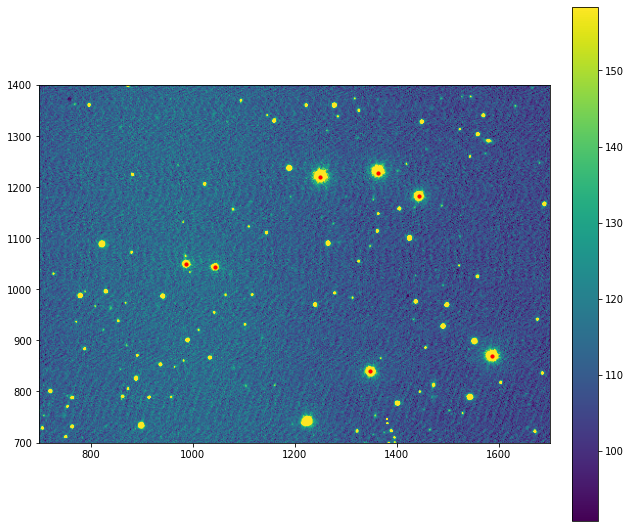

In [761]:
print(PG1633_names[6])
image=images[6,:,:] # this is R band, 10 s exposure, X=1.18

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(987,1050,c='r',s=10) #PG 1633+099
plt.scatter(1044,1043,c='r',s=10) #A
plt.scatter(1249,1220,c='r',s=10) #B
plt.scatter(1364,1228,c='r',s=10) #C
plt.scatter(1443,1182,c='r',s=10) #D
plt.scatter(1586,870,c='r',s=10) #E
plt.scatter(1347,840,c='r',s=10) #F

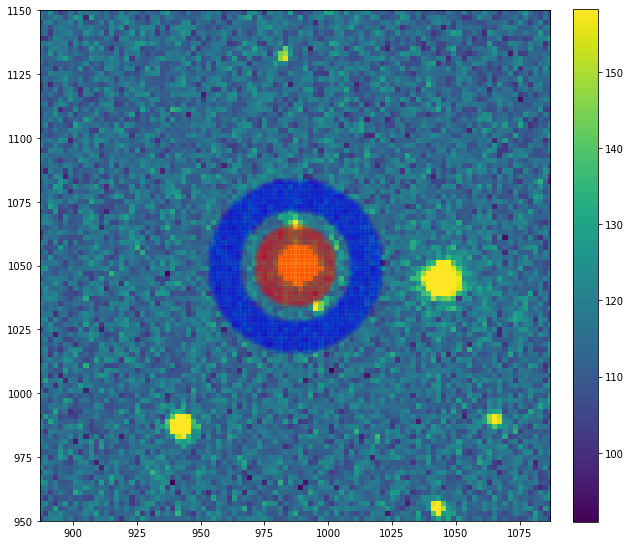

Annulus mean counts: 116.21
Aperture mean counts: 306.23
Source Rate: 37671.66 photons s^-1
Source Rate: 1.511e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 4.686e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.67


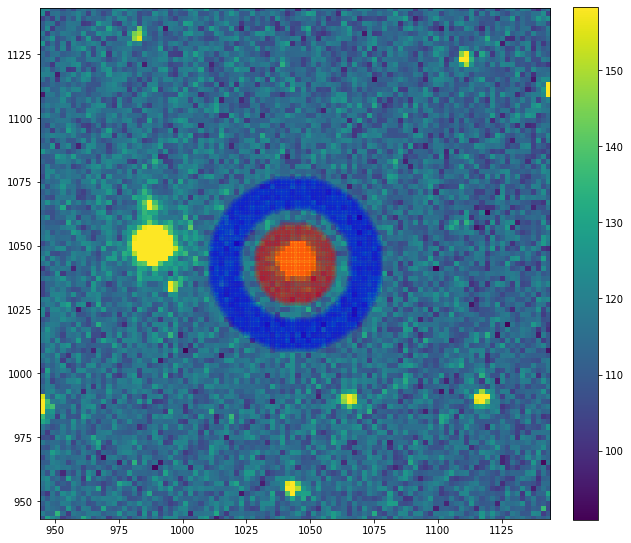

Annulus mean counts: 115.67
Aperture mean counts: 253.18
Source Rate: 27260.62 photons s^-1
Source Rate: 1.094e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 3.391e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.02


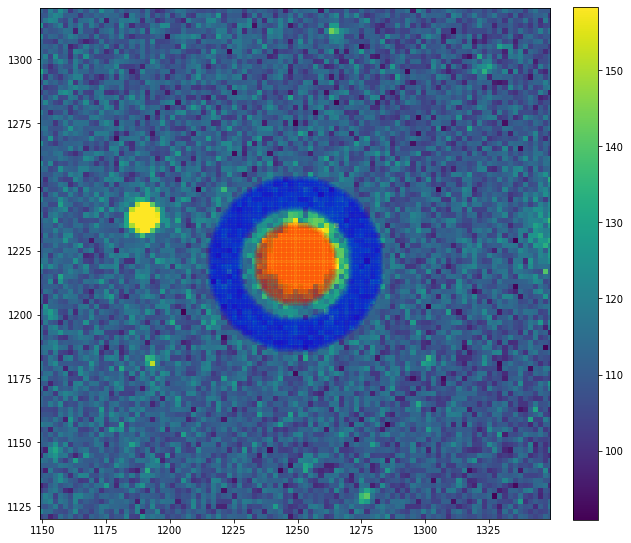

Annulus mean counts: 115.96
Aperture mean counts: 1318.02
Source Rate: 238308.50 photons s^-1
Source Rate: 9.560e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.965e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.66


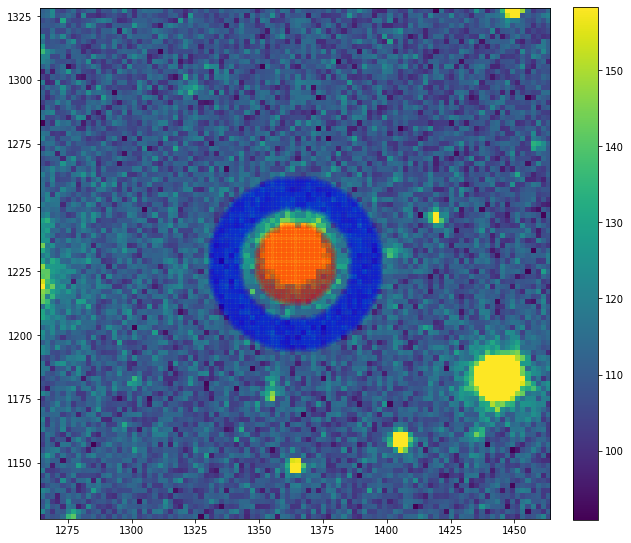

Annulus mean counts: 113.41
Aperture mean counts: 1085.16
Source Rate: 192649.53 photons s^-1
Source Rate: 7.728e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.397e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.90


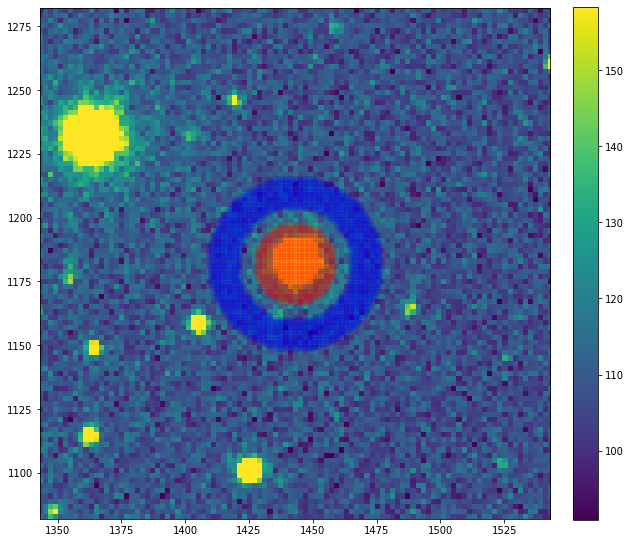

Annulus mean counts: 110.55
Aperture mean counts: 613.11
Source Rate: 99632.54 photons s^-1
Source Rate: 3.997e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.239e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.61


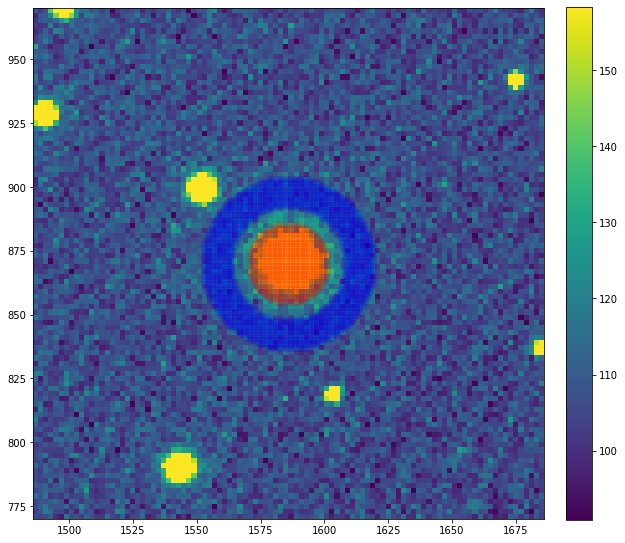

Annulus mean counts: 111.62
Aperture mean counts: 1078.65
Source Rate: 191712.49 photons s^-1
Source Rate: 7.690e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.385e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.90


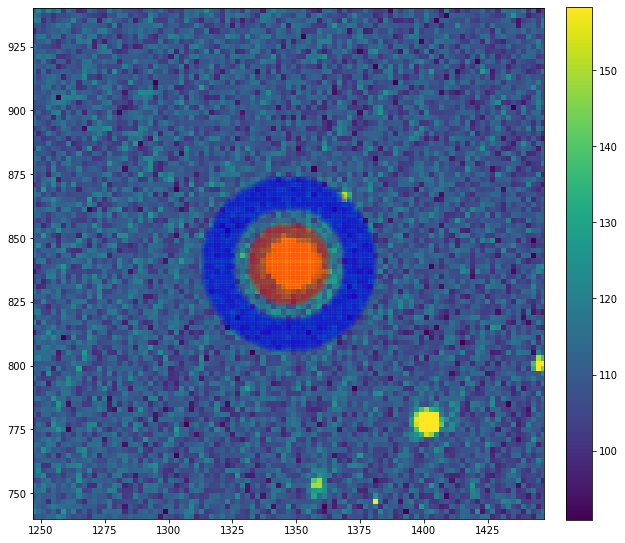

Annulus mean counts: 111.56
Aperture mean counts: 655.01
Source Rate: 107738.53 photons s^-1
Source Rate: 4.322e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.340e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.53


In [762]:
centers=[[1050,987],[1043,1044],[1220,1249],[1228,1364],[1182,1443],[870,1586],[840,1347]]

image=images[6,:,:]
t=10 #seconds
#info for R bandpass
bandwidth=1500 #angstroms
WL_eff=6410 #angstroms
flux_zeropoint=217.7e-11 # erg s^-1 cm^-2 A^-1

airmasses[6]=1.18

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[6,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a208.fits


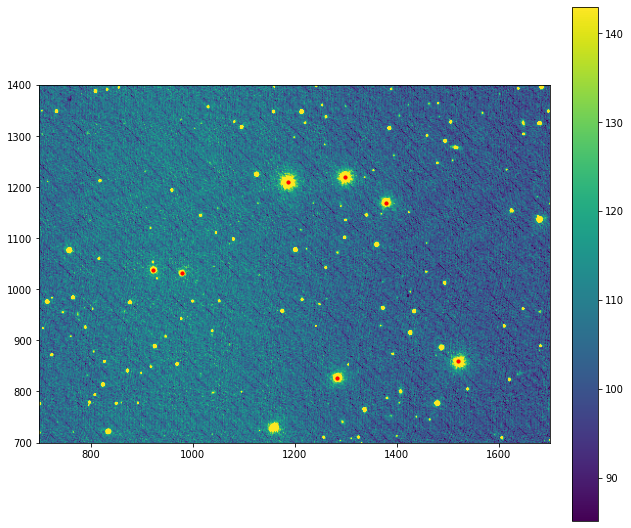

In [769]:
print(PG1633_names[18])
image=images[18,:,:] # this is R band, 10 s exposure, X=1.53

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(922,1038,c='r',s=10) #PG 1633+099
plt.scatter(980,1032,c='r',s=10) #A
plt.scatter(1186,1210,c='r',s=10) #B
plt.scatter(1298,1220,c='r',s=10) #C
plt.scatter(1378,1170,c='r',s=10) #D
plt.scatter(1520,860,c='r',s=10) #E
plt.scatter(1282,827,c='r',s=10) #F

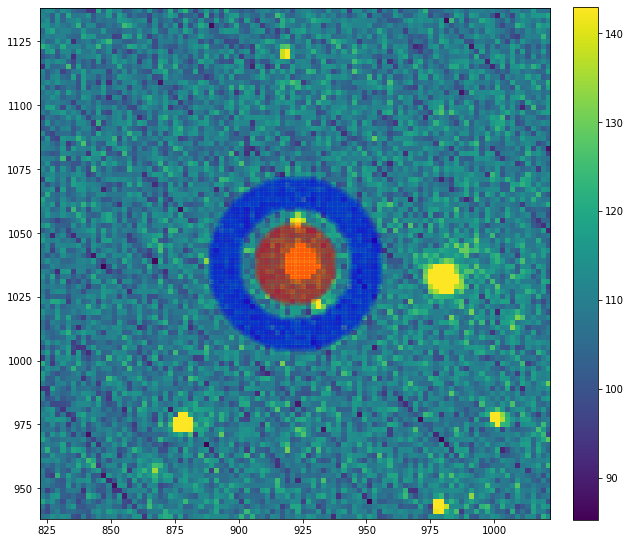

Annulus mean counts: 110.48
Aperture mean counts: 294.64
Source Rate: 36509.01 photons s^-1
Source Rate: 1.465e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 4.542e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.70


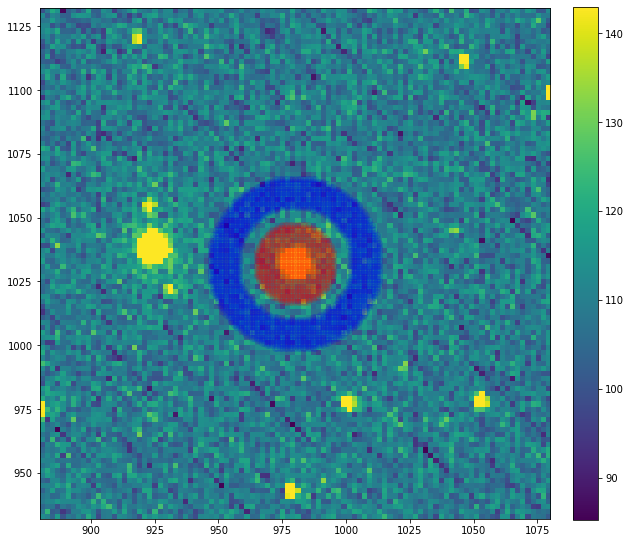

Annulus mean counts: 110.60
Aperture mean counts: 242.72
Source Rate: 26191.62 photons s^-1
Source Rate: 1.051e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 3.258e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.06


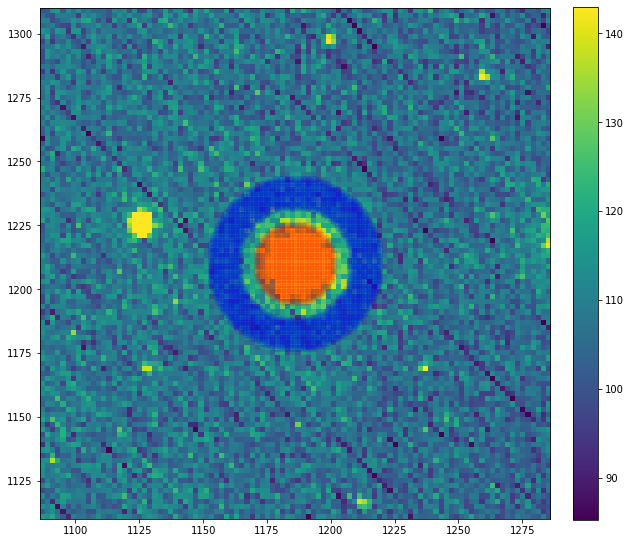

Annulus mean counts: 112.70
Aperture mean counts: 1265.40
Source Rate: 228523.69 photons s^-1
Source Rate: 9.167e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.843e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.71


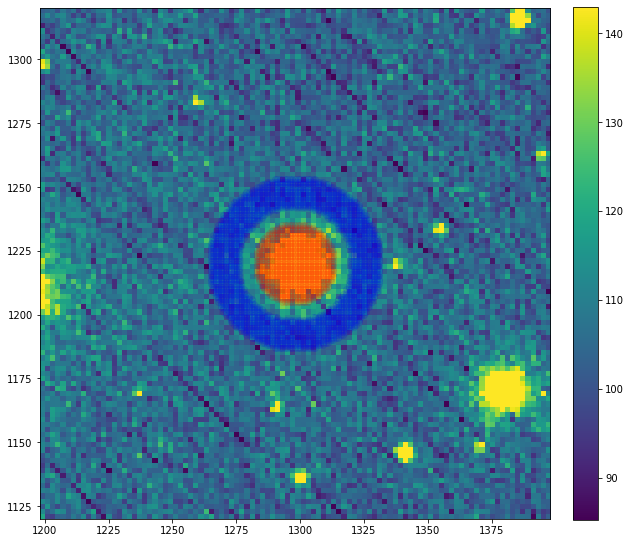

Annulus mean counts: 108.51
Aperture mean counts: 1048.33
Source Rate: 186318.91 photons s^-1
Source Rate: 7.474e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.318e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.93


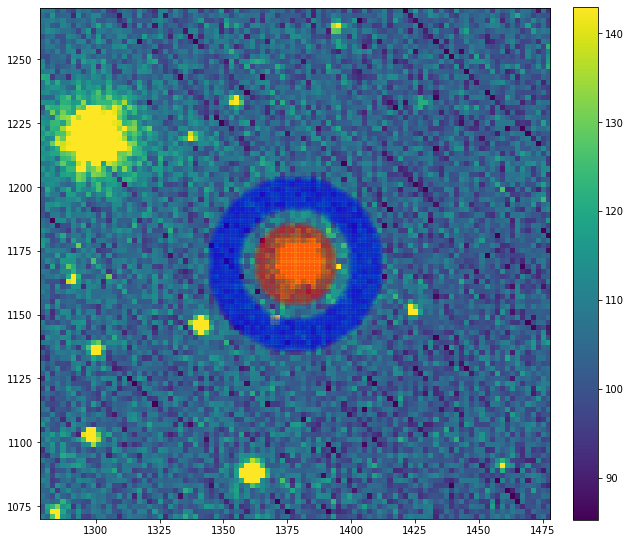

Annulus mean counts: 105.97
Aperture mean counts: 595.17
Source Rate: 96982.77 photons s^-1
Source Rate: 3.890e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.206e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.64


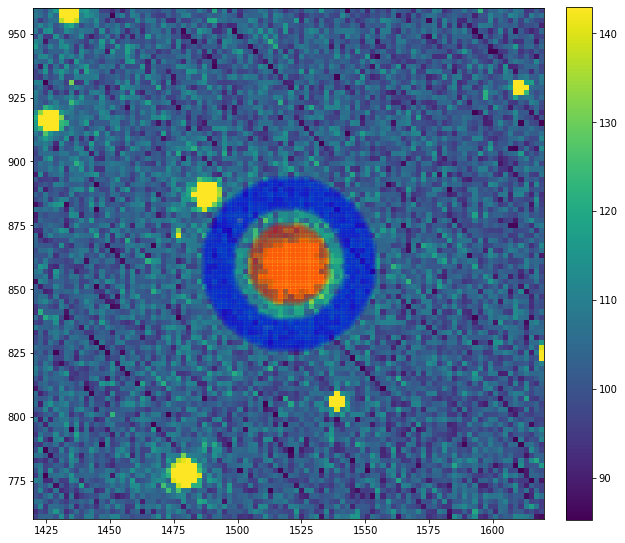

Annulus mean counts: 107.00
Aperture mean counts: 1039.00
Source Rate: 184769.25 photons s^-1
Source Rate: 7.412e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.299e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.94


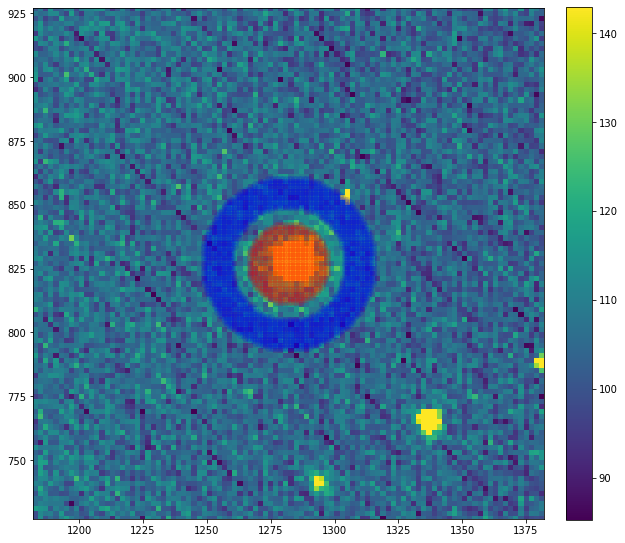

Annulus mean counts: 107.37
Aperture mean counts: 638.16
Source Rate: 105228.73 photons s^-1
Source Rate: 4.221e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.309e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.55


In [770]:
centers=[[1038,922],[1032,980],[1210,1186],[1220,1298],[1170,1378],[860,1520],[827,1282]]

image=images[18,:,:]
t=10 #seconds
#info for R bandpass
bandwidth=1500 #angstroms
WL_eff=6410 #angstroms
flux_zeropoint=217.7e-11 # erg s^-1 cm^-2 A^-1

airmasses[18]=1.53

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[18,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

/Users/dabbiecm/Imaging/a243.fits


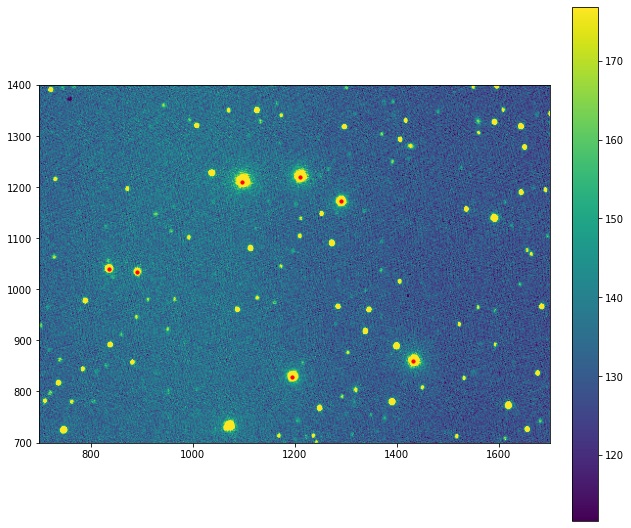

In [775]:
print(PG1633_names[28])
image=images[28,:,:] # this is R band, 10 s exposure, X=2.23

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(837,1040,c='r',s=10) #PG 1633+099
plt.scatter(892,1035,c='r',s=10) #A
plt.scatter(1097,1210,c='r',s=10) #B
plt.scatter(1210,1220,c='r',s=10) #C
plt.scatter(1290,1173,c='r',s=10) #D
plt.scatter(1432,860,c='r',s=10) #E
plt.scatter(1195,829,c='r',s=10) #F

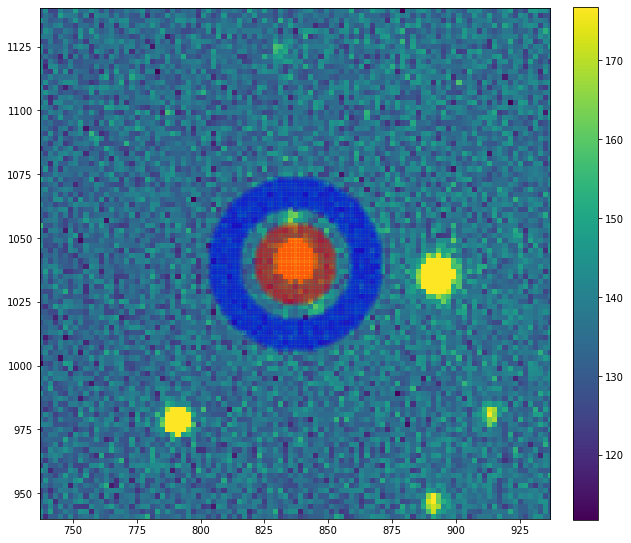

Annulus mean counts: 136.88
Aperture mean counts: 306.21
Source Rate: 33570.88 photons s^-1
Source Rate: 1.347e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 4.176e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 16.79


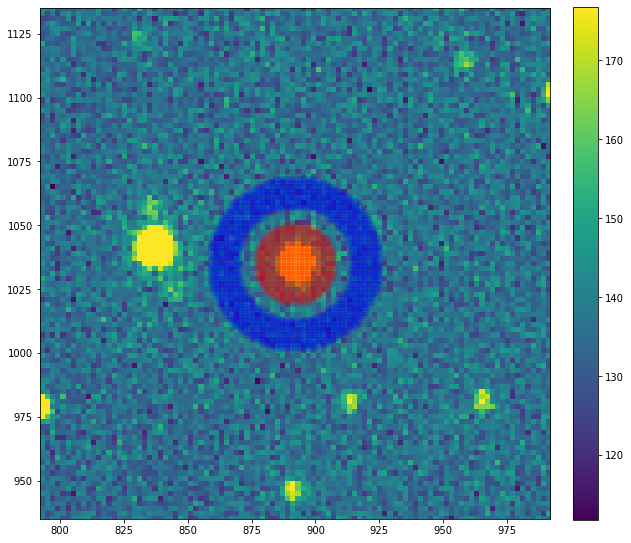

Annulus mean counts: 136.93
Aperture mean counts: 257.80
Source Rate: 23962.50 photons s^-1
Source Rate: 9.612e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.981e-16 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 17.16


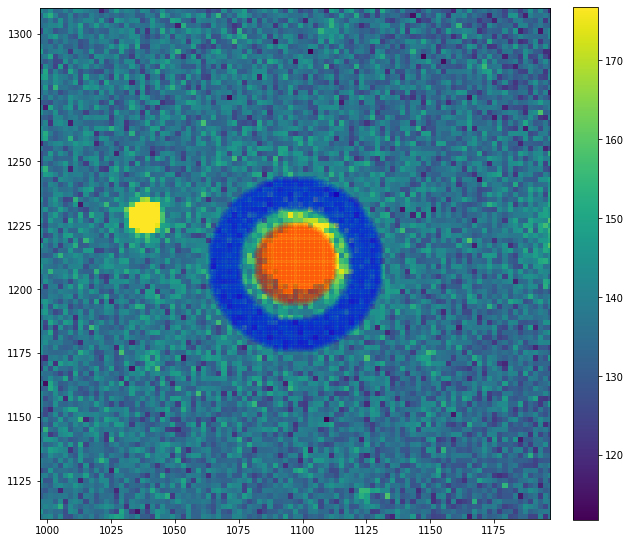

Annulus mean counts: 142.42
Aperture mean counts: 1209.64
Source Rate: 211577.15 photons s^-1
Source Rate: 8.487e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.632e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 14.79


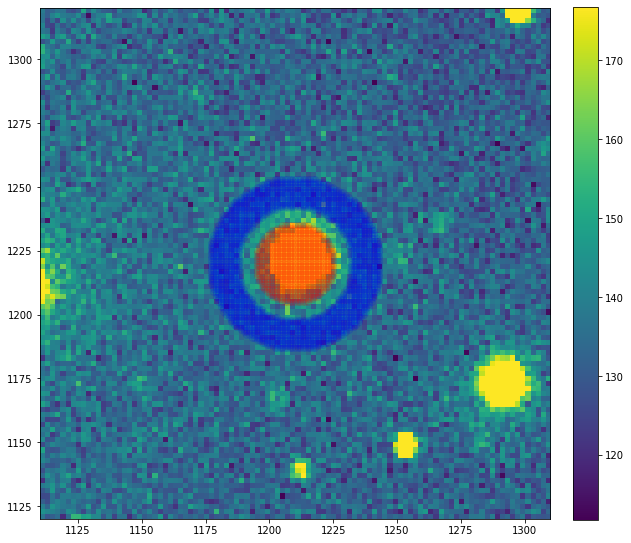

Annulus mean counts: 138.43
Aperture mean counts: 1000.92
Source Rate: 170989.24 photons s^-1
Source Rate: 6.859e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.127e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.03


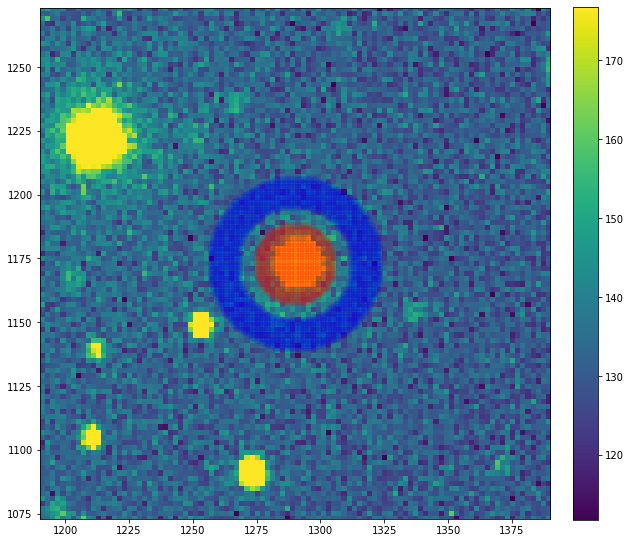

Annulus mean counts: 134.64
Aperture mean counts: 576.77
Source Rate: 87651.32 photons s^-1
Source Rate: 3.516e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.090e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.75


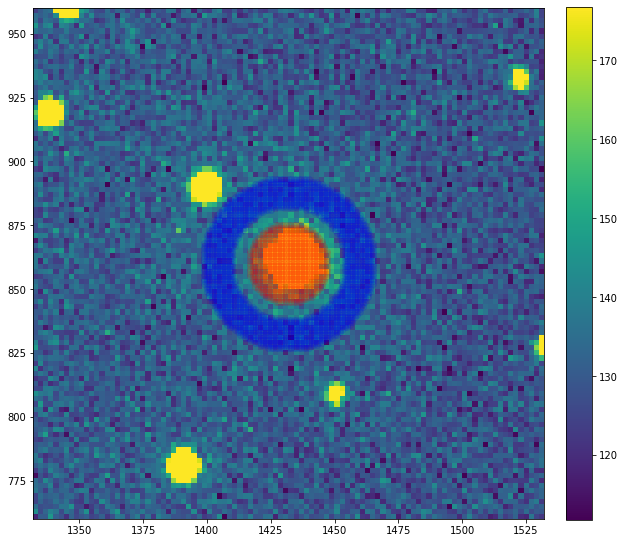

Annulus mean counts: 135.34
Aperture mean counts: 999.86
Source Rate: 171391.48 photons s^-1
Source Rate: 6.875e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 2.132e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.02


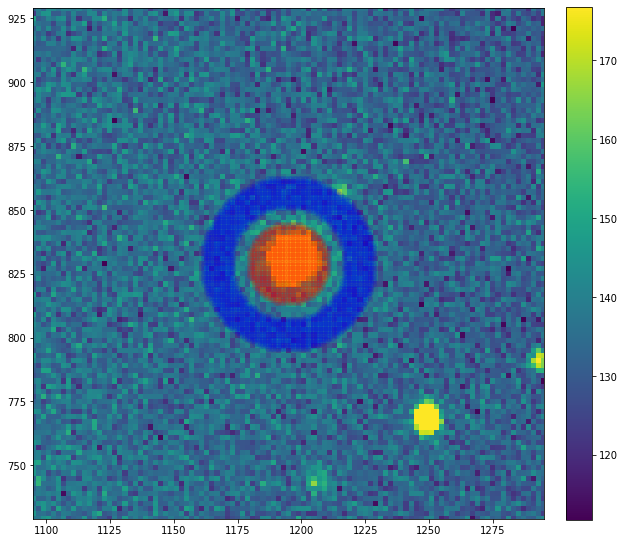

Annulus mean counts: 136.60
Aperture mean counts: 615.21
Source Rate: 94885.23 photons s^-1
Source Rate: 3.806e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.101e-12 ergs photon^-1
Source Rate: 1.180e-15 erg s^-1 cm^-2 A^-1
Instrumental Magnitude: 15.66


In [776]:
centers=[[1040,837],[1035,892],[1210,1097],[1220,1210],[1173,1290],[860,1432],[829,1195]]

image=images[28,:,:]
t=10 #seconds
#info for R bandpass
bandwidth=1500 #angstroms
WL_eff=6410 #angstroms
flux_zeropoint=217.7e-11 # erg s^-1 cm^-2 A^-1

airmasses[28]=2.23

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint)
    inst_mags[28,i]=mag
    print("Instrumental Magnitude: {:.2f}".format(mag))

6. Plot your standard star instrumental magnitudes versus their airmass (or since you have many different standard stars taken at different airmass, plot the difference between the accepted magnitude and your instrumental magnitude versus airmass). Use one of the linear fitting routines in Python to do a least squares fit to find and plot the extinction coefficients at each filter. You can find their magnitudes and colors in Landolt (1992).

![title](PG1633_values.png)

## U band

In [568]:
U_inst_mags=np.zeros(shape=(3,7))
U_inst_mags[0,:]=inst_mags[1,:]
U_inst_mags[1,:]=inst_mags[12,:]
U_inst_mags[2,:]=inst_mags[22,:]

U_airmasses=[airmasses[1],airmasses[12],airmasses[22]]


U_standard_mags=[14.396-0.191-0.990,
                 15.259+0.871+0.305,
                 12.968+1.081+1.017,
                 13.224+1.144+1.146,
                 13.689+0.535-0.021,
                 13.113+0.841+0.337,
                 13.768+0.878+0.254]

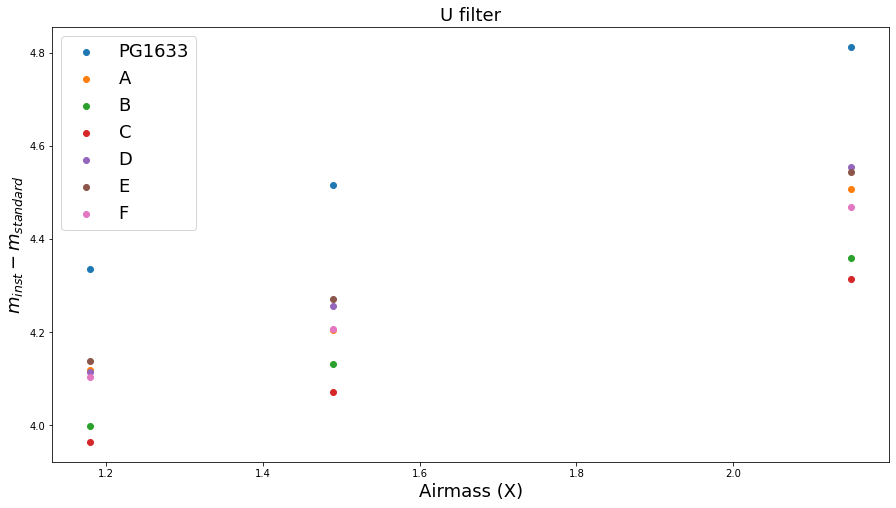

In [573]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=U_inst_mags[:,i]-U_standard_mags[i]
    plt.scatter(U_airmasses,diff_arry,label=labels[i])
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('U filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

In [789]:
x=np.zeros(7*3)
x[:7]=U_airmasses[0]
x[7:14]=U_airmasses[1]
x[14:]=U_airmasses[2]

y=np.zeros(7*3)
for i in range(7):
    y[i]=U_inst_mags[0,i]-U_standard_mags[i]
for i in range(7):
    y[7+i]=U_inst_mags[1,i]-U_standard_mags[i]
for i in range(7):
    y[14+i]=U_inst_mags[2,i]-U_standard_mags[i]
    
print(y)
    
extinct_coeff_U,intercept_U=np.polyfit(x,y,deg=1)

[4.33502908 4.1181394  3.99788345 3.96448091 4.11472043 4.13789658
 4.10503325 4.51518937 4.20552101 4.13200926 4.07228314 4.25589067
 4.27081793 4.20737254 4.81249888 4.50679575 4.36014278 4.31516278
 4.55374462 4.54382563 4.46951738]


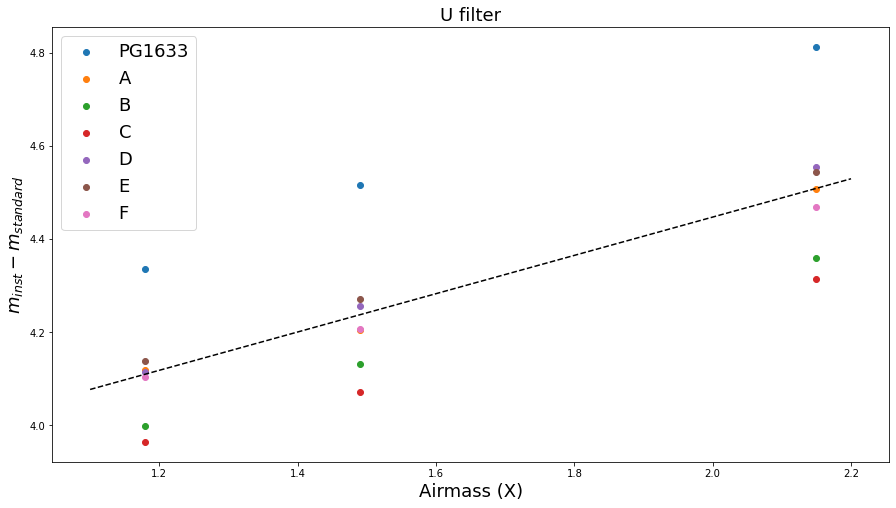

In [790]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=U_inst_mags[:,i]-U_standard_mags[i]
    plt.scatter(U_airmasses,diff_arry,label=labels[i])
    
index=np.asarray([1.1,1.6,2.2])
plt.plot(index,extinct_coeff_U*index+intercept_U,c='k',ls='--')
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('U filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

## B band
![title](PG1633_values.png)

In [791]:
B_inst_mags=np.zeros(shape=(3,7))
B_inst_mags[0,:]=inst_mags[2,:]
B_inst_mags[1,:]=inst_mags[14,:]
B_inst_mags[2,:]=inst_mags[24,:]

B_airmasses=[airmasses[2],airmasses[14],airmasses[24]]


B_standard_mags=[14.396-0.191,
                 15.259+0.871,
                 12.986+1.081,
                 13.224+1.144,
                 13.689+0.535,
                 13.113+0.841,
                 13.768+0.878]

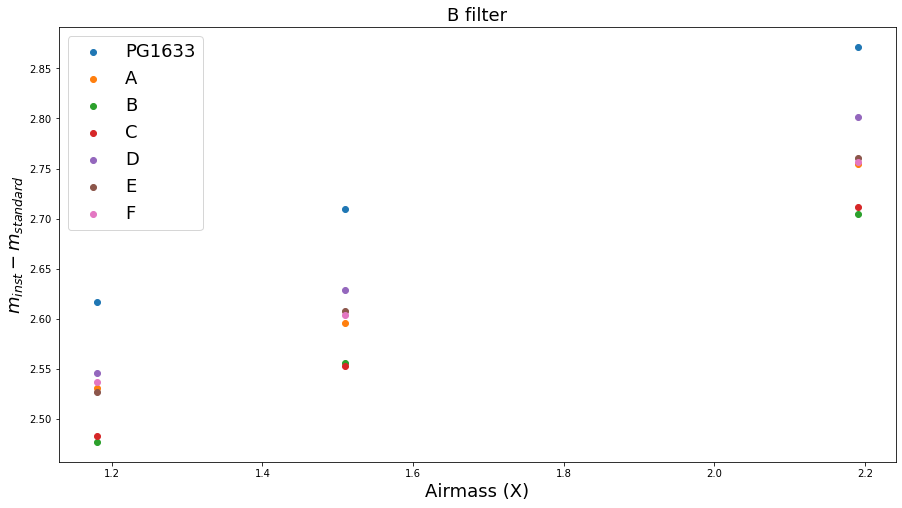

In [792]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=B_inst_mags[:,i]-B_standard_mags[i]
    plt.scatter(B_airmasses,diff_arry,label=labels[i])
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('B filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

In [793]:
x=np.zeros(7*3)
x[:7]=B_airmasses[0]
x[7:14]=B_airmasses[1]
x[14:]=B_airmasses[2]

y=np.zeros(7*3)
for i in range(7):
    y[i]=B_inst_mags[0,i]-B_standard_mags[i]
for i in range(7):
    y[7+i]=B_inst_mags[1,i]-B_standard_mags[i]
for i in range(7):
    y[14+i]=B_inst_mags[2,i]-B_standard_mags[i]
    
print(y)
    
extinct_coeff_B,intercept_B=np.polyfit(x,y,deg=1)

[2.61660741 2.53151362 2.47718683 2.48307644 2.54643127 2.52736681
 2.53682954 2.70922672 2.59599756 2.55565368 2.55256165 2.62916454
 2.6081195  2.60438831 2.87151911 2.75430616 2.70430055 2.7111199
 2.80091825 2.76016716 2.75628578]


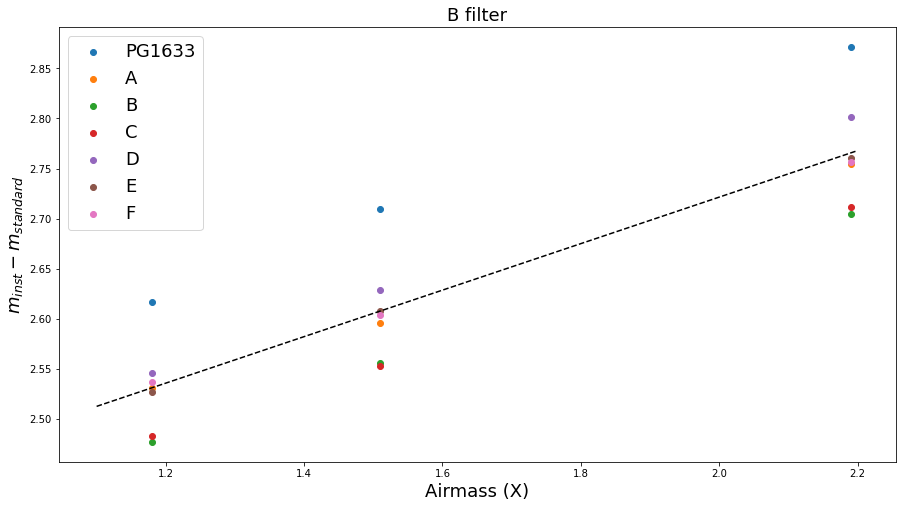

In [794]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=B_inst_mags[:,i]-B_standard_mags[i]
    plt.scatter(B_airmasses,diff_arry,label=labels[i])
    
index=np.asarray([1.1,1.6,2.2])
plt.plot(index,extinct_coeff_B*index+intercept_B,c='k',ls='--')
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('B filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

## V band

In [795]:
V_inst_mags=np.zeros(shape=(3,7))
V_inst_mags[0,:]=inst_mags[5,:]
V_inst_mags[1,:]=inst_mags[16,:]
V_inst_mags[2,:]=inst_mags[26,:]

V_airmasses=[airmasses[5],airmasses[16],airmasses[26]]


V_standard_mags=[14.396,
                 15.259,
                 12.986,
                 13.224,
                 13.689,
                 13.113,
                 13.768]

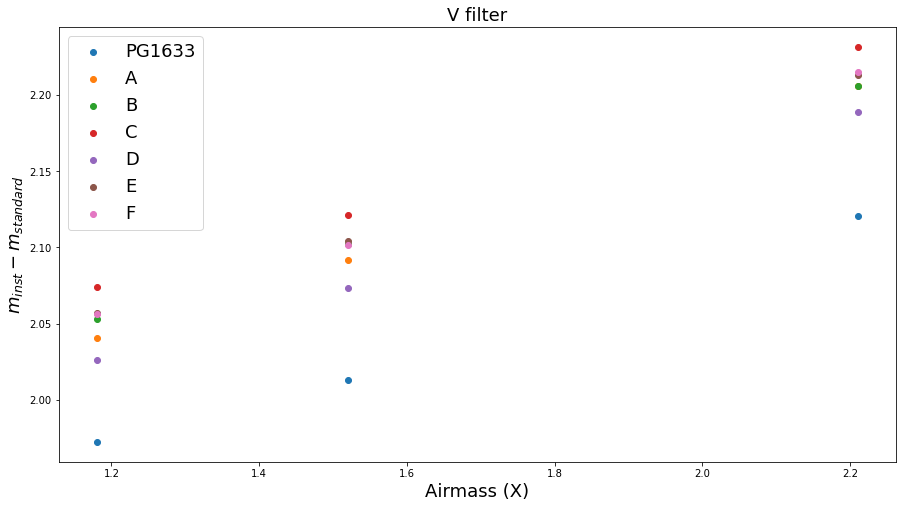

In [796]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=V_inst_mags[:,i]-V_standard_mags[i]
    plt.scatter(V_airmasses,diff_arry,label=labels[i])
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('V filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

In [797]:
x=np.zeros(7*3)
x[:7]=V_airmasses[0]
x[7:14]=V_airmasses[1]
x[14:]=V_airmasses[2]

y=np.zeros(7*3)
for i in range(7):
    y[i]=V_inst_mags[0,i]-V_standard_mags[i]
for i in range(7):
    y[7+i]=V_inst_mags[1,i]-V_standard_mags[i]
for i in range(7):
    y[14+i]=V_inst_mags[2,i]-V_standard_mags[i]
    
print(y)
    
extinct_coeff_V,intercept_V=np.polyfit(x,y,deg=1)

[1.97224866 2.04049291 2.05281244 2.07416359 2.02593547 2.05702184
 2.0561679  2.01297703 2.09172192 2.10215698 2.1215148  2.07364552
 2.10393208 2.10187678 2.12032816 2.20609343 2.20581737 2.23181713
 2.1887907  2.2131698  2.21487979]


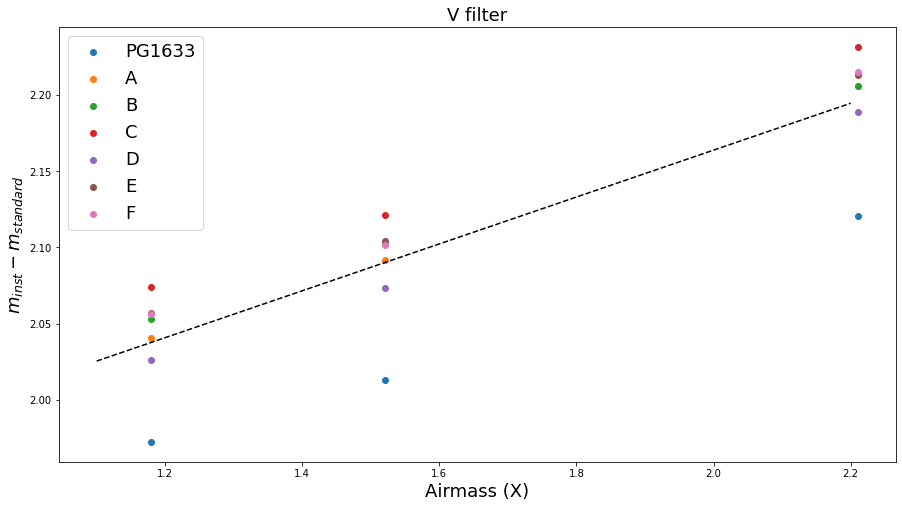

In [798]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=V_inst_mags[:,i]-V_standard_mags[i]
    plt.scatter(V_airmasses,diff_arry,label=labels[i])
    
index=np.asarray([1.1,1.6,2.2])
plt.plot(index,extinct_coeff_V*index+intercept_V,c='k',ls='--')
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('V filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

## R band
![title](PG1633_values.png)

In [799]:
R_inst_mags=np.zeros(shape=(3,7))
R_inst_mags[0,:]=inst_mags[6,:]
R_inst_mags[1,:]=inst_mags[18,:]
R_inst_mags[2,:]=inst_mags[28,:]

R_airmasses=[airmasses[6],airmasses[18],airmasses[28]]


R_standard_mags=[14.396-0.191-0.990-0.085,
                 15.259+0.871+0.305+0.506,
                 12.968+1.081+1.017+0.589,
                 13.224+1.144+1.146+0.612,
                 13.689+0.535-0.021+0.324,
                 13.113+0.841+0.337+0.484,
                 13.768+0.878+0.254+0.523]

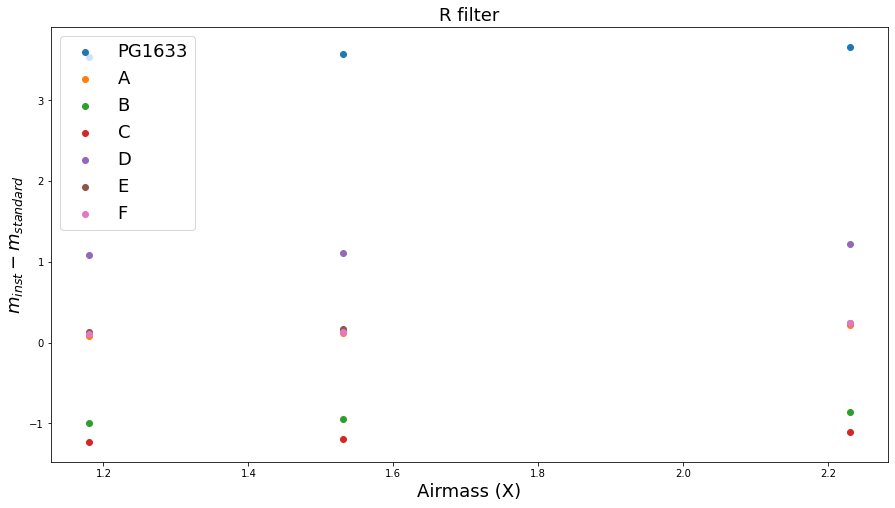

In [800]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=R_inst_mags[:,i]-R_standard_mags[i]
    plt.scatter(R_airmasses,diff_arry,label=labels[i])
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('R filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

In [801]:
x=np.zeros(7*3)
x[:7]=R_airmasses[0]
x[7:14]=R_airmasses[1]
x[14:]=R_airmasses[2]

y=np.zeros(7*3)
for i in range(7):
    y[i]=R_inst_mags[0,i]-R_standard_mags[i]
for i in range(7):
    y[7+i]=R_inst_mags[1,i]-R_standard_mags[i]
for i in range(7):
    y[14+i]=R_inst_mags[2,i]-R_standard_mags[i]
    
print(y)
    
extinct_coeff_R,intercept_R=np.polyfit(x,y,deg=1)

[ 3.53756461  0.07776218 -0.99024738 -1.23031847  1.08459839  0.12597541
  0.10367381  3.57160144  0.12119552 -0.94472663 -1.19404089  1.11386493
  0.16602718  0.12926561  3.66269472  0.21777123 -0.86107048 -1.1008205
  1.22370529  0.24762839  0.24160485]


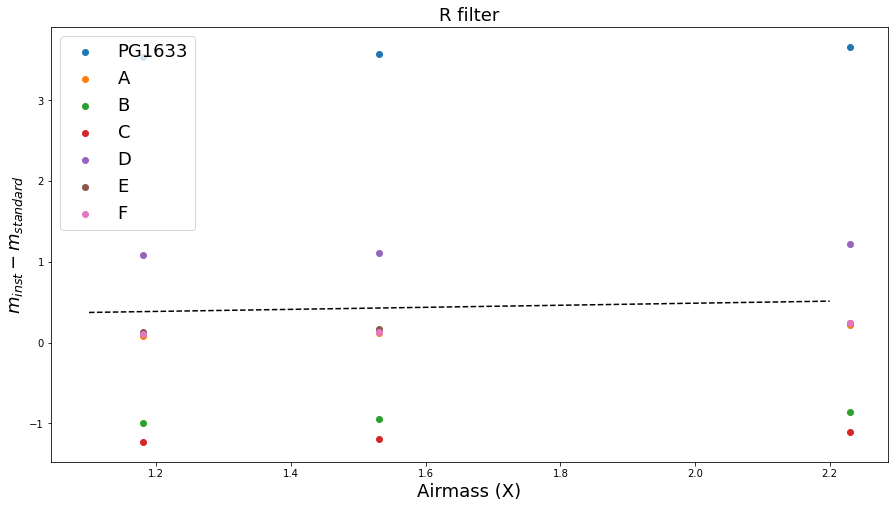

In [802]:
labels=['PG1633','A','B','C','D','E','F']

for i in range(7):
    diff_arry=R_inst_mags[:,i]-R_standard_mags[i]
    plt.scatter(R_airmasses,diff_arry,label=labels[i])
    
index=np.asarray([1.1,1.6,2.2])
plt.plot(index,extinct_coeff_R*index+intercept_R,c='k',ls='--')
plt.xlabel('Airmass (X)',fontsize=18)
plt.ylabel('$m_{inst}-m_{standard}$',fontsize=18)
plt.title('R filter',fontsize=18)
plt.legend(loc='upper left',fontsize=18)

7. After extinction correcting your standard stars to zero airmasses (i.e., you’re correcting to the top of the atmosphere), make a plot of the difference between real magnitudes and instrumental magnitudes using your standard stars as a function of V−R color and B−V color. Fit a linear relation to this trend. The fit gives you your instrumental zero points and the first order color term which let you transform your instrumental photometry to the standard system. Tabulate the instrumental zero point and first order color terms for each band in a neat, digestible way.

In [808]:
# first make a more standardized array for storing all of this stuff

instrument_mags=np.zeros(shape=(4,3,7)) # num filters x num images per filter x num standard stars
instrument_mags[0,:,:]=U_inst_mags
instrument_mags[1,:,:]=B_inst_mags
instrument_mags[2,:,:]=V_inst_mags
instrument_mags[3,:,:]=R_inst_mags

standard_mags=np.zeros(shape=(4,7)) # num filters x num standard stars
standard_mags[0,:]=U_standard_mags
standard_mags[1,:]=B_standard_mags
standard_mags[2,:]=V_standard_mags
standard_mags[3,:]=R_standard_mags

airmasses=np.zeros(shape=(4,3,7)) # num filters x num images per filter x num standard stars
airmasses[0,0,:]=np.repeat(U_airmasses[0],7)
airmasses[0,1,:]=np.repeat(U_airmasses[1],7)
airmasses[0,2,:]=np.repeat(U_airmasses[2],7)
airmasses[1,0,:]=np.repeat(B_airmasses[0],7)
airmasses[1,1,:]=np.repeat(B_airmasses[1],7)
airmasses[1,2,:]=np.repeat(B_airmasses[2],7)
airmasses[2,0,:]=np.repeat(V_airmasses[0],7)
airmasses[2,1,:]=np.repeat(V_airmasses[1],7)
airmasses[2,2,:]=np.repeat(V_airmasses[2],7)
airmasses[3,0,:]=np.repeat(R_airmasses[0],7)
airmasses[3,1,:]=np.repeat(R_airmasses[1],7)
airmasses[3,2,:]=np.repeat(R_airmasses[2],7)

extinct_coeffs=np.zeros(4)
extinct_coeffs[0]=extinct_coeff_U
extinct_coeffs[1]=extinct_coeff_B
extinct_coeffs[2]=extinct_coeff_V
extinct_coeffs[3]=extinct_coeff_R
print(extinct_coeffs)

[0.41085712 0.231898   0.15390366 0.12706548]


In [807]:
# Extinction correct standards to zero airmass

# m_inst_0X=m_inst-(extinction_coeff*airmass)
instrument_mags_0X=np.zeros(shape=(4,3,7))

for i in range(4):
    for j in range(3):
        for k in range(7):
            instrument_mags_0X[i,j,k]=instrument_mags[i,j,k]-(extinct_coeffs[i]*airmasses[i,j,k])

In [813]:
# make a list of all differences as well as V-R and B-V values

inst_stand_diffs=[]
vr_vals=[]
bv_vals=[]

for i in range(4):
    for j in range(3):
        for k in range(7):
            
            inst_stand_diffs.append(instrument_mags_0X[i,j,k]-standard_mags[i,k])
            #vr_vals.append(instrument_mags_0X[2,j,k]-instrument_mags_0X[3,j,k])
            #bv_vals.append(instrument_mags_0X[1,j,k]-instrument_mags_0X[2,j,k])
            vr_vals.append(standard_mags[2,k]-standard_mags[3,k])
            bv_vals.append(standard_mags[1,k]-standard_mags[2,k])
            

Text(0, 0.5, '$m_{inst,0X}-m_{standard}$')

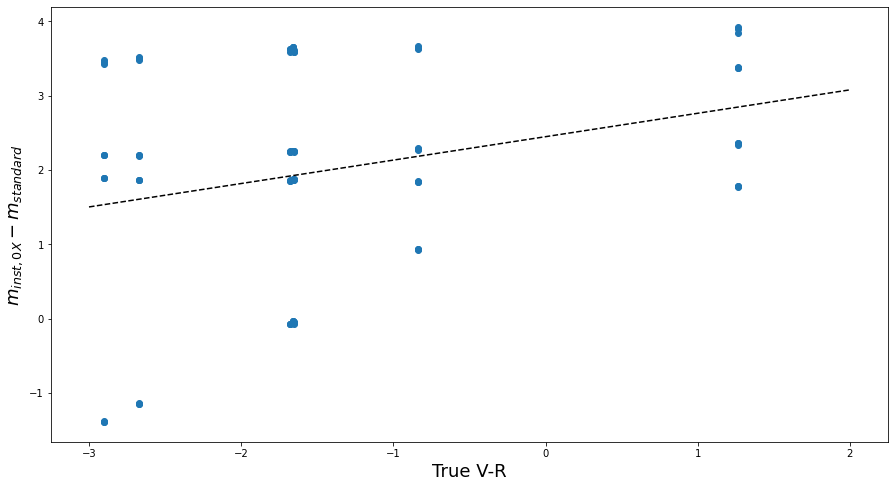

In [821]:
m,b=np.polyfit(vr_vals,inst_stand_diffs,deg=1)

plt.scatter(vr_vals,inst_stand_diffs)
index=np.asarray([-3,2])
plt.plot(index,m*index+b,ls='--',c='k')
plt.xlabel('True V-R',fontsize=18)
plt.ylabel('$m_{inst,0X}-m_{standard}$',fontsize=18)

Text(0, 0.5, '$m_{inst,0X}-m_{standard}$')

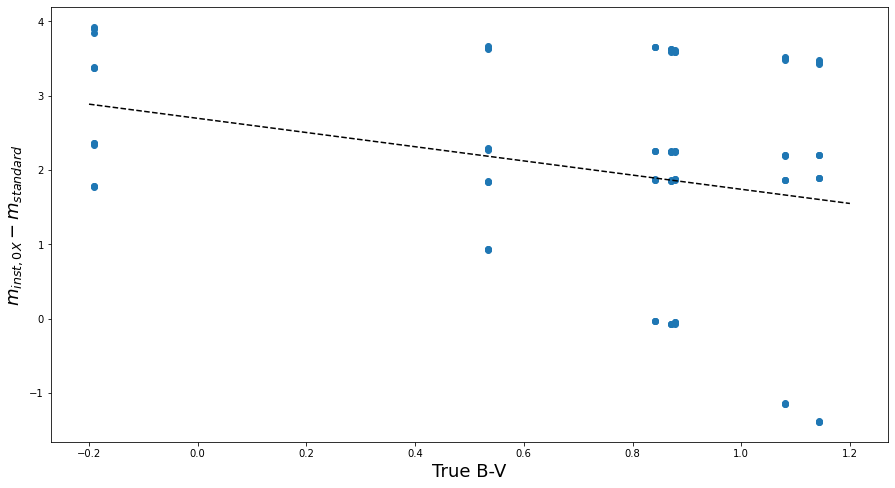

In [907]:
c_1v,c_0v=np.polyfit(bv_vals,inst_stand_diffs,deg=1)

plt.scatter(bv_vals,inst_stand_diffs)
index=np.asarray([-0.2,1.2])
plt.plot(index,c_1v*index+c_0v,ls='--',c='k')
plt.xlabel('True B-V',fontsize=18)
plt.ylabel('$m_{inst,0X}-m_{standard}$',fontsize=18)

8. Using the extinction terms and color terms derived for the imaging dataset previously, do photometry on the stars in NGC6823 and make a color magnitude diagram of this open cluster and compare it to a published one. Either V vs. B−V or R vs. R−I are the most common ones you might find, but there may be others. Assess in a paragraph semi-quantitatively how well does your data agree with published data? Note that your data may be affected by interstellar extinction, so you may need to deredden your data to better match the published CMD, if the published CMD has been corrected already. Use a paper such as Cardelli, Clayton, & Mathis (1989) to do the dereddening.

In [825]:
NGC6823_names=[data_dir+'a158.fits'] # V band, 6s exposure, X=1.10
NGC6823_names.append(data_dir+'a160.fits') # B band, 12s exposure, X=1.09


num_science_images=len(NGC6823_names)
science_images=np.zeros(shape=(num_images,image_rows,image_columns_trim))

for i in range(num_science_images):
    data=fits.open(NGC6823_names[i])[0].data
    data_ot,AIC=overscan_subtraction(data,right_overscan,trimsec,overscan_combine,fit_type,fit_deg)
    science_images[i,:,:]=data_ot

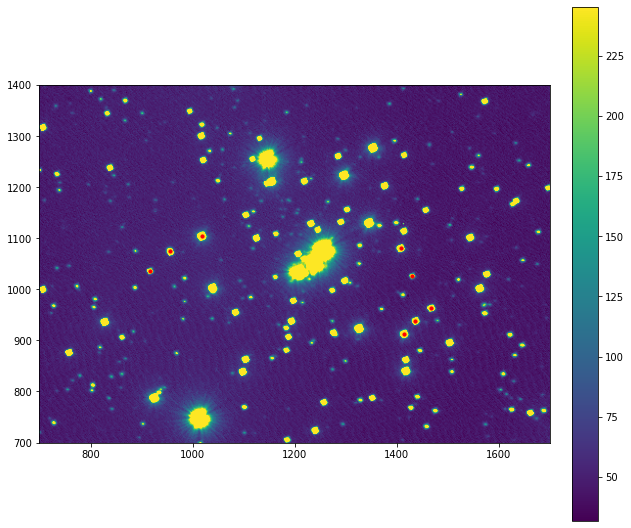

In [902]:
image=science_images[0,:,:] # this is V band, 6 s exposure, X=1.10

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(917,1037,c='r',s=10) 
plt.scatter(955,1075,c='r',s=10) 
plt.scatter(1018,1105,c='r',s=10) 
plt.scatter(1414,913,c='r',s=10) 
plt.scatter(1436,938,c='r',s=10)
plt.scatter(1466,963,c='r',s=10)
plt.scatter(1430,1026,c='r',s=10)
plt.scatter(1408,1081,c='r',s=10)

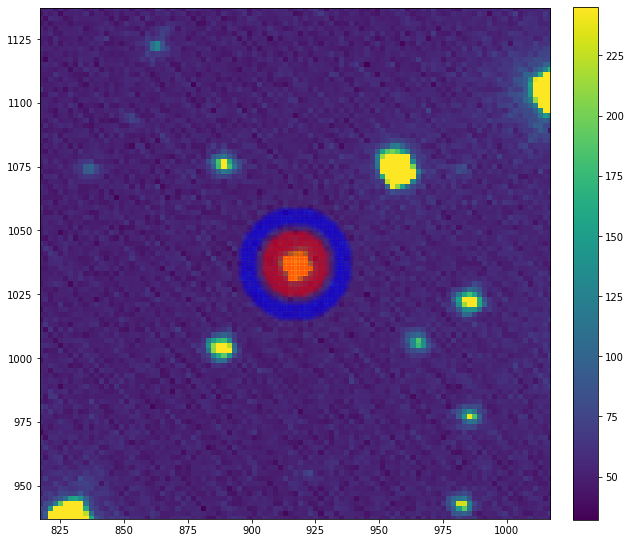

Annulus mean counts: 53.22
Aperture mean counts: 164.99
Source Rate: 24078.13 photons s^-1
Source Rate: 1.705e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 6.217e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 16.92


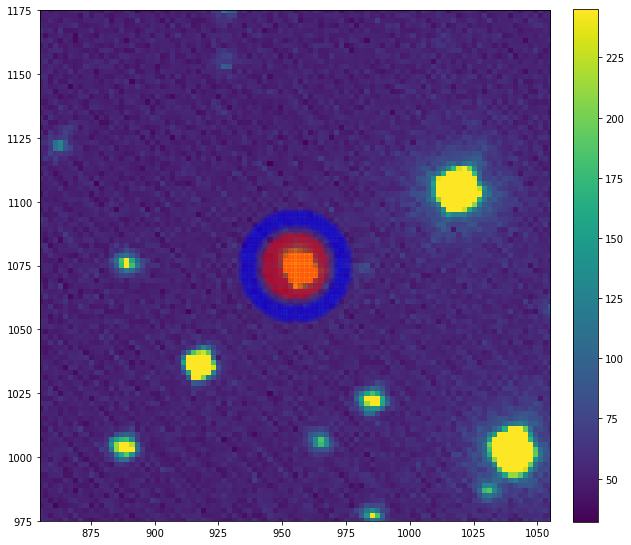

Annulus mean counts: 56.23
Aperture mean counts: 346.56
Source Rate: 62542.08 photons s^-1
Source Rate: 4.427e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 1.615e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.88


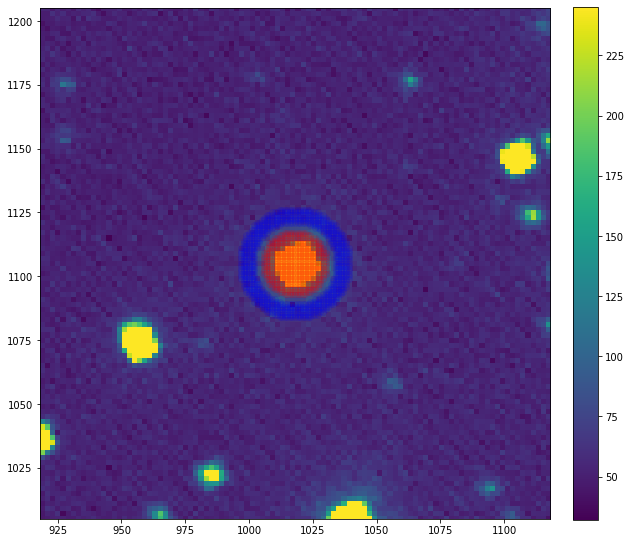

Annulus mean counts: 68.73
Aperture mean counts: 1586.64
Source Rate: 326983.10 photons s^-1
Source Rate: 2.315e-03 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 8.443e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 14.08


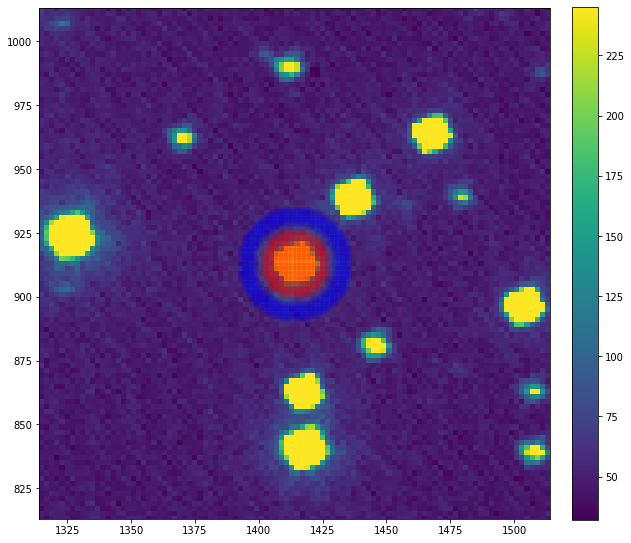

Annulus mean counts: 58.55
Aperture mean counts: 939.88
Source Rate: 189854.17 photons s^-1
Source Rate: 1.344e-03 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 4.902e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 14.67


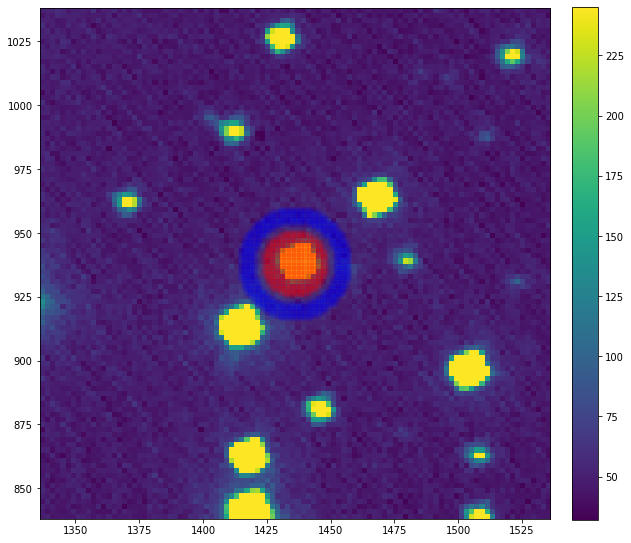

Annulus mean counts: 56.16
Aperture mean counts: 526.05
Source Rate: 101221.31 photons s^-1
Source Rate: 7.166e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.614e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.36


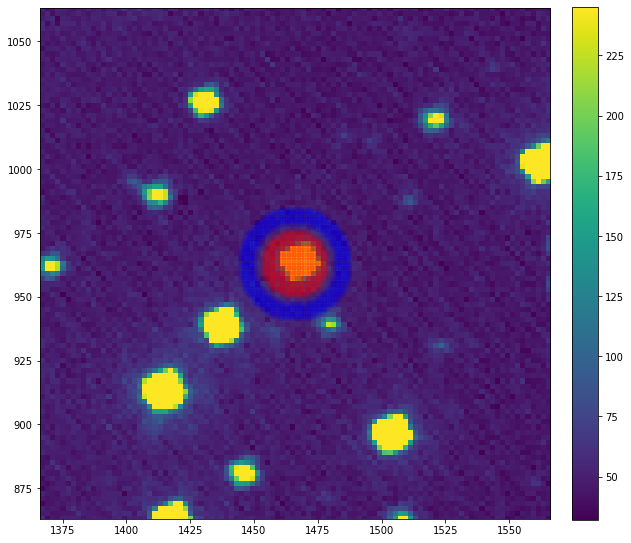

Annulus mean counts: 51.09
Aperture mean counts: 424.81
Source Rate: 80505.60 photons s^-1
Source Rate: 5.699e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.079e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.61


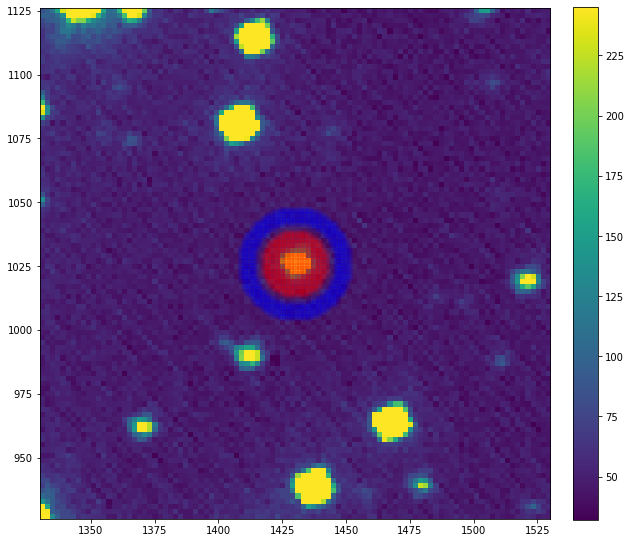

Annulus mean counts: 46.95
Aperture mean counts: 115.16
Source Rate: 14693.98 photons s^-1
Source Rate: 1.040e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 3.794e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 17.45


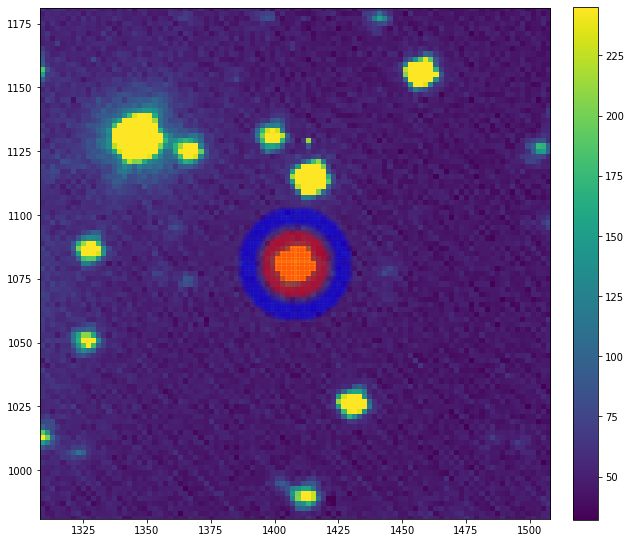

Annulus mean counts: 53.96
Aperture mean counts: 553.16
Source Rate: 107535.65 photons s^-1
Source Rate: 7.613e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 3.647e-12 ergs photon^-1
Source Rate: 2.777e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.29


In [906]:
centers=[[1037,917],[1075,955],[1105,1018],[913,1414],[938,1436],[963,1466],[1026,1430],[1081,1408]]

image=science_images[0,:,:]
t=6 #seconds
#info for V bandpass
bandwidth=850 #angstroms
WL_eff=5450 #angstroms
flux_zeropoint=363.1e-11 # erg s^-1 cm^-2 A^-1

science_airmasses=[]
science_airmasses.append(1.10)

science_inst_mags=np.zeros(shape=(num_science_images,len(centers)))

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint,
                                   aperture_size=4,
                                   inner_annulus=5,
                                   outer_annulus=7)
    print('Instrumental Mag: {:.2f}'.format(mag))
    science_inst_mags[0,i]=mag


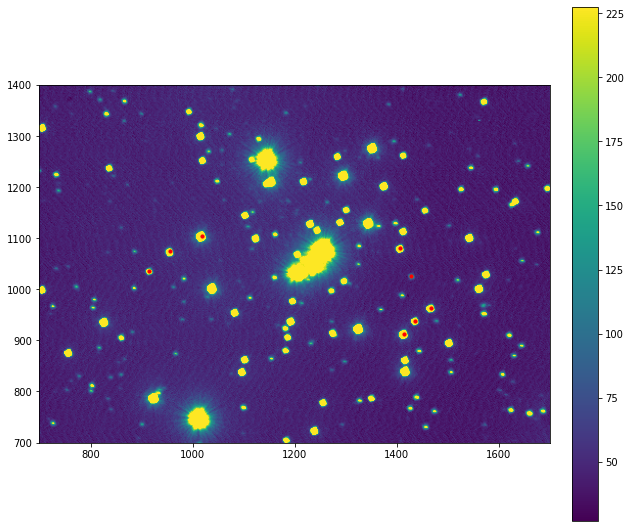

In [919]:
image=science_images[1,:,:] # this is B band, 12 s exposure, X=1.09

# find centroids of standard stars
show_image(image)

plt.axis([700,1700,700,1400])
plt.scatter(914,1037,c='r',s=10) 
plt.scatter(955,1075,c='r',s=10) 
plt.scatter(1018,1105,c='r',s=10) 
plt.scatter(1414,913,c='r',s=10) 
plt.scatter(1436,938,c='r',s=10)
plt.scatter(1466,963,c='r',s=10)
plt.scatter(1428,1026,c='r',s=10)
plt.scatter(1406,1081,c='r',s=10)

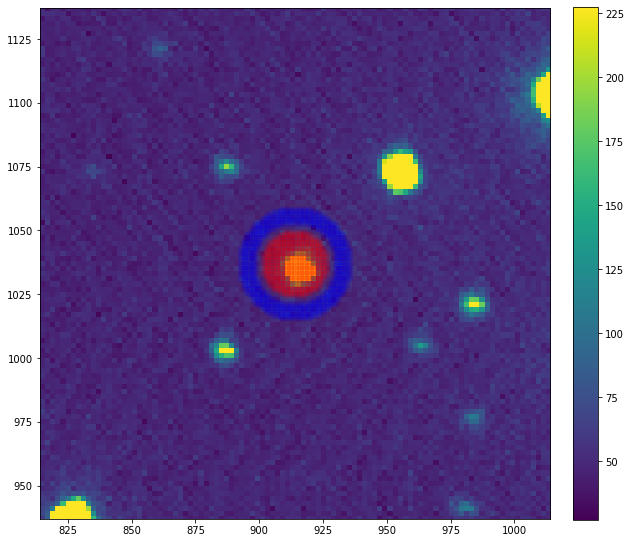

Annulus mean counts: 49.46
Aperture mean counts: 140.18
Source Rate: 9772.01 photons s^-1
Source Rate: 6.533e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 2.965e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 18.32


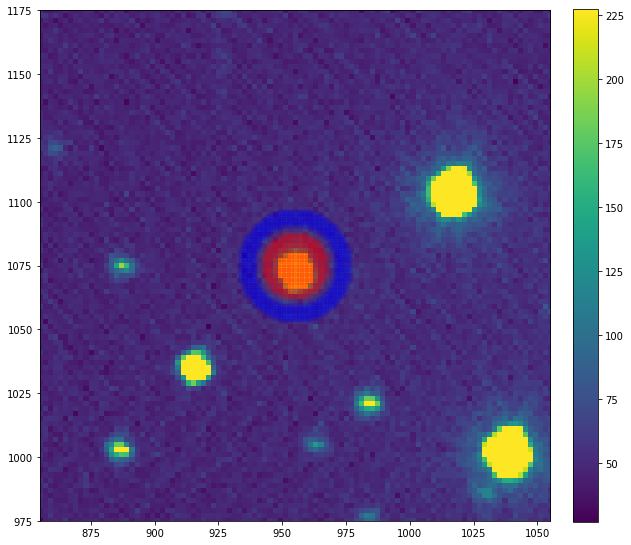

Annulus mean counts: 53.67
Aperture mean counts: 340.85
Source Rate: 30931.74 photons s^-1
Source Rate: 2.068e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 9.385e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 17.07


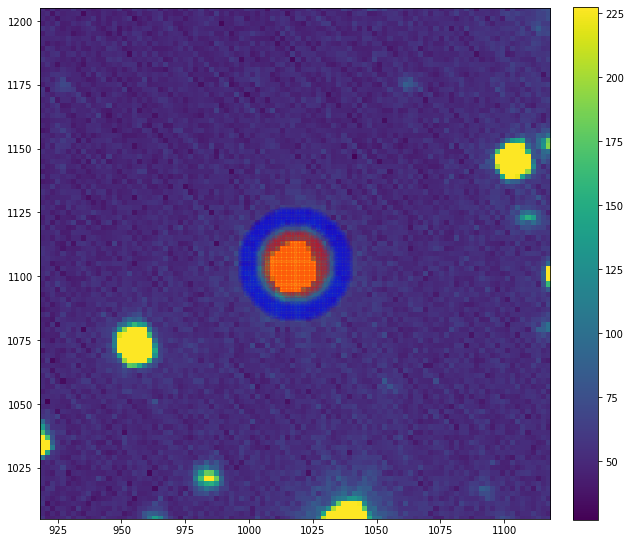

Annulus mean counts: 69.31
Aperture mean counts: 1738.58
Source Rate: 179795.04 photons s^-1
Source Rate: 1.202e-03 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 5.455e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.16


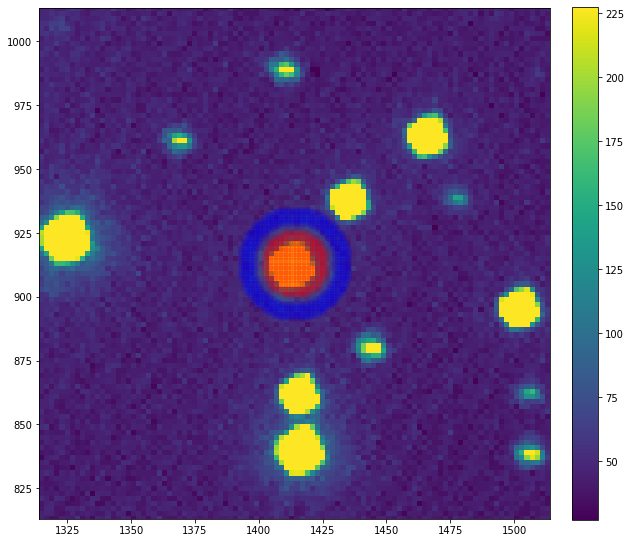

Annulus mean counts: 53.55
Aperture mean counts: 853.59
Source Rate: 86171.11 photons s^-1
Source Rate: 5.761e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 2.615e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 15.96


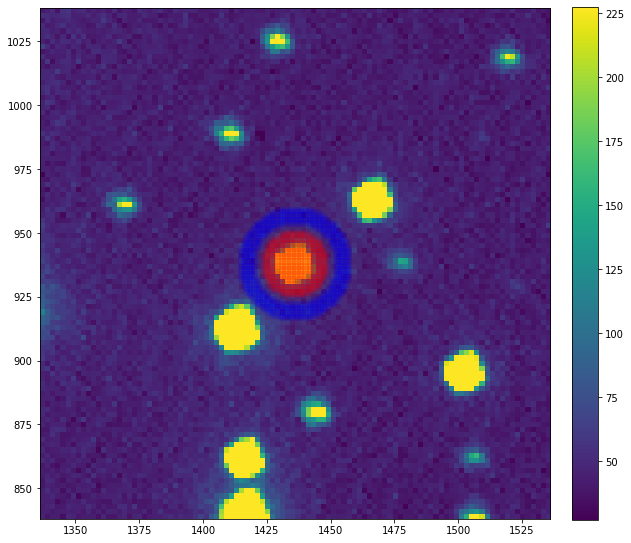

Annulus mean counts: 49.40
Aperture mean counts: 284.35
Source Rate: 25306.91 photons s^-1
Source Rate: 1.692e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 7.679e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 17.29


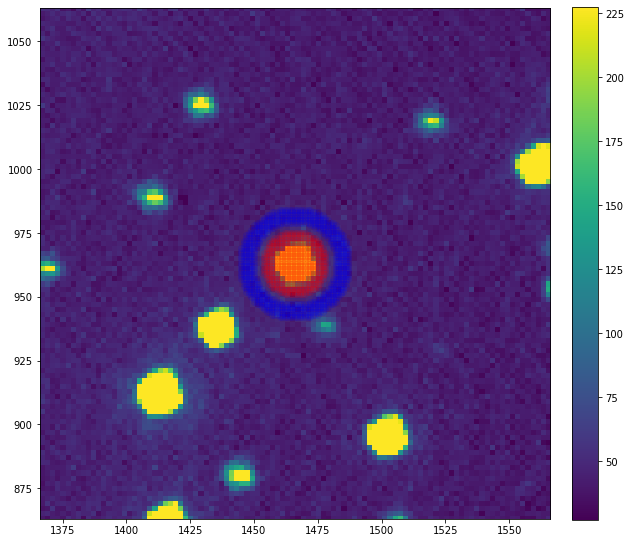

Annulus mean counts: 47.30
Aperture mean counts: 405.49
Source Rate: 38579.19 photons s^-1
Source Rate: 2.579e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 1.171e-15 erg s^-1 cm^-2 A^-1
Instrumental Mag: 16.83


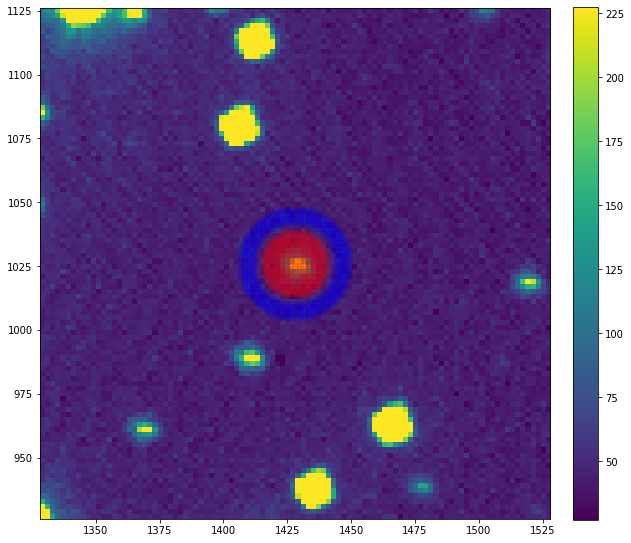

Annulus mean counts: 42.82
Aperture mean counts: 68.53
Source Rate: 2769.88 photons s^-1
Source Rate: 1.852e-05 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 8.404e-17 erg s^-1 cm^-2 A^-1
Instrumental Mag: 19.69


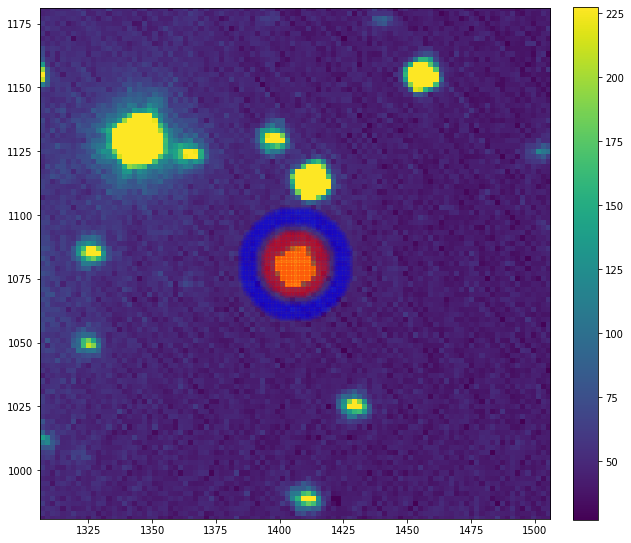

Annulus mean counts: 48.43
Aperture mean counts: 330.60
Source Rate: 30391.55 photons s^-1
Source Rate: 2.032e-04 photons s^-1 cm^-2 A^-1
Effective Energy: 4.538e-12 ergs photon^-1
Source Rate: 9.222e-16 erg s^-1 cm^-2 A^-1
Instrumental Mag: 17.09


In [920]:
centers=[[1037,914],[1075,955],[1105,1018],[913,1414],[938,1436],[963,1466],[1026,1428],[1081,1406]]

image=science_images[1,:,:]
t=12 #seconds
#info for B bandpass
bandwidth=900 #angstroms
WL_eff=4380 #angstroms
flux_zeropoint=632e-11 # erg s^-1 cm^-2 A^-1

science_airmasses.append(1.09)

for i in range(len(centers)):
    mag=get_instrumental_magnitude(image=image,
                                   center=centers[i],
                                   t=t,
                                   bandwidth=bandwidth,
                                   WL_eff=WL_eff,
                                   flux_zeropoint=flux_zeropoint,
                                   aperture_size=4,
                                   inner_annulus=5,
                                   outer_annulus=7)
    print('Instrumental Mag: {:.2f}'.format(mag))
    science_inst_mags[1,i]=mag

In [921]:
# Convert instrumental photometry to the standard system
# v=v_0+c_0,v+c_1,v(b0-v0)

science_standard_mags=np.zeros(shape=(num_science_images,len(centers)))

for i in range(len(centers)):
    # 0 index is V band, 1 is B band
    science_standard_mags[0,i]=science_inst_mags[0,i]+c_0v+c_1v*(science_inst_mags[1,i]-science_inst_mags[0,i])
    science_standard_mags[1,i]=science_inst_mags[1,i]+c_0v+c_1v*(science_inst_mags[1,i]-science_inst_mags[0,i])



In [941]:
sfdpath='/Users/dabbiecm/Dropbox/OU/Research/felonet/files/sfddata-master'
m=sfdmap.SFDMap(sfdpath,scaling=1)

#19h 43m
#+23° 18'
ra, dec = '19h43m00s', '+23d18m00s'
c = SkyCoord(ra, dec).galactic

ebv = m.ebv(c.l.value,c.b.value, frame='galactic')
print(ebv)

9.722496204197776


Text(0, 0.5, 'V')

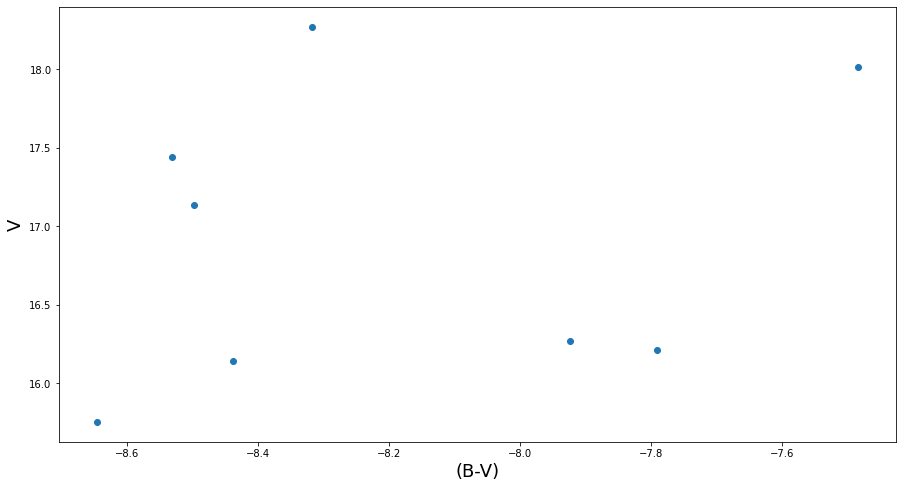

In [943]:
V_science_mags=science_standard_mags[0,:]
BV_science_mags=science_standard_mags[1,:]-science_standard_mags[0,:]
#E(B-V)=(B-V)_obs - (B-V)_intrinsic
BV_science_mags_corr=BV_science_mags-ebv

#plt.axis([1,2.5,19,15])
plt.scatter(BV_science_mags_corr,V_science_mags)
plt.xlabel('(B-V)',fontsize=18)
plt.ylabel('V',fontsize=18)

# These values are way too blue, but that is coming from the crazy high E(B-V) from sfdmap